In [64]:
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import numpy as np
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
from scipy.optimize import minimize
# %matplotlib inline

In [2]:
# dtype={
#     'probe_sn':str,
#     'major':int,
#     'minor':int,
#     'rssi':int,
#     'g_sensor_x':int,
#     'g_sensor_y':int,
#     'g_sensor_z':int,
#     'probe_time':datetime,
#     'receive_time':datetime,
#     'g_sensor':float,
#        }  
data = pd.read_excel("data.xlsx")
data.head()

,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time
0,100008,2001,11,-84,5,-8,105,2020-09-25 19:07:23,2020-09-25 19:07:24
1,100008,2001,13,-80,3,82,-15,2020-09-25 19:07:23,2020-09-25 19:07:24
2,100008,2001,10,-91,-43,-105,0,2020-09-25 19:07:23,2020-09-25 19:07:24
3,100008,2001,3,-90,3,91,-11,2020-09-25 19:07:23,2020-09-25 19:07:24
4,100008,2001,9,-78,6,-5,-103,2020-09-25 19:07:23,2020-09-25 19:07:24


In [3]:
data.shape

(35663, 9)

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35663 entries, 0 to 35662
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   probe_sn      35663 non-null  int64         
 1   major         35663 non-null  int64         
 2   minor         35663 non-null  int64         
 3   rssi          35663 non-null  int64         
 4   g_sensor_x    35663 non-null  int64         
 5   g_sensor_y    35663 non-null  int64         
 6   g_sensor_z    35663 non-null  int64         
 7   probe_time    35663 non-null  datetime64[ns]
 8   receive_time  35663 non-null  datetime64[ns]
dtypes: datetime64[ns](2), int64(7)
memory usage: 2.4 MB


In [5]:
data[(data['probe_time'].dt.hour == 6) & (data['probe_time'].dt.day == 26)]

,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time
26546,100022,2001,12,-73,10,96,0,2020-09-26 06:16:47,2020-09-26 06:16:51
26547,100022,2001,11,-79,12,89,0,2020-09-26 06:16:48,2020-09-26 06:16:51
26548,100022,2001,12,-55,16,96,0,2020-09-26 06:16:48,2020-09-26 06:16:52
26549,100022,2001,6,-74,-5,91,2,2020-09-26 06:16:48,2020-09-26 06:16:52
26550,100022,2001,11,-64,14,91,0,2020-09-26 06:16:49,2020-09-26 06:16:52
...,...,...,...,...,...,...,...,...,...
29478,100008,2001,2,-86,6,91,0,2020-09-26 06:38:38,2020-09-26 06:38:39
29479,100008,2001,1,-79,4,90,2,2020-09-26 06:38:38,2020-09-26 06:38:39
29480,100008,2001,7,-85,4,89,-1,2020-09-26 06:38:39,2020-09-26 06:38:40
29481,100008,2001,1,-75,5,93,3,2020-09-26 06:38:39,2020-09-26 06:38:40


In [6]:
data['g_sensor'] = np.sqrt(data['g_sensor_x'] ** 2 + data['g_sensor_y'] ** 2 + data['g_sensor_z'] ** 2)

In [7]:
data['g_sensor_xz'] = np.sqrt(data['g_sensor_x'] ** 2 + data['g_sensor_z'] ** 2)

In [8]:
data1 = data[data['probe_time'].dt.day == 26]

In [9]:
data1['probe_sn'].unique()

array([100022, 100009, 100012, 100011, 100014, 100019, 100016, 100008],
      dtype=int64)

In [10]:
data1['probe_sn'].value_counts()

100009    1446
100012    1313
100011    1171
100019    1143
100022    1109
100016    1044
100014     955
100008     936
Name: probe_sn, dtype: int64

In [11]:
data1[data1['probe_time'].dt.hour == 6]

,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time,g_sensor,g_sensor_xz
26546,100022,2001,12,-73,10,96,0,2020-09-26 06:16:47,2020-09-26 06:16:51,96.519428,10.000000
26547,100022,2001,11,-79,12,89,0,2020-09-26 06:16:48,2020-09-26 06:16:51,89.805345,12.000000
26548,100022,2001,12,-55,16,96,0,2020-09-26 06:16:48,2020-09-26 06:16:52,97.324200,16.000000
26549,100022,2001,6,-74,-5,91,2,2020-09-26 06:16:48,2020-09-26 06:16:52,91.159201,5.385165
26550,100022,2001,11,-64,14,91,0,2020-09-26 06:16:49,2020-09-26 06:16:52,92.070625,14.000000
...,...,...,...,...,...,...,...,...,...,...,...
29478,100008,2001,2,-86,6,91,0,2020-09-26 06:38:38,2020-09-26 06:38:39,91.197588,6.000000
29479,100008,2001,1,-79,4,90,2,2020-09-26 06:38:38,2020-09-26 06:38:39,90.111043,4.472136
29480,100008,2001,7,-85,4,89,-1,2020-09-26 06:38:39,2020-09-26 06:38:40,89.095454,4.123106
29481,100008,2001,1,-75,5,93,3,2020-09-26 06:38:39,2020-09-26 06:38:40,93.182616,5.830952


In [12]:
data1.head()

,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time,g_sensor,g_sensor_xz
26546,100022,2001,12,-73,10,96,0,2020-09-26 06:16:47,2020-09-26 06:16:51,96.519428,10.000000
26547,100022,2001,11,-79,12,89,0,2020-09-26 06:16:48,2020-09-26 06:16:51,89.805345,12.000000
26548,100022,2001,12,-55,16,96,0,2020-09-26 06:16:48,2020-09-26 06:16:52,97.324200,16.000000
26549,100022,2001,6,-74,-5,91,2,2020-09-26 06:16:48,2020-09-26 06:16:52,91.159201,5.385165
26550,100022,2001,11,-64,14,91,0,2020-09-26 06:16:49,2020-09-26 06:16:52,92.070625,14.000000


In [13]:
data1.shape

(9117, 11)

In [14]:
data1['probe_time'].dt.hour.unique()

array([ 6,  8,  9, 11, 12, 13], dtype=int64)

In [15]:
data1[data1['probe_time'].dt.day == 26]

,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time,g_sensor,g_sensor_xz
26546,100022,2001,12,-73,10,96,0,2020-09-26 06:16:47,2020-09-26 06:16:51,96.519428,10.000000
26547,100022,2001,11,-79,12,89,0,2020-09-26 06:16:48,2020-09-26 06:16:51,89.805345,12.000000
26548,100022,2001,12,-55,16,96,0,2020-09-26 06:16:48,2020-09-26 06:16:52,97.324200,16.000000
26549,100022,2001,6,-74,-5,91,2,2020-09-26 06:16:48,2020-09-26 06:16:52,91.159201,5.385165
26550,100022,2001,11,-64,14,91,0,2020-09-26 06:16:49,2020-09-26 06:16:52,92.070625,14.000000
...,...,...,...,...,...,...,...,...,...,...,...
35658,100016,2001,1,-70,14,91,0,2020-09-26 13:31:06,2020-09-26 13:31:27,92.070625,14.000000
35659,100016,2001,1,-68,15,91,1,2020-09-26 13:31:07,2020-09-26 13:31:27,92.233400,15.033296
35660,100016,2001,7,-79,-5,91,-2,2020-09-26 13:31:08,2020-09-26 13:31:27,91.159201,5.385165
35661,100016,2001,1,-79,14,92,1,2020-09-26 13:31:08,2020-09-26 13:31:27,93.064494,14.035669


Text(0.5, 1.0, 'all of the data')

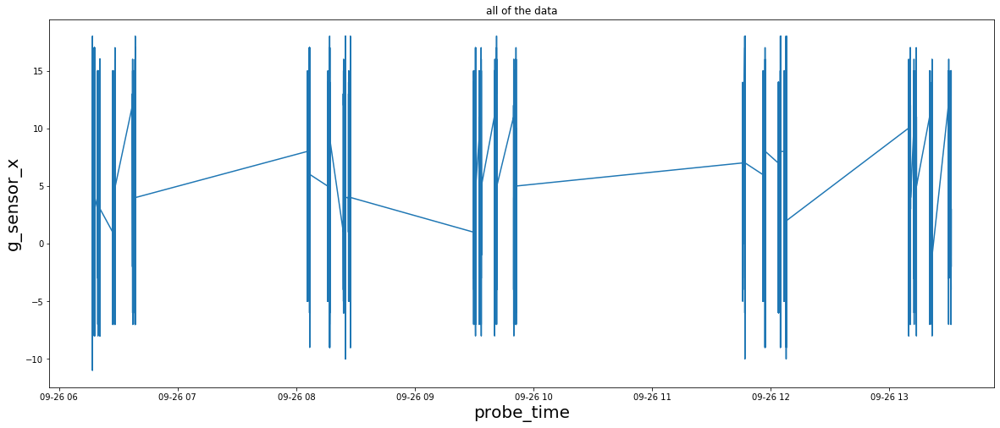

In [16]:
plt.figure(figsize=(20,8))
plt.plot(data1['probe_time'], data1['g_sensor_x'])
plt.xlabel('probe_time', fontsize=20)
plt.ylabel('g_sensor_x', fontsize=20)
plt.title('all of the data')

In [17]:
def showPlot(probe_sn=100009, probe_hour=9, probe_day=26):
    plt.figure(figsize=(20,8))
    probe = data1[(data1['probe_sn'] == probe_sn) & (data1['probe_time'].dt.hour == probe_hour) & 
                  (data1['probe_time'].dt.day == probe_day)]
    plt.plot(probe['probe_time'], probe['g_sensor_x'])
    plt.xlabel('probe_time', fontsize=20)
    plt.ylabel('g_sensor', fontsize=20)
    plt.title('probe_sn: {}  9/{}'.format(probe_sn, probe_day), fontsize=20)
    return probe

def showPlotEveryMinor(probe_sn=100009, minor=12, probe_hour=9, probe_day=26):
    plt.figure(figsize=(20,8))
    probe = data1[(data1['probe_sn'] == probe_sn) & (data1['probe_time'].dt.hour == probe_hour) & 
                  (data1['probe_time'].dt.day == probe_day) & (data1['minor'] == minor)]
    plt.plot(probe['probe_time'], probe['g_sensor_x'])
    plt.xlabel('probe_time', fontsize=20)
    plt.ylabel('g_sensor', fontsize=20)
    plt.title('probe_sn: {}  9/{}  minor {}'.format(probe_sn, probe_day, minor), fontsize=20)
#     return probe

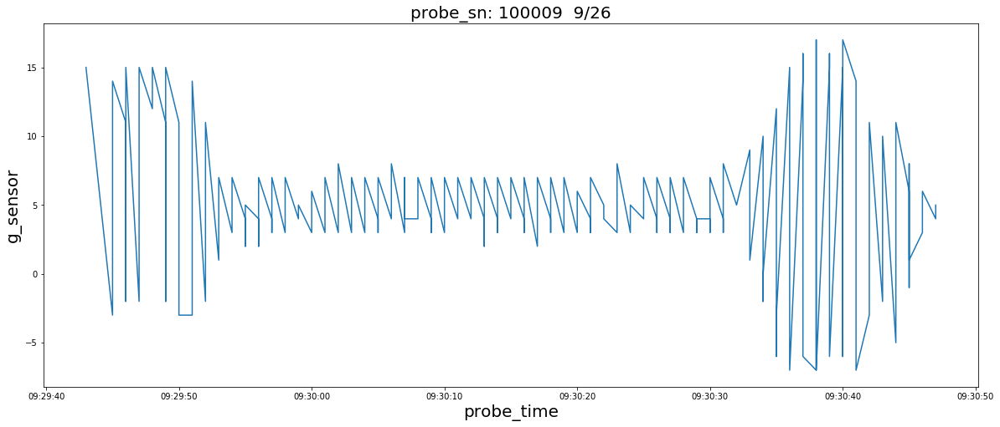

In [18]:
probe = showPlot(100009, 9, 26)

In [19]:
probe.head(200)

,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time,g_sensor,g_sensor_xz
31097,100009,2001,12,-85,15,94,0,2020-09-26 09:29:43,2020-09-26 09:29:45,95.189285,15.000000
31101,100009,2001,6,-76,-3,93,0,2020-09-26 09:29:45,2020-09-26 09:29:46,93.048375,3.000000
31102,100009,2001,12,-74,14,95,0,2020-09-26 09:29:45,2020-09-26 09:29:47,96.026038,14.000000
31104,100009,2001,11,-87,11,89,2,2020-09-26 09:29:46,2020-09-26 09:29:48,89.699498,11.180340
31105,100009,2001,6,-73,-2,93,1,2020-09-26 09:29:46,2020-09-26 09:29:48,93.026878,2.236068
...,...,...,...,...,...,...,...,...,...,...,...
31424,100009,2001,8,-79,-1,94,-1,2020-09-26 09:30:45,2020-09-26 09:30:47,94.010638,1.414214
31425,100009,2001,2,-80,8,93,-2,2020-09-26 09:30:45,2020-09-26 09:30:47,93.364876,8.246211
31426,100009,2001,7,-84,1,91,0,2020-09-26 09:30:45,2020-09-26 09:30:47,91.005494,1.000000
31427,100009,2001,7,-77,3,90,0,2020-09-26 09:30:46,2020-09-26 09:30:48,90.049986,3.000000


Text(0.5, 1.0, 'probe_sn: 100009  9/26')

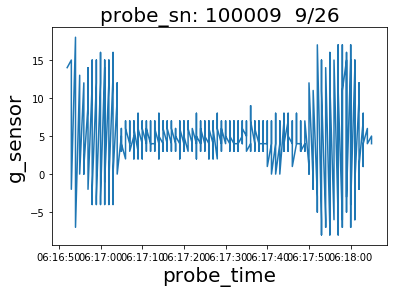

In [20]:
probe = data1[(data1['probe_sn'] == 100009) & (data1['probe_time'].dt.hour == 6) & (data1['probe_time'].dt.day == 26)]
probe.head()
plt.plot(probe['probe_time'], probe['g_sensor_x'])
plt.xlabel('probe_time', fontsize=20)
plt.ylabel('g_sensor', fontsize=20)
plt.title('probe_sn: {}  9/{}'.format(100009, 26), fontsize=20)

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the

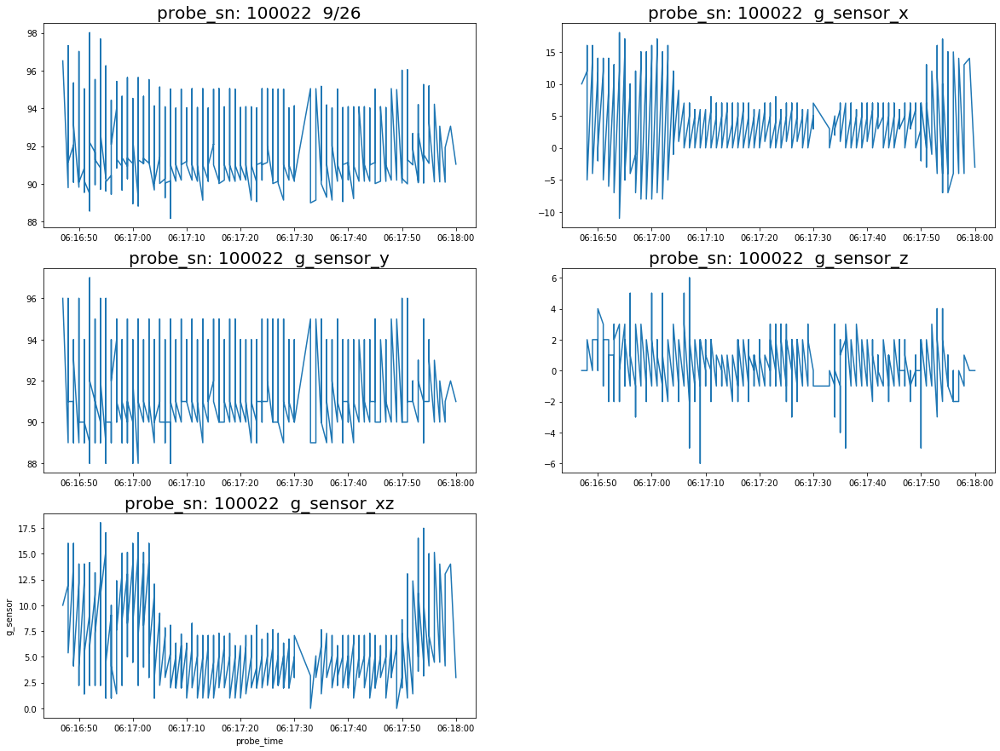

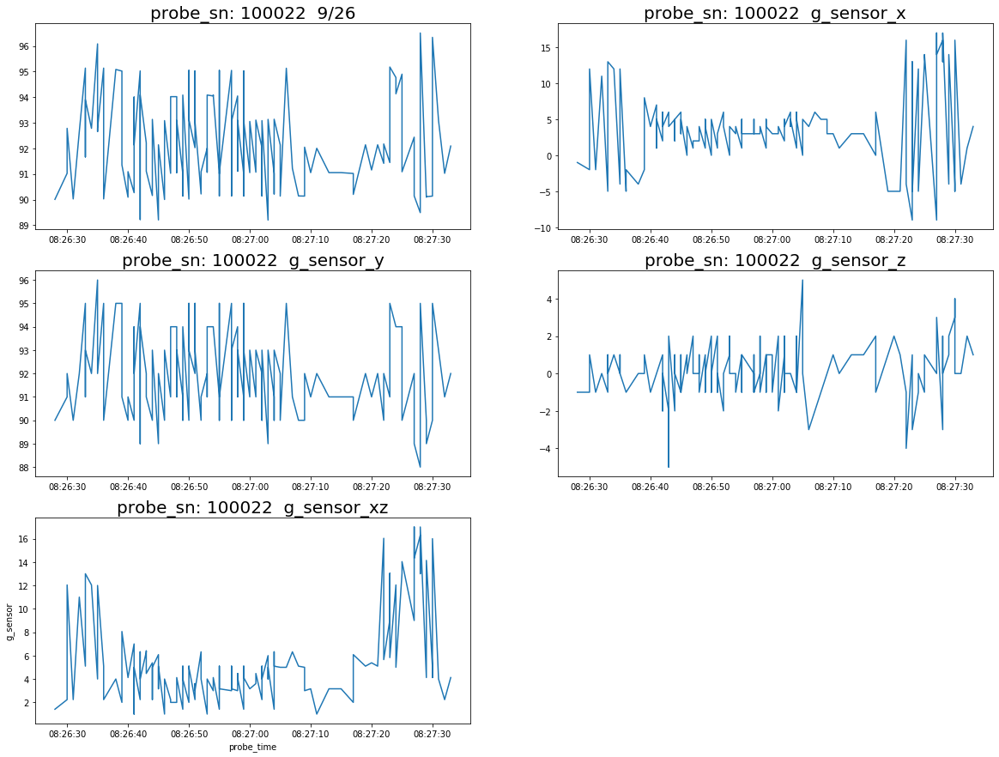

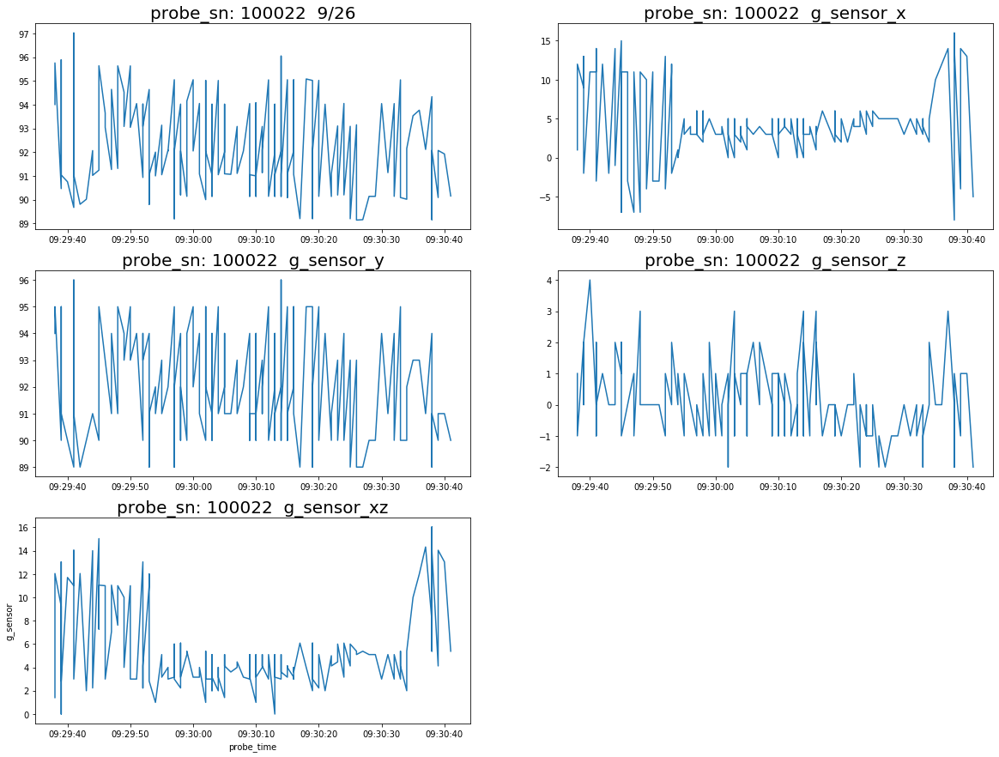

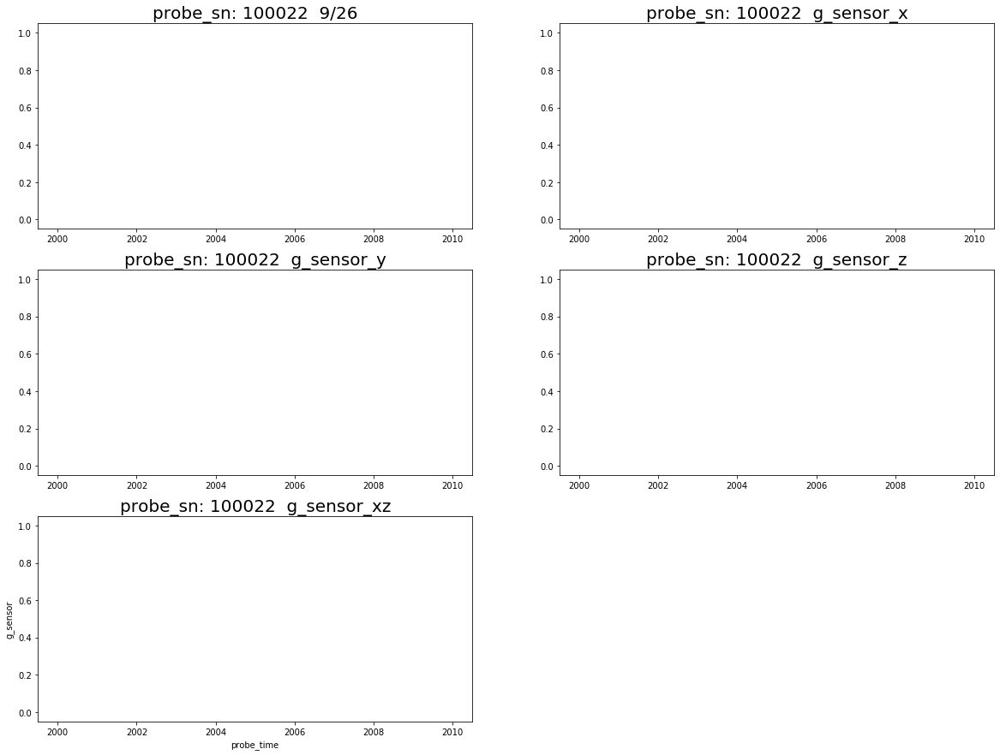

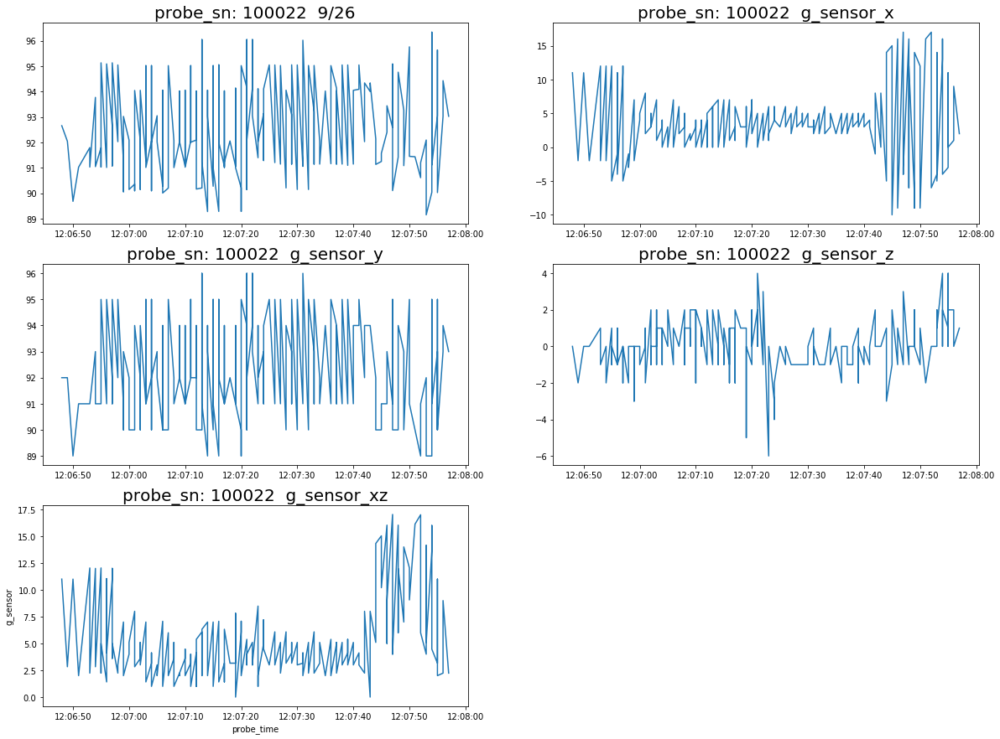

...

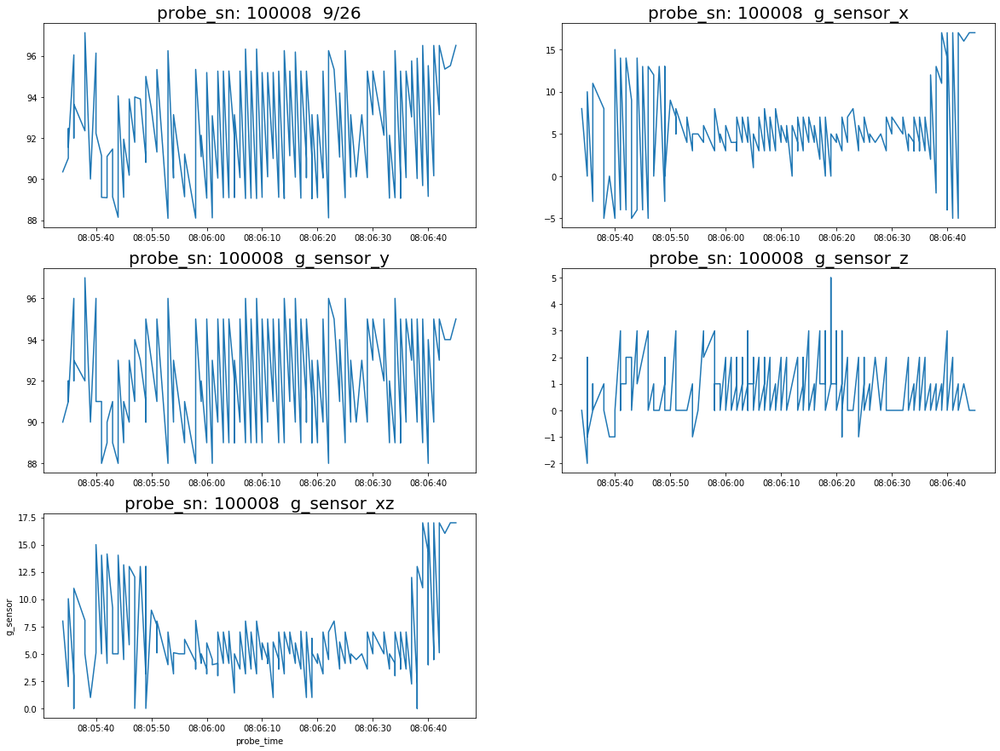

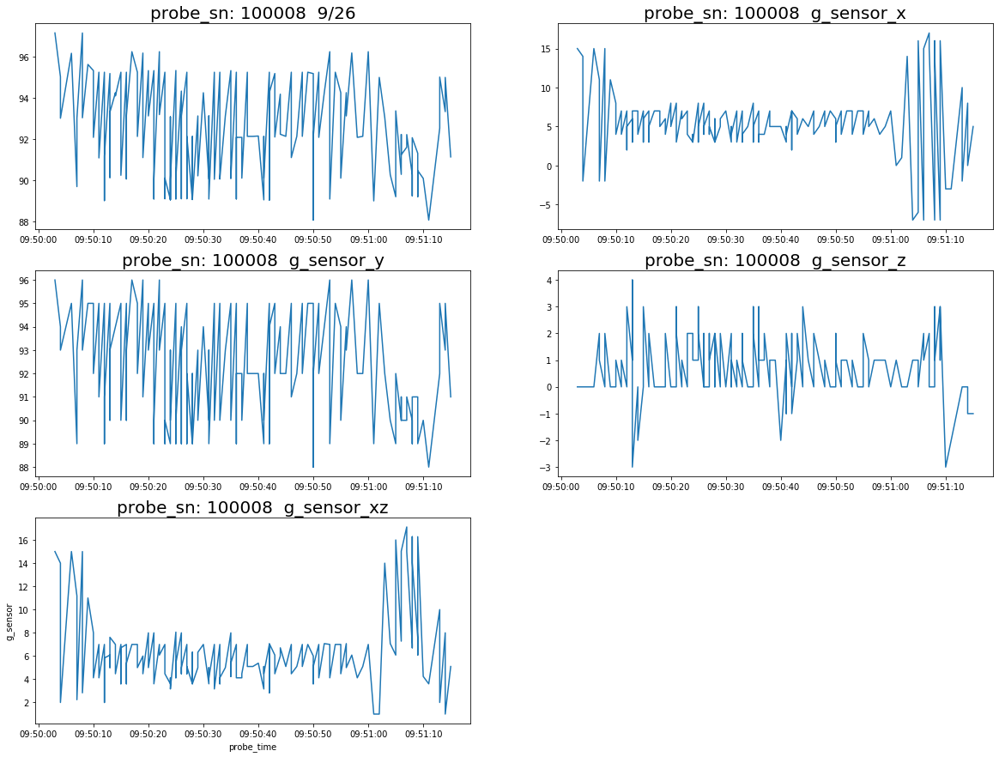

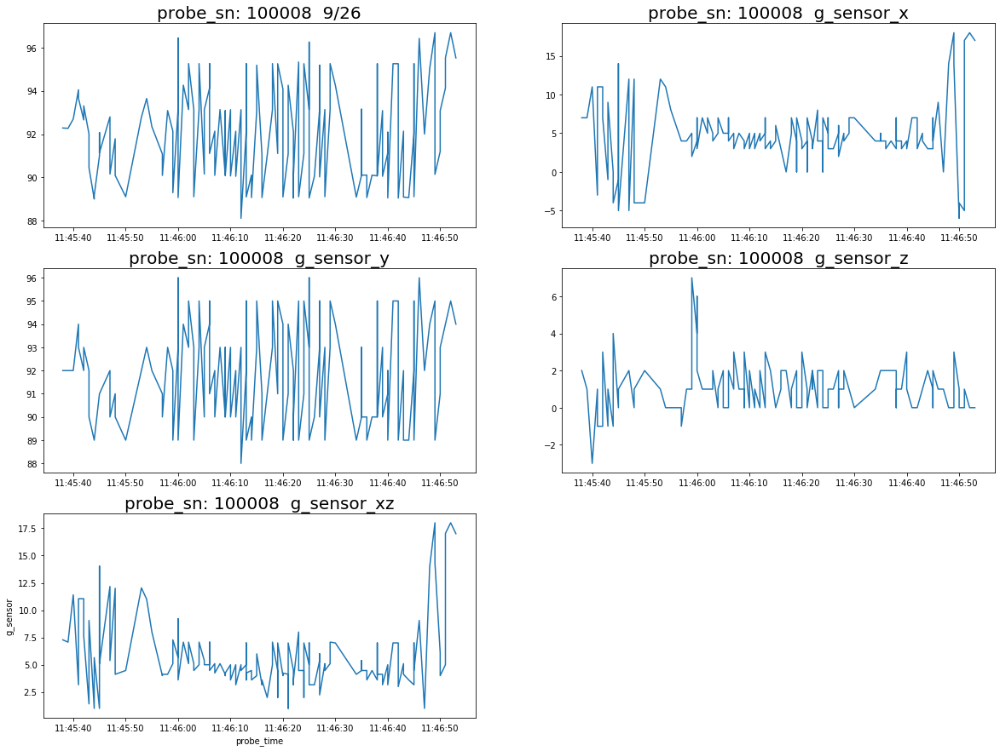

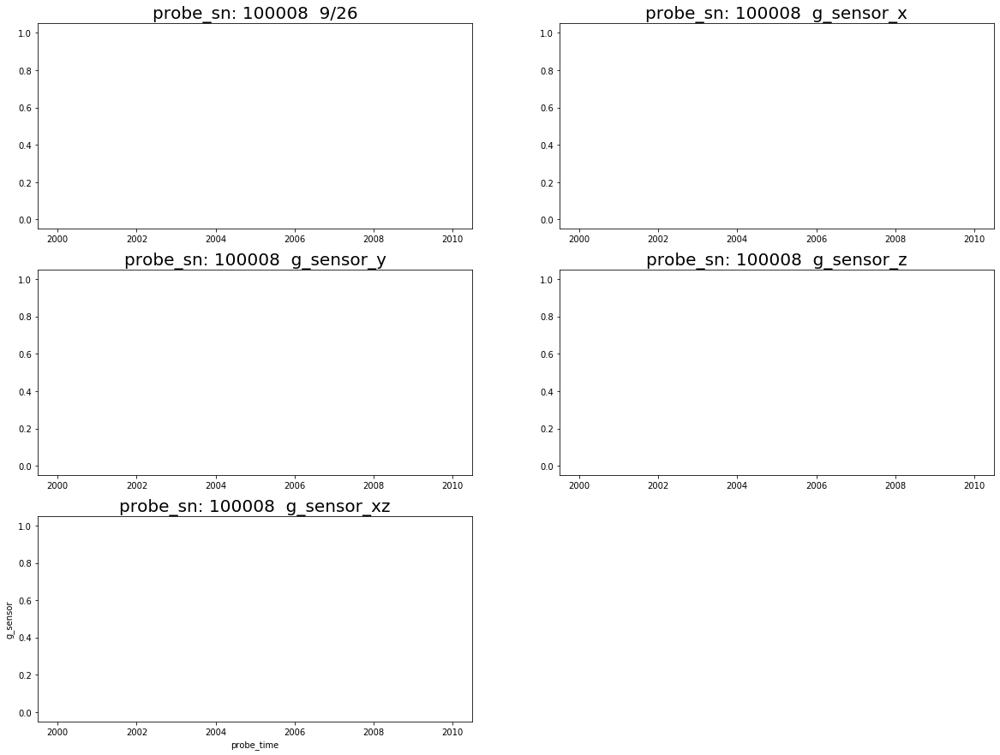

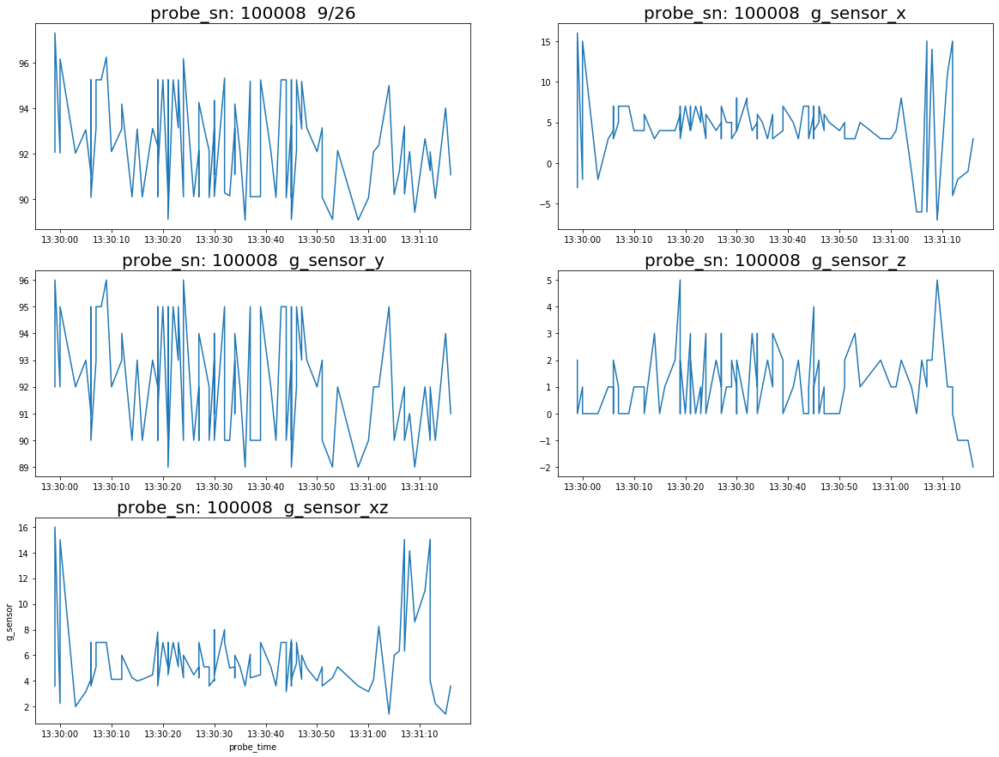

In [21]:
for probe_sn in data1['probe_sn'].unique():
    for probe_hour in data1['probe_time'].dt.hour.unique():
        plt.figure(figsize=(20,15))
        probe = data1[(data1['probe_sn'] == probe_sn) & (data1['probe_time'].dt.hour == probe_hour)]
        plt.subplot(3, 2, 1)
        plt.plot(probe['probe_time'], probe['g_sensor'])
        plt.title('probe_sn: {}  9/26'.format(probe_sn), fontsize=20)
        plt.subplot(3, 2, 2)
        plt.plot(probe['probe_time'], probe['g_sensor_x'])
        plt.title('probe_sn: {}  g_sensor_x'.format(probe_sn), fontsize=20)
        plt.subplot(3, 2, 3)
        plt.plot(probe['probe_time'], probe['g_sensor_y'])
        plt.title('probe_sn: {}  g_sensor_y'.format(probe_sn), fontsize=20)
        plt.subplot(3, 2, 4)
        plt.plot(probe['probe_time'], probe['g_sensor_z'])
        plt.title('probe_sn: {}  g_sensor_z'.format(probe_sn), fontsize=20)
        plt.subplot(3, 2, 5)
        plt.plot(probe['probe_time'], probe['g_sensor_xz'])
        plt.title('probe_sn: {}  g_sensor_xz'.format(probe_sn), fontsize=20)
        plt.xlabel('probe_time')
        plt.ylabel('g_sensor')
        

In [22]:
data1.head()

,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time,g_sensor,g_sensor_xz
26546,100022,2001,12,-73,10,96,0,2020-09-26 06:16:47,2020-09-26 06:16:51,96.519428,10.000000
26547,100022,2001,11,-79,12,89,0,2020-09-26 06:16:48,2020-09-26 06:16:51,89.805345,12.000000
26548,100022,2001,12,-55,16,96,0,2020-09-26 06:16:48,2020-09-26 06:16:52,97.324200,16.000000
26549,100022,2001,6,-74,-5,91,2,2020-09-26 06:16:48,2020-09-26 06:16:52,91.159201,5.385165
26550,100022,2001,11,-64,14,91,0,2020-09-26 06:16:49,2020-09-26 06:16:52,92.070625,14.000000


In [23]:
pd.set_option('max_row',300) 

In [24]:
demo1 = data1[(data1['probe_sn'] == 100009) & (data1['major'] == 2001) & (data1['probe_time'].dt.hour == 6) & 
      (data1['probe_time'].dt.day == 26)]

## 100009 26号

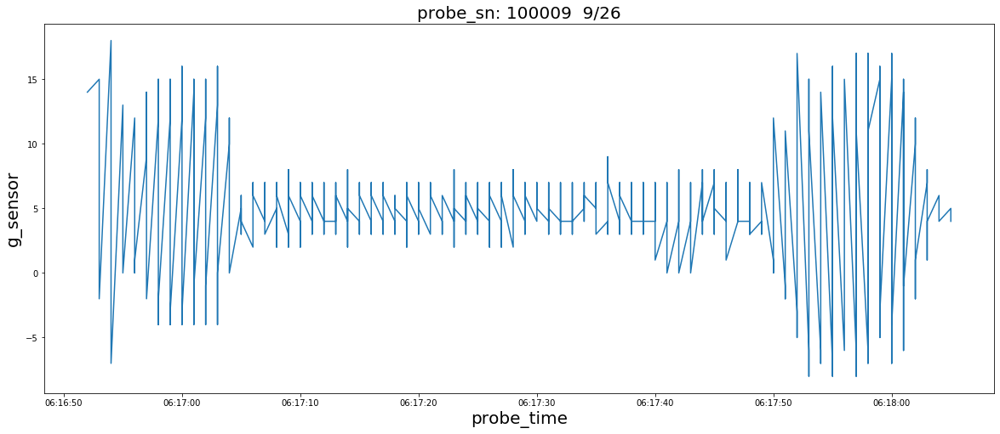

In [25]:
probe = showPlot(100009, 6, 26)

In [26]:
probe.head(200)

,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time,g_sensor,g_sensor_xz
26571,100009,2001,12,-90,14,97,1,2020-09-26 06:16:52,2020-09-26 06:16:53,98.010204,14.035669
26580,100009,2001,12,-88,15,94,0,2020-09-26 06:16:53,2020-09-26 06:16:54,95.189285,15.000000
26581,100009,2001,5,-91,-2,90,1,2020-09-26 06:16:53,2020-09-26 06:16:54,90.027773,2.236068
26582,100009,2001,6,-87,-2,94,3,2020-09-26 06:16:53,2020-09-26 06:16:54,94.069124,3.605551
26593,100009,2001,12,-83,18,96,0,2020-09-26 06:16:54,2020-09-26 06:16:55,97.672924,18.000000
26594,100009,2001,5,-88,-7,91,2,2020-09-26 06:16:54,2020-09-26 06:16:55,91.290744,7.280110
26595,100009,2001,6,-86,-7,93,1,2020-09-26 06:16:54,2020-09-26 06:16:55,93.268430,7.071068
26605,100009,2001,12,-81,13,95,0,2020-09-26 06:16:55,2020-09-26 06:16:56,95.885348,13.000000
26606,100009,2001,5,-86,0,90,2,2020-09-26 06:16:55,2020-09-26 06:16:56,90.022219,2.000000
26607,100009,2001,6,-80,0,92,1,2020-09-26 06:16:55,2020-09-26 06:16:56,92.005435,1.000000


In [27]:
probe.tail(200)

,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time,g_sensor,g_sensor_xz
27041,100009,2001,5,-72,3,90,2,2020-09-26 06:17:31,2020-09-26 06:17:32,90.072193,3.605551
27042,100009,2001,6,-61,4,92,3,2020-09-26 06:17:31,2020-09-26 06:17:32,92.135769,5.000000
27043,100009,2001,4,-79,5,89,0,2020-09-26 06:17:31,2020-09-26 06:17:32,89.140339,5.000000
27044,100009,2001,11,-58,4,91,0,2020-09-26 06:17:32,2020-09-26 06:17:32,91.087870,4.000000
27045,100009,2001,10,-77,3,89,2,2020-09-26 06:17:32,2020-09-26 06:17:33,89.073004,3.605551
27060,100009,2001,12,-60,7,95,1,2020-09-26 06:17:32,2020-09-26 06:17:33,95.262794,7.071068
27061,100009,2001,5,-69,3,91,1,2020-09-26 06:17:32,2020-09-26 06:17:33,91.054928,3.162278
27062,100009,2001,6,-61,5,92,0,2020-09-26 06:17:32,2020-09-26 06:17:33,92.135769,5.000000
27063,100009,2001,4,-83,4,90,4,2020-09-26 06:17:32,2020-09-26 06:17:33,90.177603,5.656854
27064,100009,2001,11,-70,4,90,1,2020-09-26 06:17:33,2020-09-26 06:17:34,90.094395,4.123106


正向

停站时间 6:17:04 到 6:17:51 

地铁进站，7-12 minor由10以上到10以下，1-6由负数到0到正数

地铁出站，7-12 由正数到0到负数，1-6由10以下到10以上

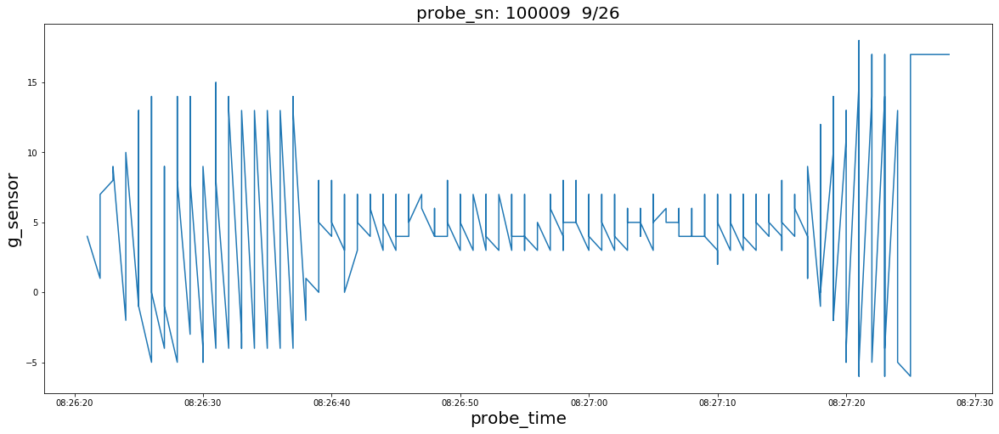

In [28]:
probe = showPlot(100009, 8, 26)

In [29]:
probe.head(200)

,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time,g_sensor,g_sensor_xz
30677,100009,2001,1,-93,4,91,2,2020-09-26 08:26:21,2020-09-26 08:26:22,91.109824,4.472136
30678,100009,2001,7,-82,1,89,-1,2020-09-26 08:26:22,2020-09-26 08:26:23,89.011235,1.414214
30679,100009,2001,1,-80,7,92,0,2020-09-26 08:26:22,2020-09-26 08:26:23,92.265920,7.000000
30680,100009,2001,1,-61,8,91,0,2020-09-26 08:26:23,2020-09-26 08:26:24,91.350972,8.000000
30681,100009,2001,2,-81,9,94,-2,2020-09-26 08:26:23,2020-09-26 08:26:24,94.451046,9.219544
30682,100009,2001,8,-81,-2,96,-2,2020-09-26 08:26:24,2020-09-26 08:26:25,96.041658,2.828427
30683,100009,2001,7,-55,-1,89,-2,2020-09-26 08:26:24,2020-09-26 08:26:25,89.028085,2.236068
30684,100009,2001,1,-71,9,91,1,2020-09-26 08:26:24,2020-09-26 08:26:25,91.449440,9.055385
30685,100009,2001,2,-63,10,95,1,2020-09-26 08:26:24,2020-09-26 08:26:25,95.530100,10.049876
30686,100009,2001,7,-75,-1,90,-1,2020-09-26 08:26:25,2020-09-26 08:26:26,90.011110,1.414214


In [30]:
probe.tail(200)

,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time,g_sensor,g_sensor_xz
30760,100009,2001,11,-69,0,90,1,2020-09-26 08:26:39,2020-09-26 08:26:40,90.005555,1.000000
30761,100009,2001,5,-81,8,90,2,2020-09-26 08:26:39,2020-09-26 08:26:40,90.376988,8.246211
30762,100009,2001,6,-62,5,92,1,2020-09-26 08:26:39,2020-09-26 08:26:40,92.141196,5.099020
30765,100009,2001,11,-86,4,89,2,2020-09-26 08:26:40,2020-09-26 08:26:42,89.112289,4.472136
30766,100009,2001,12,-71,8,96,0,2020-09-26 08:26:40,2020-09-26 08:26:42,96.332757,8.000000
30767,100009,2001,6,-62,5,92,-1,2020-09-26 08:26:40,2020-09-26 08:26:42,92.141196,5.099020
30768,100009,2001,11,-68,3,89,2,2020-09-26 08:26:41,2020-09-26 08:26:43,89.073004,3.605551
30769,100009,2001,5,-68,4,91,1,2020-09-26 08:26:41,2020-09-26 08:26:43,91.093359,4.123106
30770,100009,2001,12,-70,7,95,0,2020-09-26 08:26:41,2020-09-26 08:26:43,95.257546,7.000000
30771,100009,2001,4,-89,5,91,2,2020-09-26 08:26:41,2020-09-26 08:26:43,91.159201,5.385165


反向

进站8:26:39 出站 8:27:18

7-12由负数到0到正数，1-6由10以上到10以下

7-12由10以下到10以上，1-6由正数到0到负数

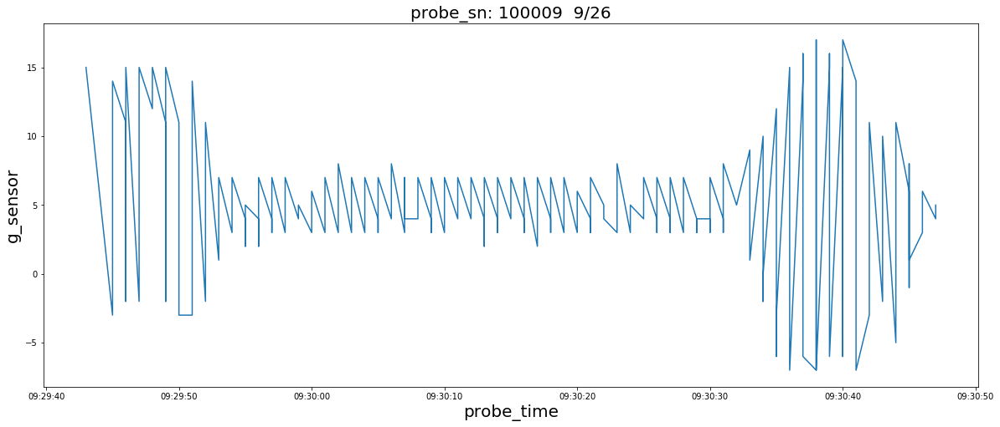

In [31]:
probe = showPlot(100009, 9, 26)

In [32]:
probe.head(200)

,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time,g_sensor,g_sensor_xz
31097,100009,2001,12,-85,15,94,0,2020-09-26 09:29:43,2020-09-26 09:29:45,95.189285,15.000000
31101,100009,2001,6,-76,-3,93,0,2020-09-26 09:29:45,2020-09-26 09:29:46,93.048375,3.000000
31102,100009,2001,12,-74,14,95,0,2020-09-26 09:29:45,2020-09-26 09:29:47,96.026038,14.000000
31104,100009,2001,11,-87,11,89,2,2020-09-26 09:29:46,2020-09-26 09:29:48,89.699498,11.180340
31105,100009,2001,6,-73,-2,93,1,2020-09-26 09:29:46,2020-09-26 09:29:48,93.026878,2.236068
31106,100009,2001,12,-77,15,95,0,2020-09-26 09:29:46,2020-09-26 09:29:48,96.176920,15.000000
31109,100009,2001,6,-74,-2,93,2,2020-09-26 09:29:47,2020-09-26 09:29:48,93.043001,2.828427
31110,100009,2001,12,-80,15,96,0,2020-09-26 09:29:47,2020-09-26 09:29:49,97.164808,15.000000
31113,100009,2001,11,-86,12,89,3,2020-09-26 09:29:48,2020-09-26 09:29:49,89.855439,12.369317
31116,100009,2001,12,-86,15,95,0,2020-09-26 09:29:48,2020-09-26 09:29:50,96.176920,15.000000


In [33]:
probe.tail(200)

,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time,g_sensor,g_sensor_xz
31102,100009,2001,12,-74,14,95,0,2020-09-26 09:29:45,2020-09-26 09:29:47,96.026038,14.000000
31104,100009,2001,11,-87,11,89,2,2020-09-26 09:29:46,2020-09-26 09:29:48,89.699498,11.180340
31105,100009,2001,6,-73,-2,93,1,2020-09-26 09:29:46,2020-09-26 09:29:48,93.026878,2.236068
31106,100009,2001,12,-77,15,95,0,2020-09-26 09:29:46,2020-09-26 09:29:48,96.176920,15.000000
31109,100009,2001,6,-74,-2,93,2,2020-09-26 09:29:47,2020-09-26 09:29:48,93.043001,2.828427
31110,100009,2001,12,-80,15,96,0,2020-09-26 09:29:47,2020-09-26 09:29:49,97.164808,15.000000
31113,100009,2001,11,-86,12,89,3,2020-09-26 09:29:48,2020-09-26 09:29:49,89.855439,12.369317
31116,100009,2001,12,-86,15,95,0,2020-09-26 09:29:48,2020-09-26 09:29:50,96.176920,15.000000
31117,100009,2001,11,-80,11,89,2,2020-09-26 09:29:49,2020-09-26 09:29:50,89.699498,11.180340
31118,100009,2001,6,-87,-2,93,1,2020-09-26 09:29:49,2020-09-26 09:29:50,93.026878,2.236068


正向

停站时间 9:29:52 到 6:30:34

地铁进站，7-12 minor由10以上到10以下，1-6由负数到0到正数

地铁出站，7-12 由正数到0到负数，1-6由10以下到10以上


In [34]:
probe = data1[(data1['probe_sn'] == 100009) & (data1['probe_time'].dt.hour == 6) & 
      (data1['probe_time'].dt.day == 26) & (data1['minor'] == 12)]

每个minor的位置

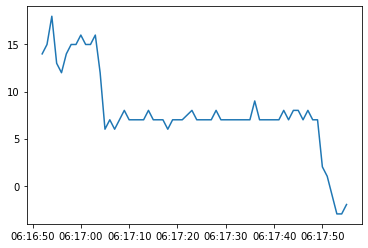

In [35]:
plt.plot(probe['probe_time'], probe['g_sensor_x'])

In [56]:
a = probe['g_sensor_x'].values.tolist()
a = [i - 7 for i in a]
len(a)

63

In [249]:
def showPlotAllMinor(probe_sn, probe_day, probe_hour):
    plt.figure(figsize=(20,30))
    probe = data1[(data1['probe_sn'] == probe_sn) & (data1['probe_time'].dt.hour == probe_hour) & (data1['probe_time'].dt.day == probe_day)]
    for minor in range(1, 13):
        plt.subplot(4, 3, minor)
        probe1 = probe[probe['minor'] == minor]
        plt.plot(probe1['probe_time'], probe1['g_sensor_x'])
        plt.xlabel('probe_time', fontsize=20)
        plt.ylabel('g_sensor', fontsize=20)
        plt.title('probe_sn: {}  9/{}  minor {}'.format(probe_sn, probe_day, minor), fontsize=20)
#     return probe

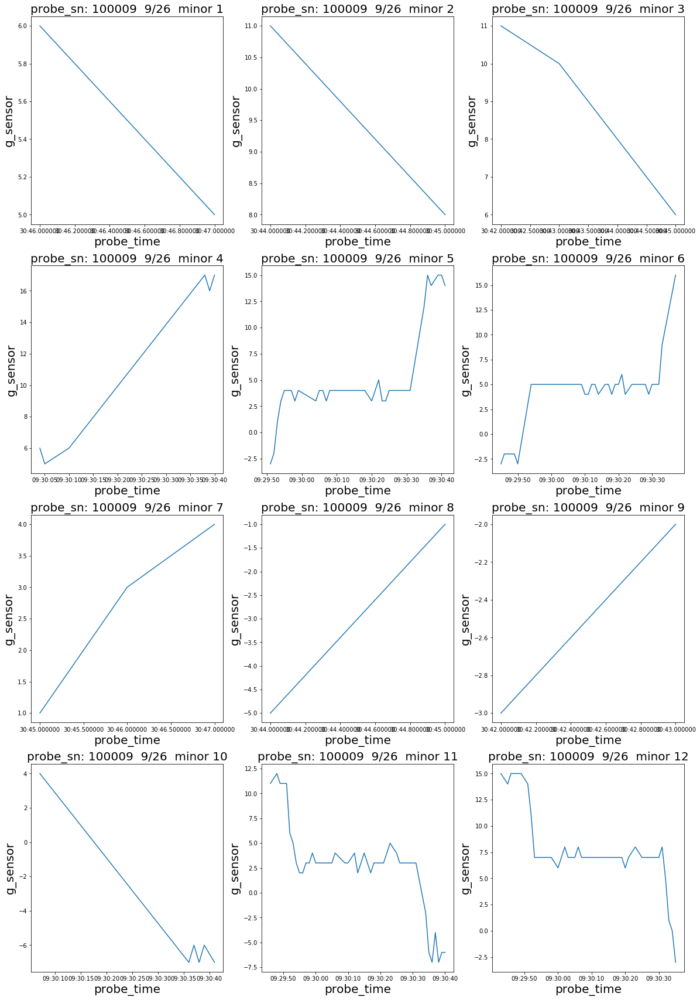

In [250]:
showPlotAllMinor(100009, 26, 9)

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam

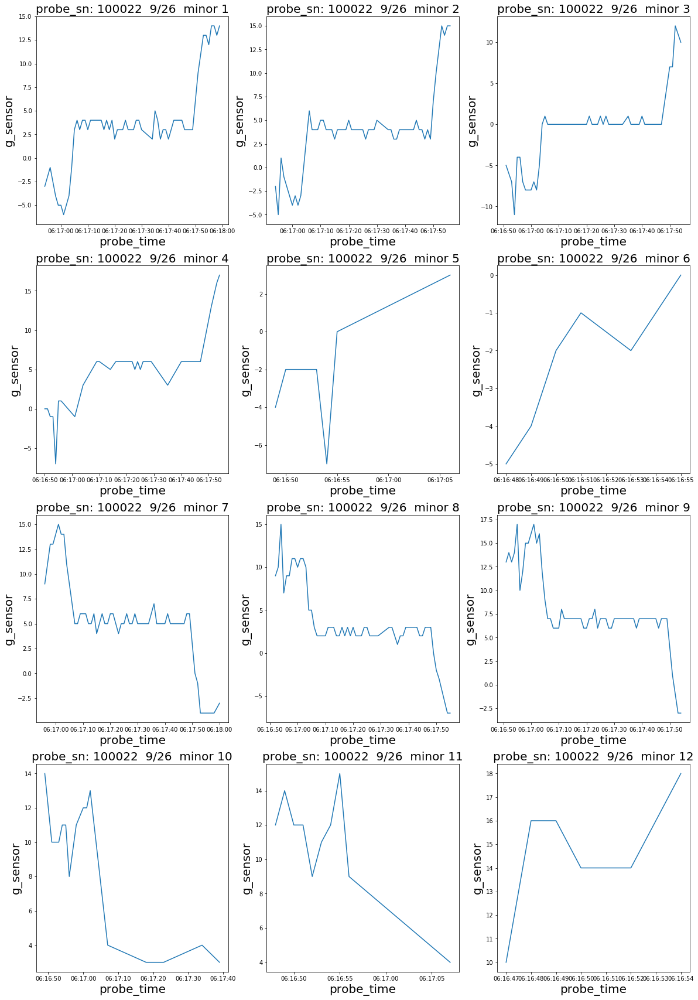

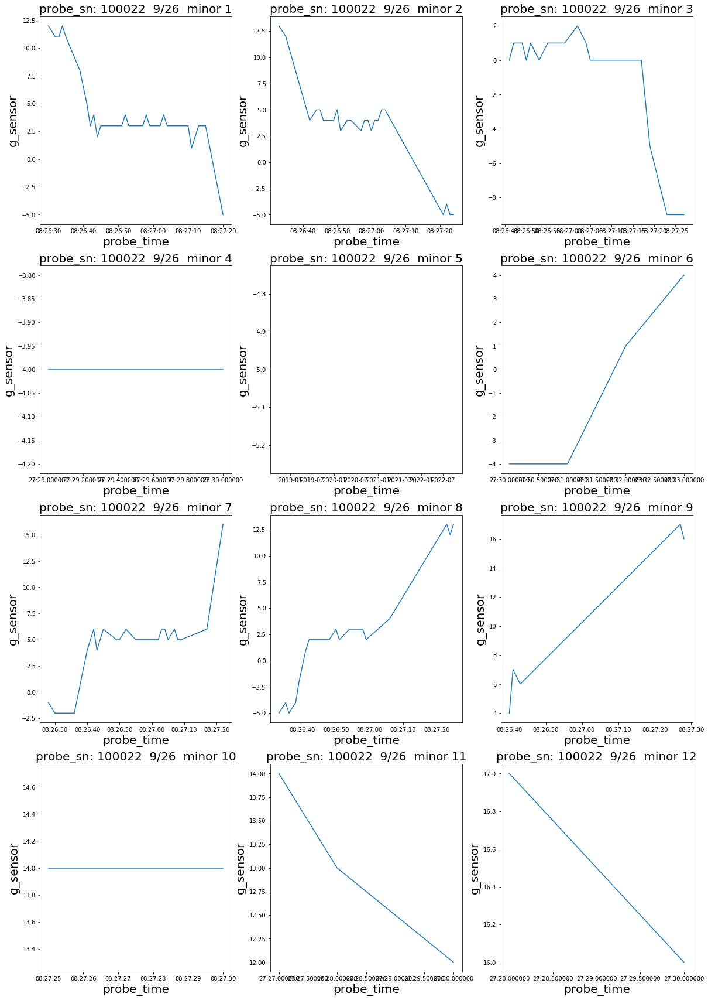

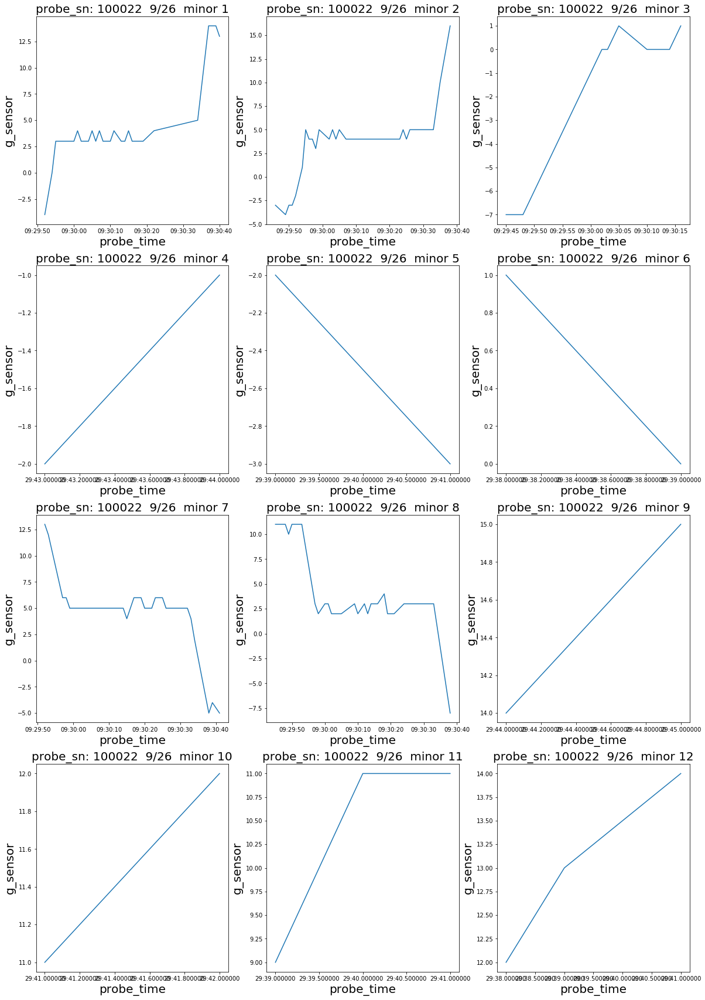

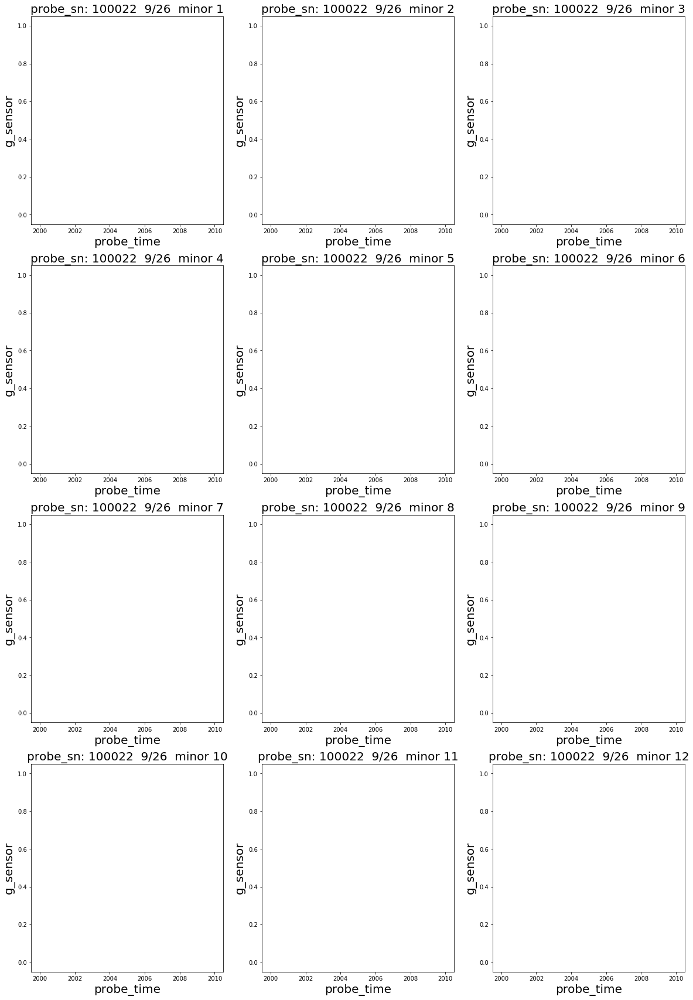

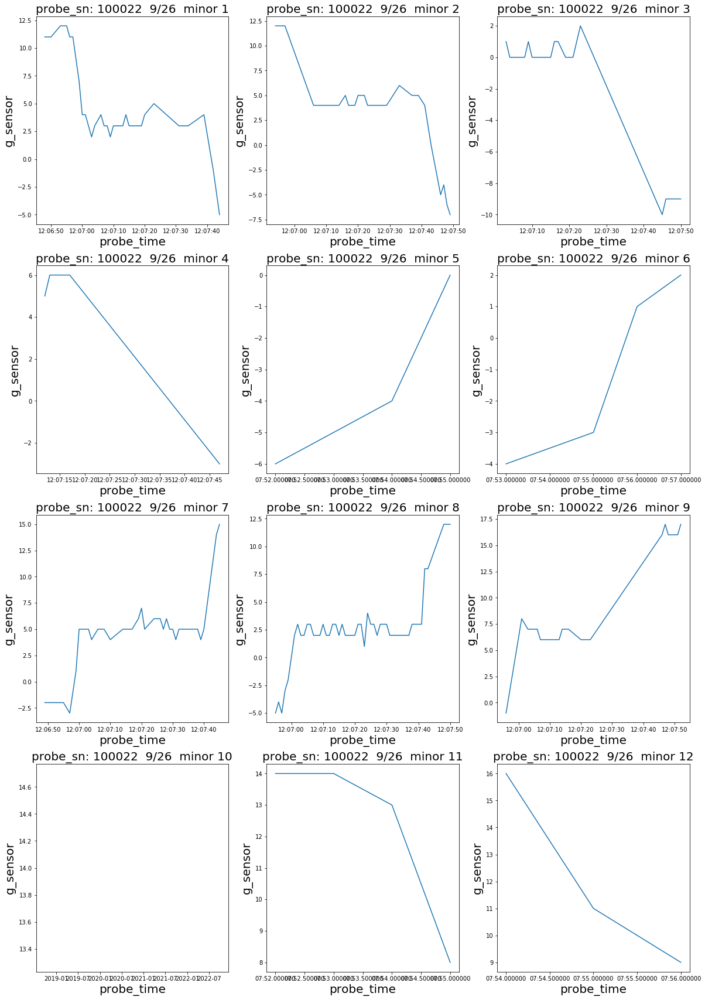

...

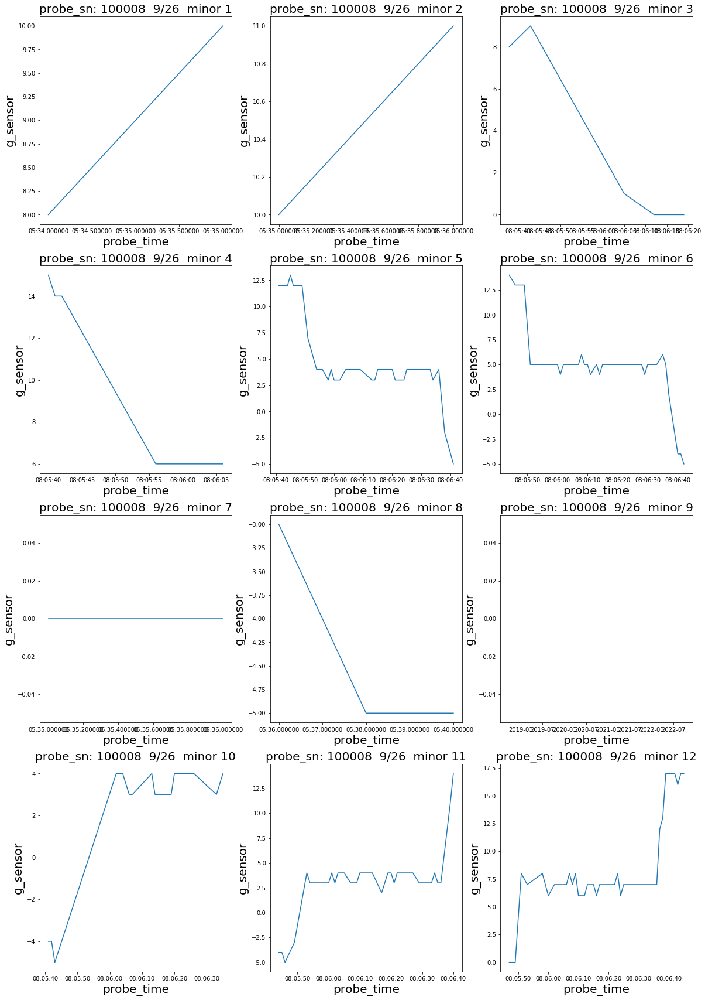

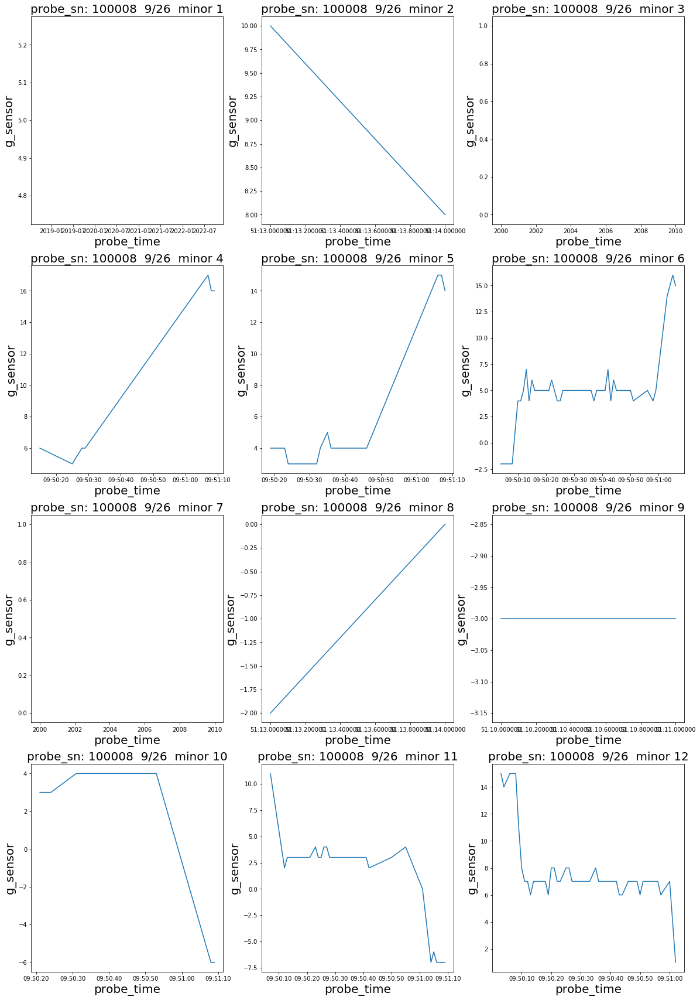

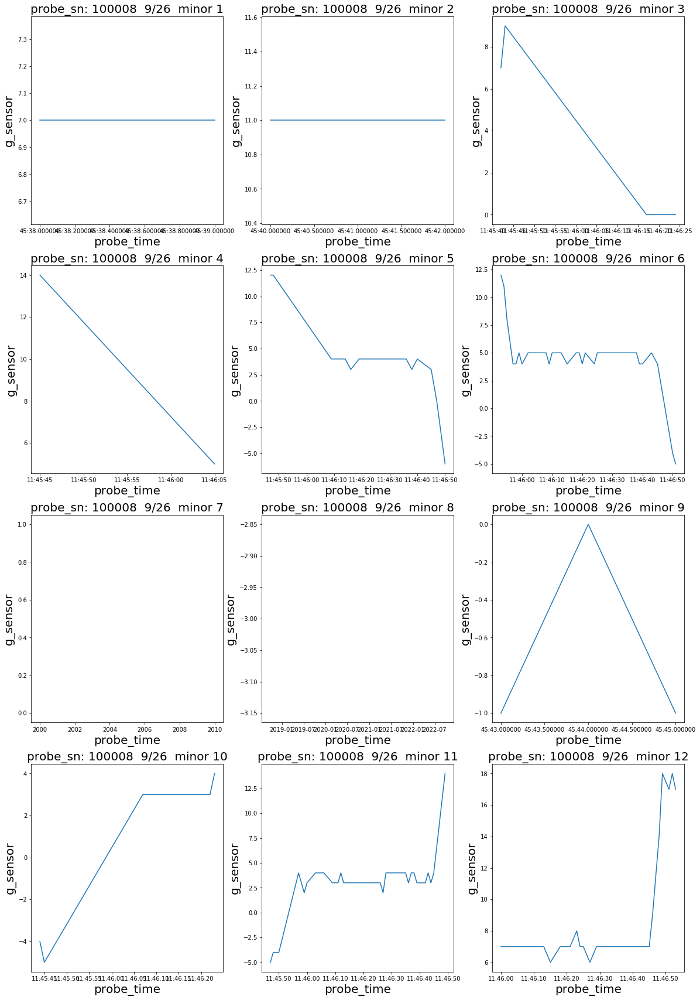

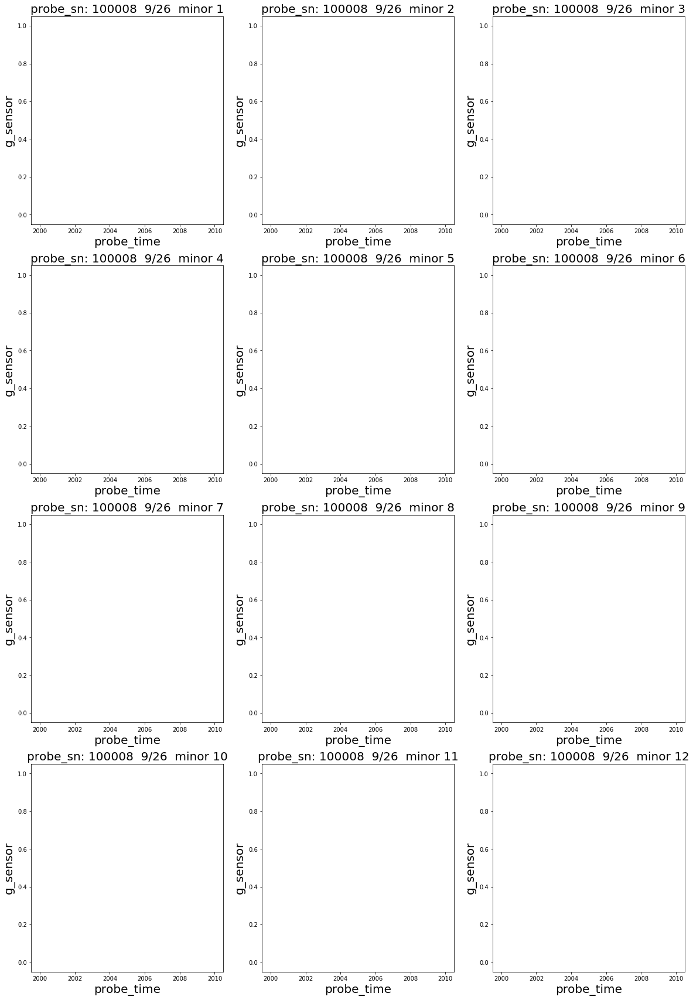

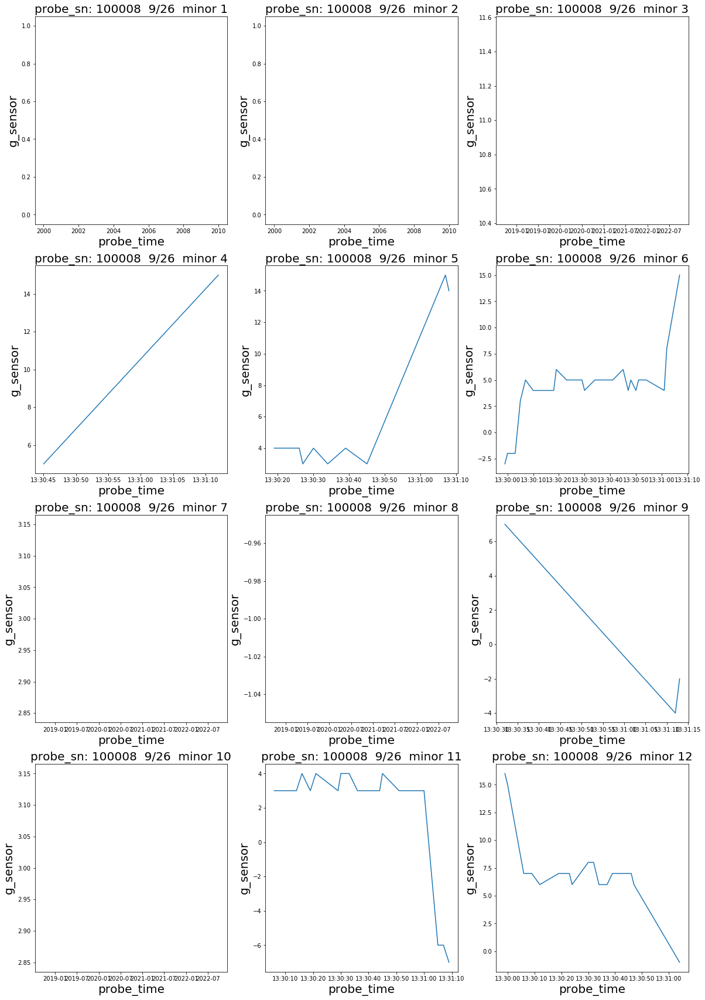

In [227]:
for probe_sn in data1['probe_sn'].unique():
    for probe_hour in data1['probe_time'].dt.hour.unique():
        showPlotAllMinor(probe_sn, 26, probe_hour)

## showPlotEveryMinor(100009, 12,  26, 9)

probe_sn = 100009

26号9点的

每个时刻的数据的平均值

1-6 

7-12

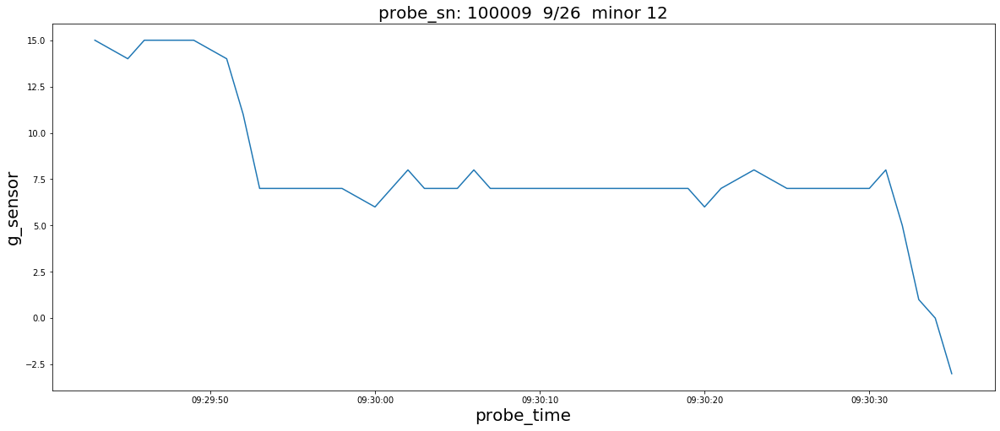

In [253]:
showPlotEveryMinor(100009, 12)

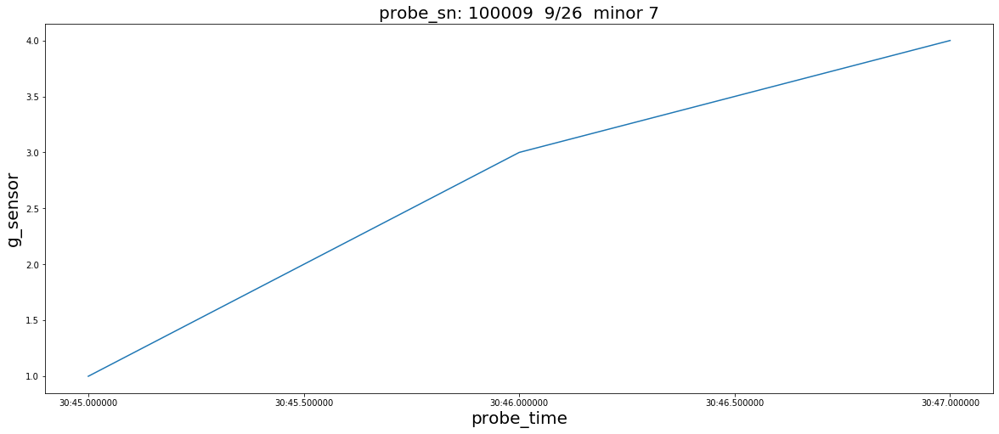

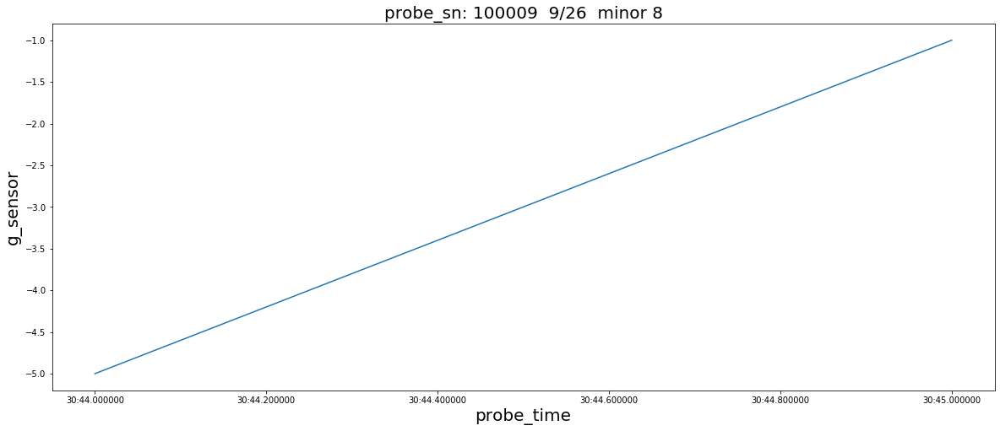

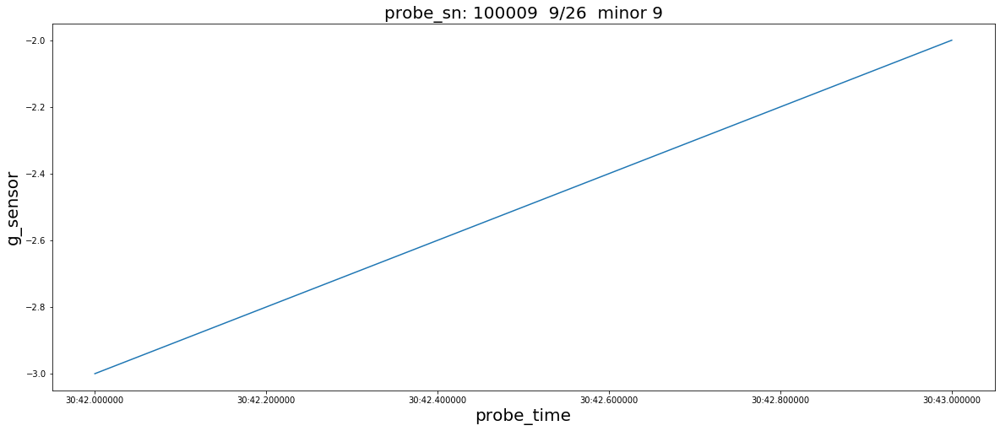

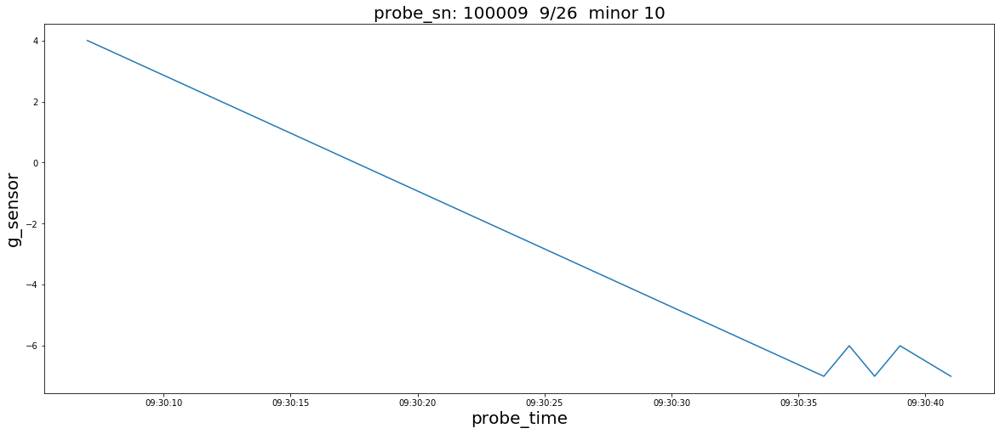

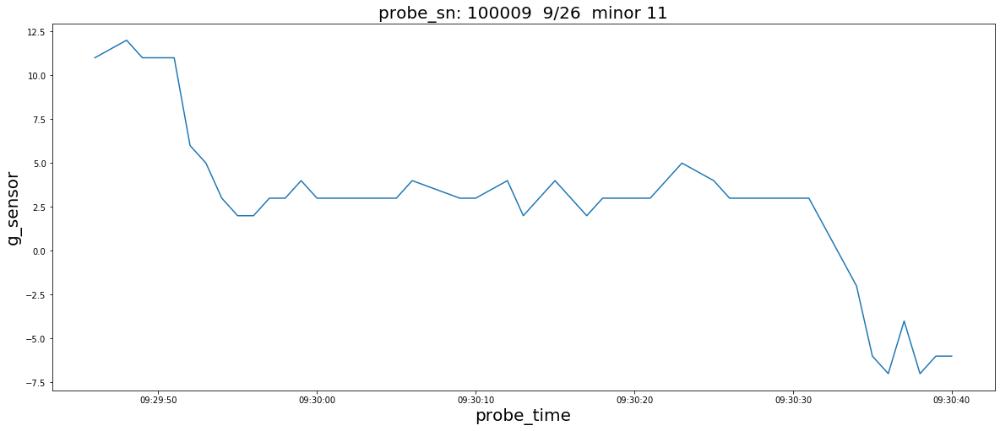

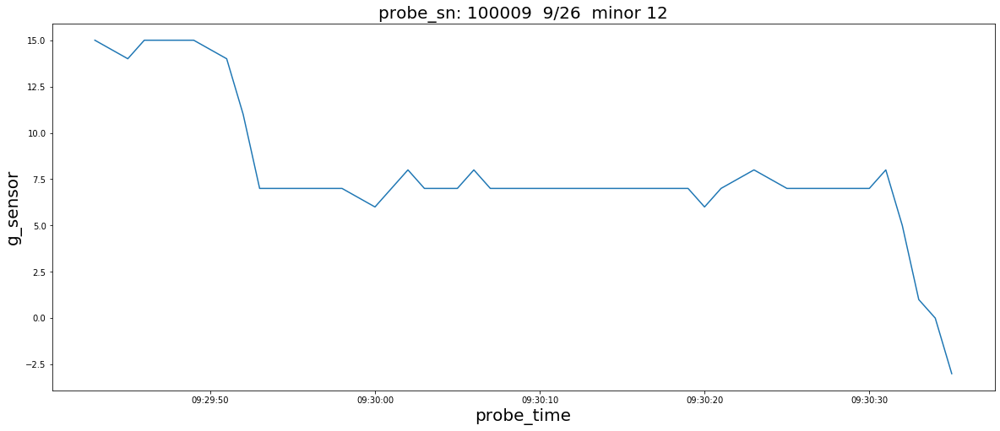

In [255]:
for i in range(7, 13):
    showPlotEveryMinor(100009, i)

In [275]:
def showPlotMinor1(probe_sn=100009, probe_hour=9, probe_day=26):
    plt.figure(figsize=(20,8))
    probe = data1[(data1['probe_sn'] == probe_sn) & (data1['probe_time'].dt.hour == probe_hour) & (data1['probe_time'].dt.day == probe_day)
                 & (data1['minor'] > 6)]
    plt.plot(probe['probe_time'], probe['g_sensor_x'])
    plt.xlabel('probe_time', fontsize=20)
    plt.ylabel('g_sensor', fontsize=20)
    plt.title('probe_sn: {}  9/{}'.format(probe_sn, probe_day), fontsize=20)
    return probe

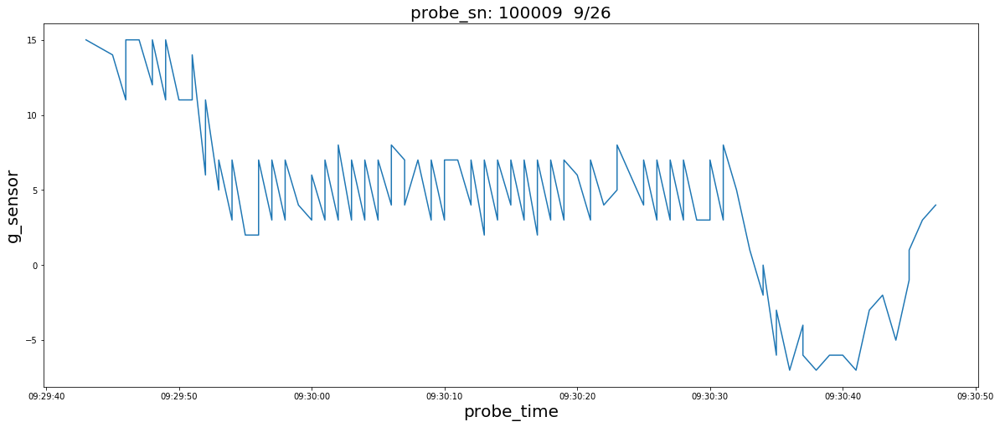

In [278]:
probe = showPlotMinor1()

In [315]:
probe

,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time
31097,100009,2001,12,-85,15,94,0,2020-09-26 09:29:43,2020-09-26 09:29:45
31102,100009,2001,12,-74,14,95,0,2020-09-26 09:29:45,2020-09-26 09:29:47
31104,100009,2001,11,-87,11,89,2,2020-09-26 09:29:46,2020-09-26 09:29:48
31106,100009,2001,12,-77,15,95,0,2020-09-26 09:29:46,2020-09-26 09:29:48
31110,100009,2001,12,-80,15,96,0,2020-09-26 09:29:47,2020-09-26 09:29:49
31113,100009,2001,11,-86,12,89,3,2020-09-26 09:29:48,2020-09-26 09:29:49
31116,100009,2001,12,-86,15,95,0,2020-09-26 09:29:48,2020-09-26 09:29:50
31117,100009,2001,11,-80,11,89,2,2020-09-26 09:29:49,2020-09-26 09:29:50
31119,100009,2001,12,-74,15,95,0,2020-09-26 09:29:49,2020-09-26 09:29:51
31121,100009,2001,11,-81,11,88,0,2020-09-26 09:29:50,2020-09-26 09:29:52


In [273]:
def showPlotMinor2(probe_sn=100009, probe_hour=9, probe_day=26):
    plt.figure(figsize=(20,8))
    probe = data1[(data1['probe_sn'] == probe_sn) & (data1['probe_time'].dt.hour == probe_hour) & (data1['probe_time'].dt.day == probe_day)
                 & (data1['minor'] < 7)]
    plt.plot(probe['probe_time'], probe['g_sensor_x'])
    plt.xlabel('probe_time', fontsize=20)
    plt.ylabel('g_sensor', fontsize=20)
    plt.title('probe_sn: {}  9/{}'.format(probe_sn, probe_day), fontsize=20)
    return probe

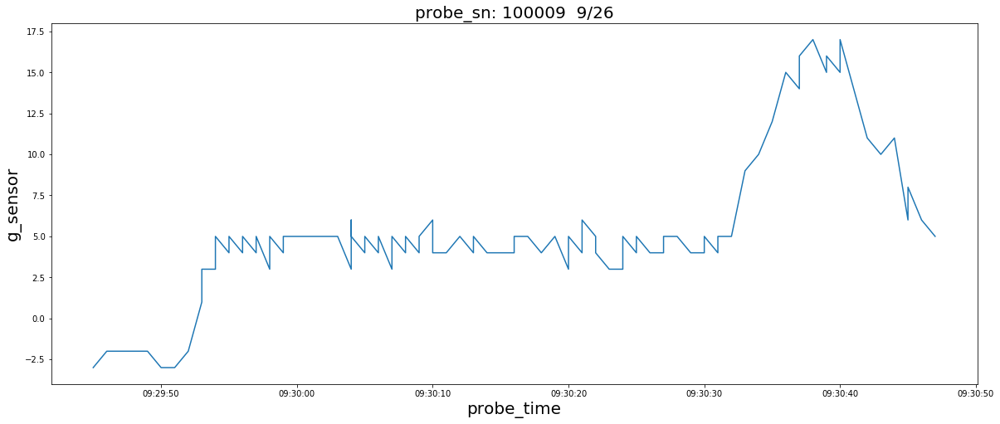

In [296]:
probe1 = showPlotMinor2()

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam

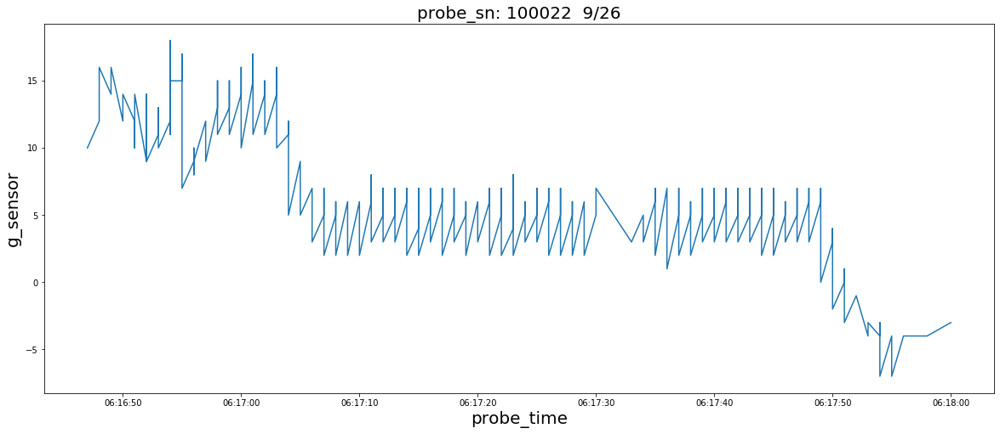

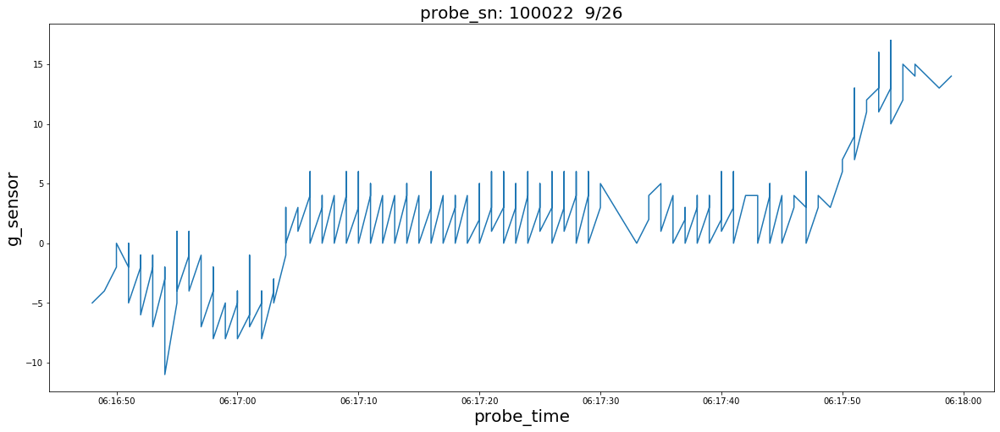

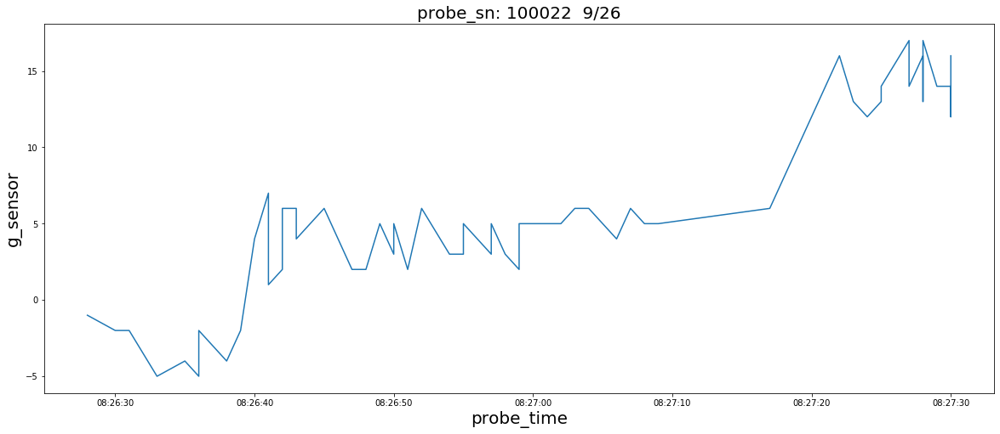

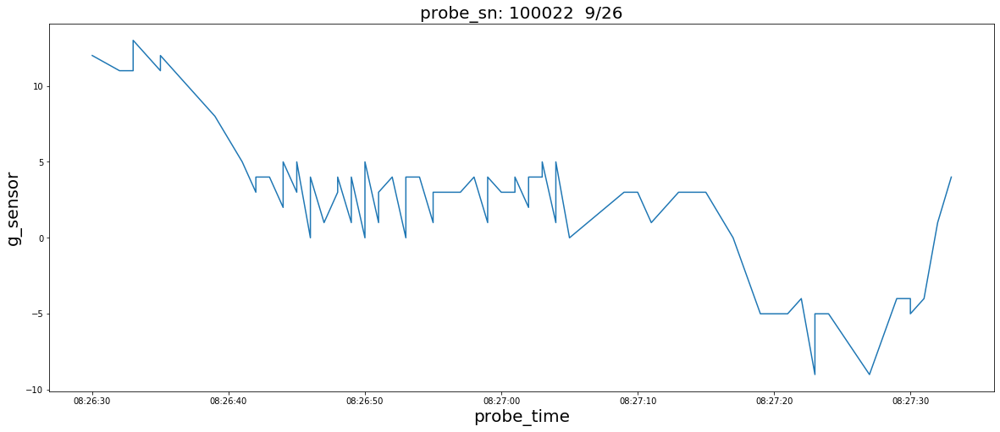

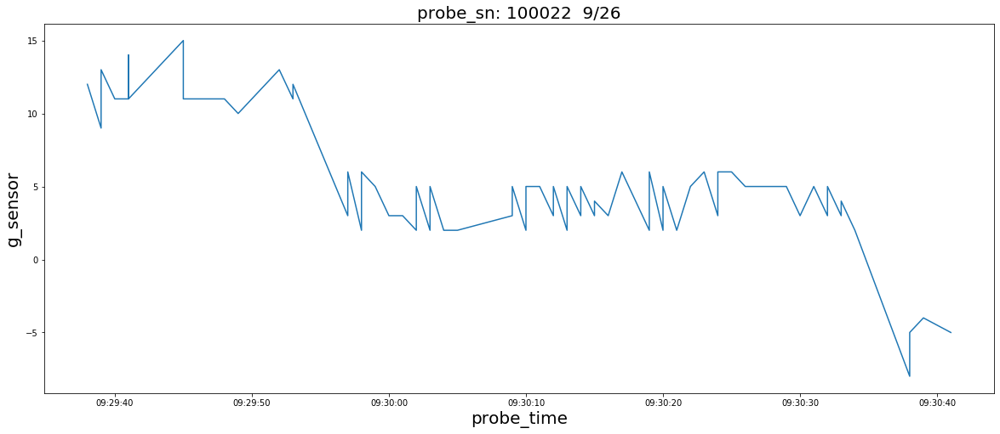

...

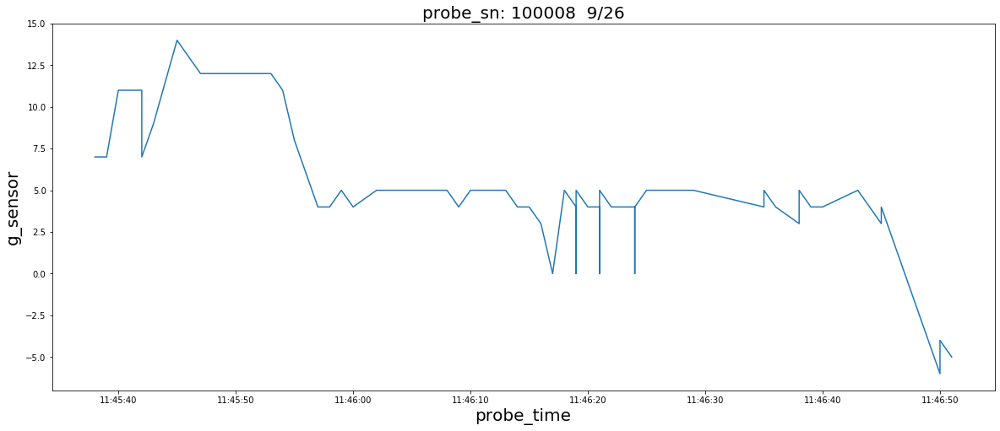

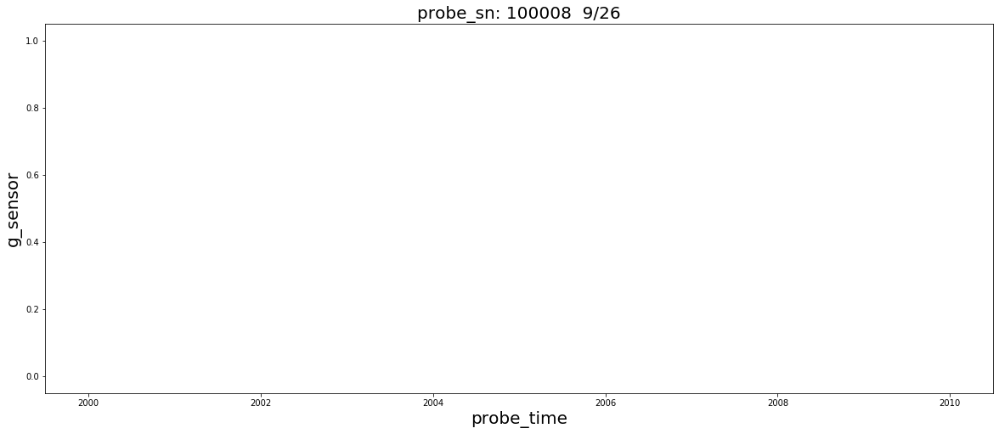

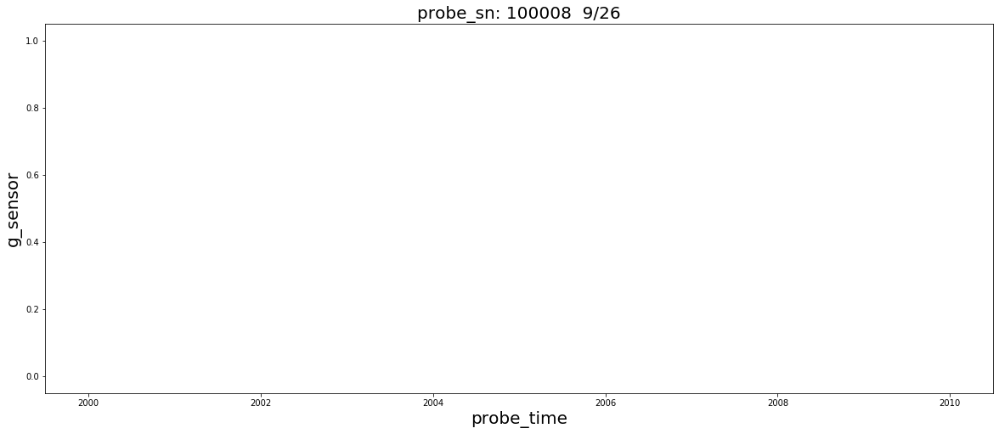

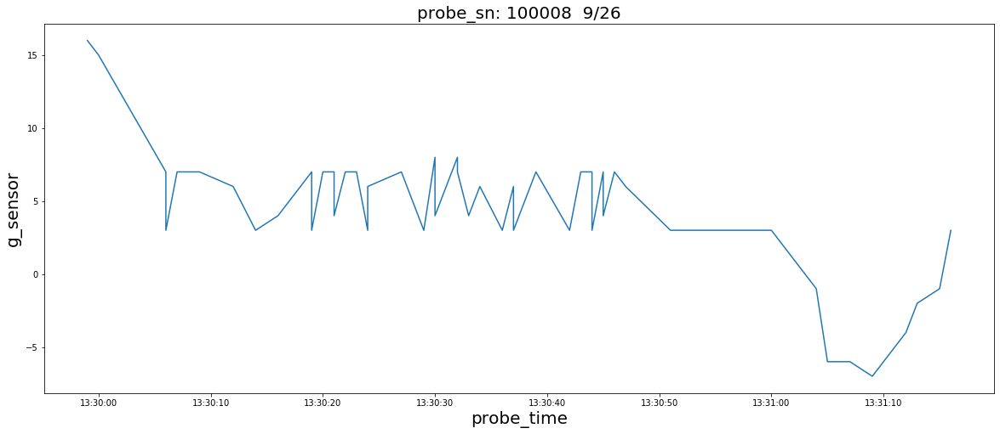

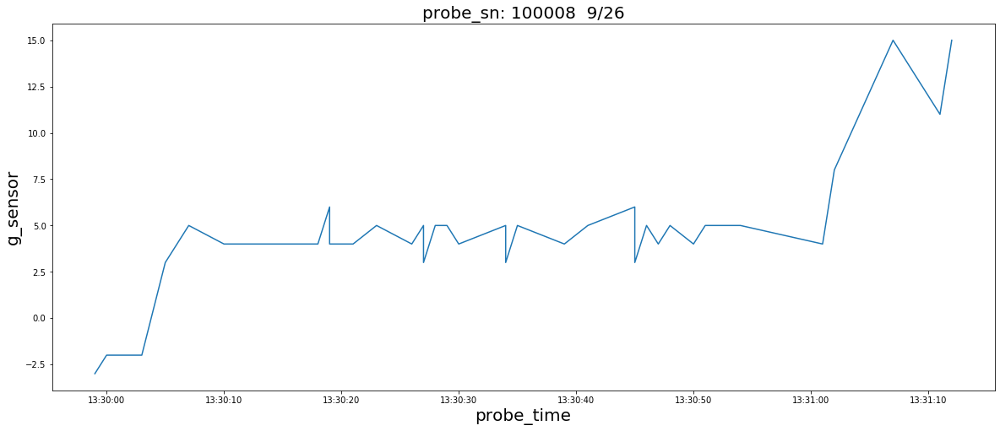

In [272]:
for probe_sn in data1['probe_sn'].unique():
    for probe_hour in data1['probe_time'].dt.hour.unique():
        showPlotMinor1(probe_sn, probe_hour)
        showPlotMinor2(probe_sn, probe_hour)

In [284]:
probe['minor'].value_counts()

11    47
12    46
10     6
7      3
9      2
8      2
Name: minor, dtype: int64

In [292]:
probe['g_sensor_x'][probe['minor'] == 12].values

array([15, 14, 15, 15, 15, 15, 14, 11,  7,  7,  7,  7,  7,  6,  7,  8,  7,
        7,  7,  8,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  6,
        7,  8,  7,  7,  7,  7,  7,  8,  5,  1,  0, -3], dtype=int64)

In [293]:
probe['g_sensor_x'][probe['minor'] == 11].values

array([11, 12, 11, 11, 11,  6,  5,  3,  2,  2,  3,  3,  4,  3,  3,  3,  3,
        3,  3,  4,  3,  3,  4,  2,  3,  4,  3,  2,  3,  3,  3,  4,  5,  4,
        3,  3,  3,  3,  3,  3, -2, -6, -7, -4, -7, -6, -6], dtype=int64)

In [295]:
probe['g_sensor_x'][probe['minor'] == 10].values

array([ 4, -7, -6, -7, -6, -7], dtype=int64)

In [297]:
probe1

,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time
31101,100009,2001,6,-76,-3,93,0,2020-09-26 09:29:45,2020-09-26 09:29:46
31105,100009,2001,6,-73,-2,93,1,2020-09-26 09:29:46,2020-09-26 09:29:48
31109,100009,2001,6,-74,-2,93,2,2020-09-26 09:29:47,2020-09-26 09:29:48
31118,100009,2001,6,-87,-2,93,1,2020-09-26 09:29:49,2020-09-26 09:29:50
31122,100009,2001,6,-89,-3,93,1,2020-09-26 09:29:50,2020-09-26 09:29:52
31123,100009,2001,5,-88,-3,90,3,2020-09-26 09:29:51,2020-09-26 09:29:52
31126,100009,2001,5,-89,-2,90,2,2020-09-26 09:29:52,2020-09-26 09:29:53
31129,100009,2001,5,-86,1,90,2,2020-09-26 09:29:53,2020-09-26 09:29:54
31134,100009,2001,6,-76,3,93,1,2020-09-26 09:29:53,2020-09-26 09:29:55
31139,100009,2001,5,-81,3,91,2,2020-09-26 09:29:54,2020-09-26 09:29:55


In [299]:
probe1['g_sensor_x'][probe1['minor'] == 6].values

array([-3, -2, -2, -2, -3,  3,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  5,  5,  5,  5,  4,  4,  5,  5,  4,  5,  5,  4,  5,  5,  6,  4,
        5,  5,  5,  5,  4,  5,  5,  5,  9, 16], dtype=int64)

In [300]:
probe1['g_sensor_x'][probe1['minor'] == 5].values

array([-3, -2,  1,  3,  4,  4,  4,  3,  4,  3,  4,  4,  3,  4,  4,  4,  4,
        4,  4,  4,  4,  3,  4,  5,  3,  3,  4,  4,  4,  4,  4,  4, 10, 12,
       15, 14, 15, 15, 14], dtype=int64)

In [301]:
probe1['g_sensor_x'][probe1['minor'] == 4].values

array([ 6,  5,  6, 17, 16, 17], dtype=int64)

In [302]:
probe_array = probe['g_sensor_x'][probe['minor'] == 12].values

In [306]:
probe_array

array([15, 14, 15, 15, 15, 15, 14, 11,  7,  7,  7,  7,  7,  6,  7,  8,  7,
        7,  7,  8,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  6,
        7,  8,  7,  7,  7,  7,  7,  8,  5,  1,  0, -3], dtype=int64)

In [307]:
len(probe)  

106

In [344]:
from matplotlib.dates import AutoDateLocator, DateFormatter
def showScatter(probe_sn=100009, probe_hour=9, probe_day=26):
    plt.figure(figsize=(20,8))
    probe = data1[(data1['probe_sn'] == probe_sn) & (data1['probe_time'].dt.hour == probe_hour) & 
                  (data1['probe_time'].dt.day == probe_day)]
    plt.plot_date(probe['probe_time'], probe['g_sensor_x'], fmt='b.')

#     ax = plt.gca()
#     ax.xaxis.set_major_formatter(DateFormatter('%Y-%m-%d %H:%M:%S'))  #设置时间显示格式
#     ax.xaxis.set_major_locator(AutoDateLocator(maxticks=24))       #设置时间间隔  
#     plt.legend(label, loc='upper right')
#     plt.grid()
    plt.xlabel('probe_time', fontsize=20)
    plt.ylabel('g_sensor_x', fontsize=20)
    plt.title('probe_sn: {}  9/{}'.format(probe_sn, probe_day), fontsize=20)
    return probe

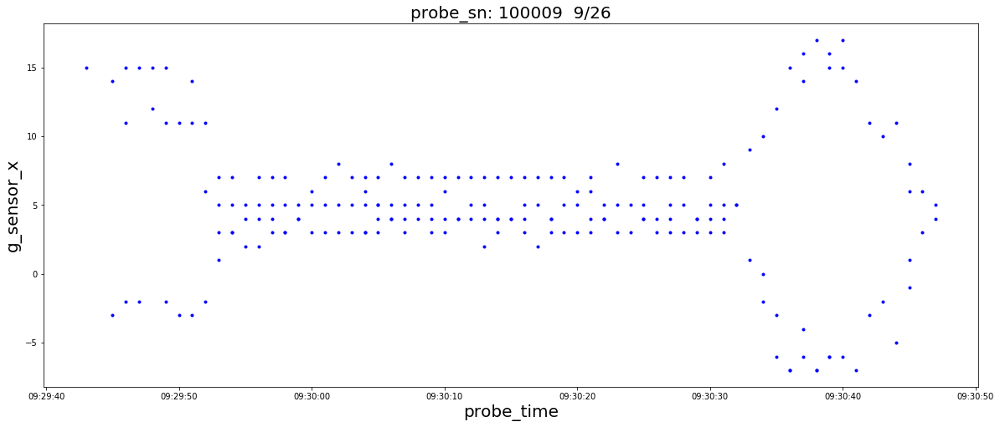

In [345]:
probe = showScatter()

In [35]:
def showMinorScatter(minor=12, probe_sn=100009, probe_hour=9, probe_day=26):
    plt.figure(figsize=(20,8))
    probe = data1[(data1['probe_sn'] == probe_sn) & (data1['probe_time'].dt.hour == probe_hour) & 
                  (data1['probe_time'].dt.day == probe_day) & (data1['minor'] == minor)]
    plt.plot_date(probe['probe_time'], probe['g_sensor_x'], fmt='b.')

#     ax = plt.gca()
#     ax.xaxis.set_major_formatter(DateFormatter('%Y-%m-%d %H:%M:%S'))  #设置时间显示格式
#     ax.xaxis.set_major_locator(AutoDateLocator(maxticks=24))       #设置时间间隔  
#     plt.legend(label, loc='upper right')
#     plt.grid()
    plt.xlabel('probe_time', fontsize=20)
    plt.ylabel('g_sensor_x', fontsize=20)
    plt.title('probe_sn: {}  9/{} minor'.format(probe_sn, probe_day, minor), fontsize=20)
    return probe

In [160]:
def showScatterAllMinor(probe_sn=100009, probe_hour=9, probe_day=26):
    plt.figure(figsize=(20,30))
    probe = data1[(data1['probe_sn'] == probe_sn) & (data1['probe_time'].dt.hour == probe_hour) & (data1['probe_time'].dt.day == probe_day)]
    for minor in range(1, 13):
        plt.subplot(4, 3, minor)
        probe1 = probe[probe['minor'] == minor]
        plt.plot_date(probe1['probe_time'], probe1['g_sensor_x'], fmt='b.')
        plt.xlabel('probe_time', fontsize=20)
        plt.ylabel('g_sensor', fontsize=20)
        plt.title('probe_sn: {}  9/{}  minor {}'.format(probe_sn, probe_day, minor), fontsize=20)

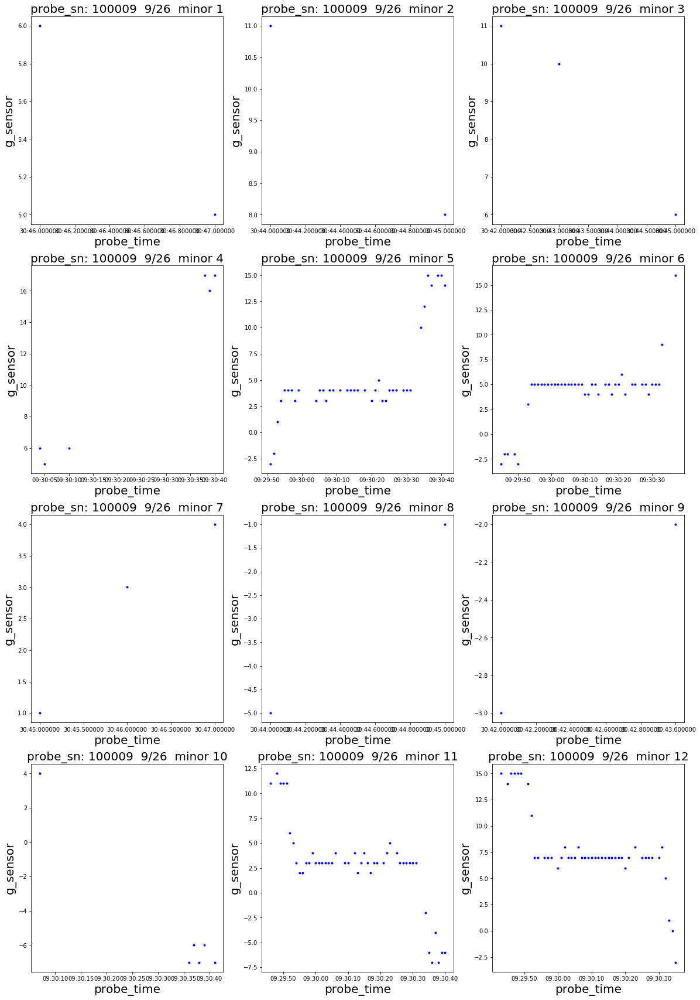

In [170]:
showScatterAllMinor()

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam

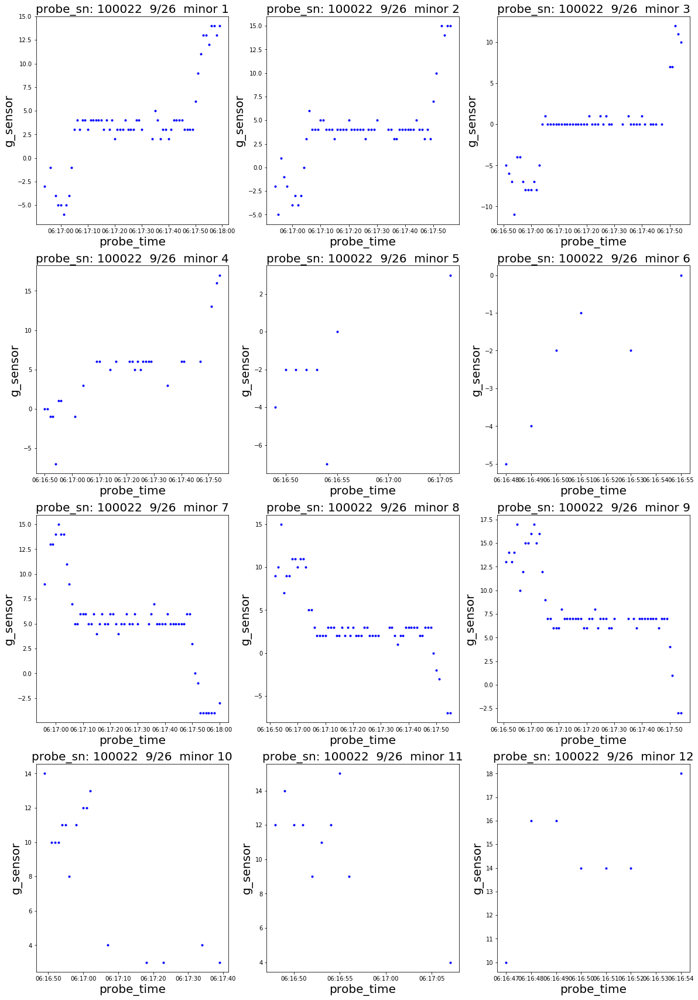

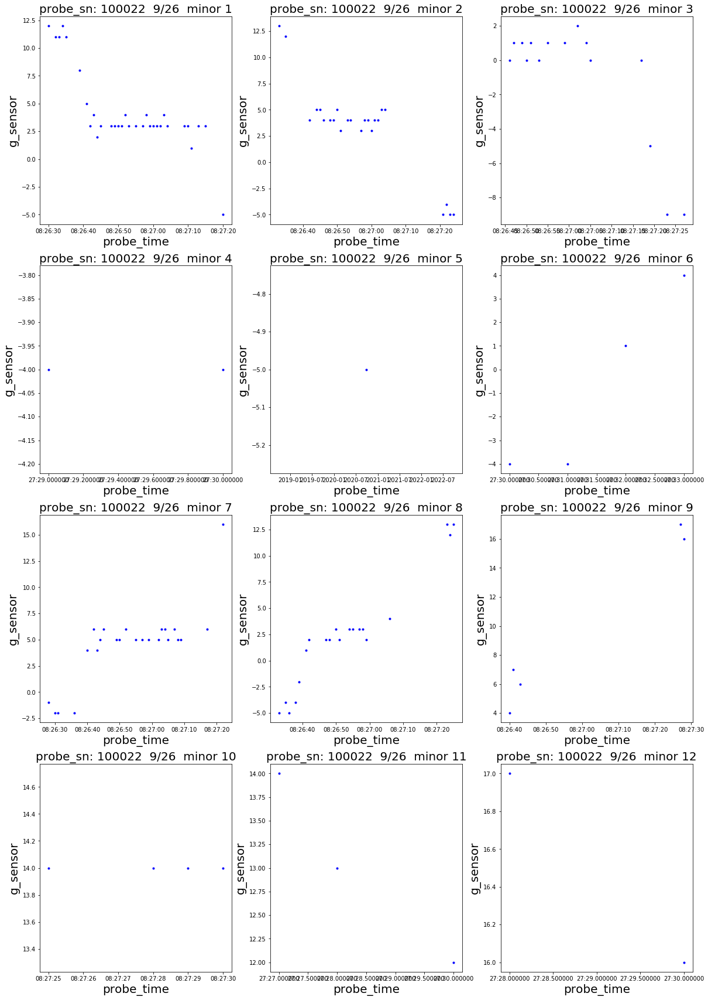

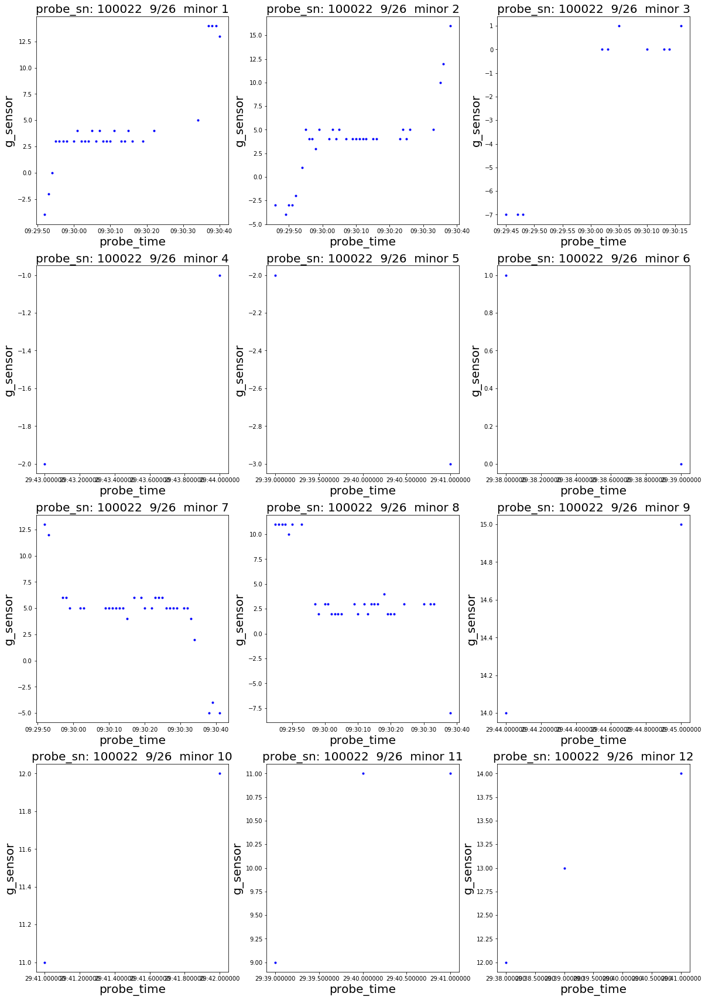

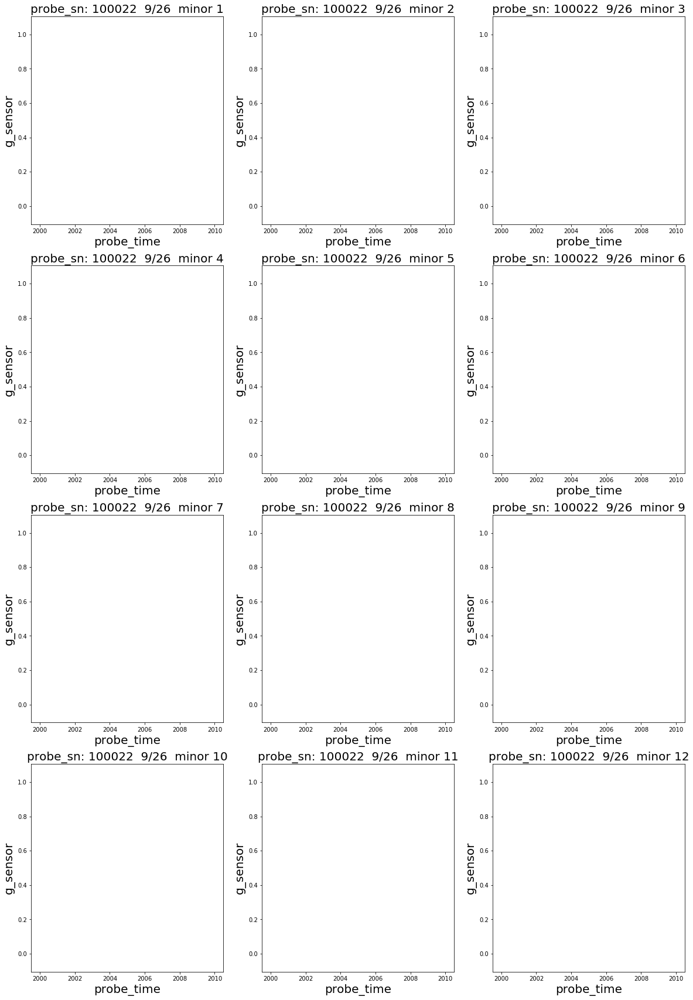

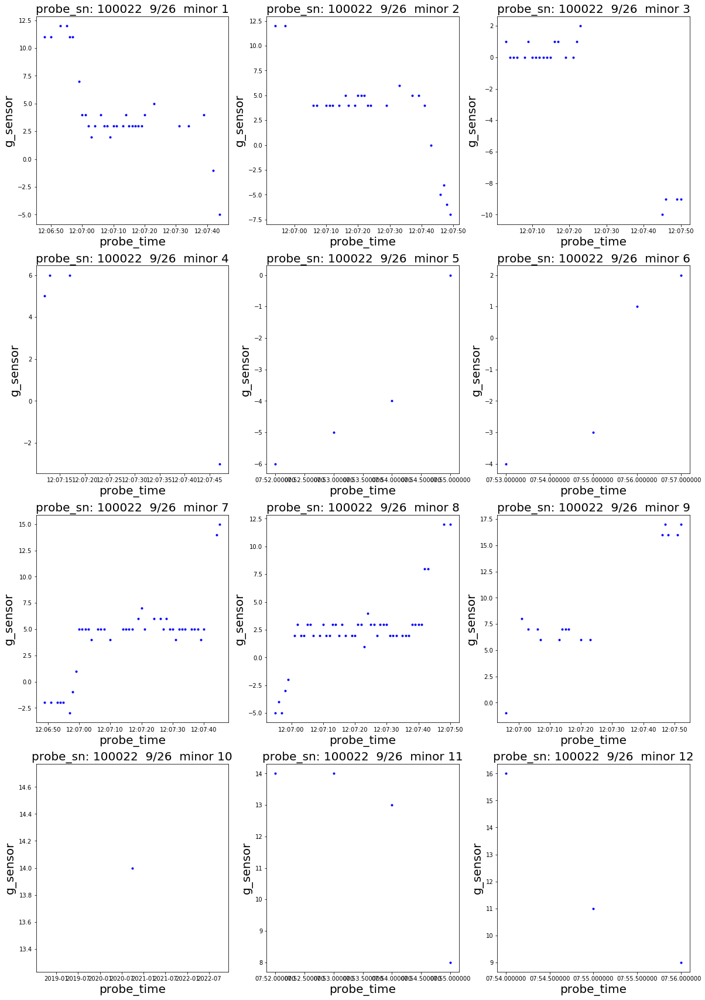

...

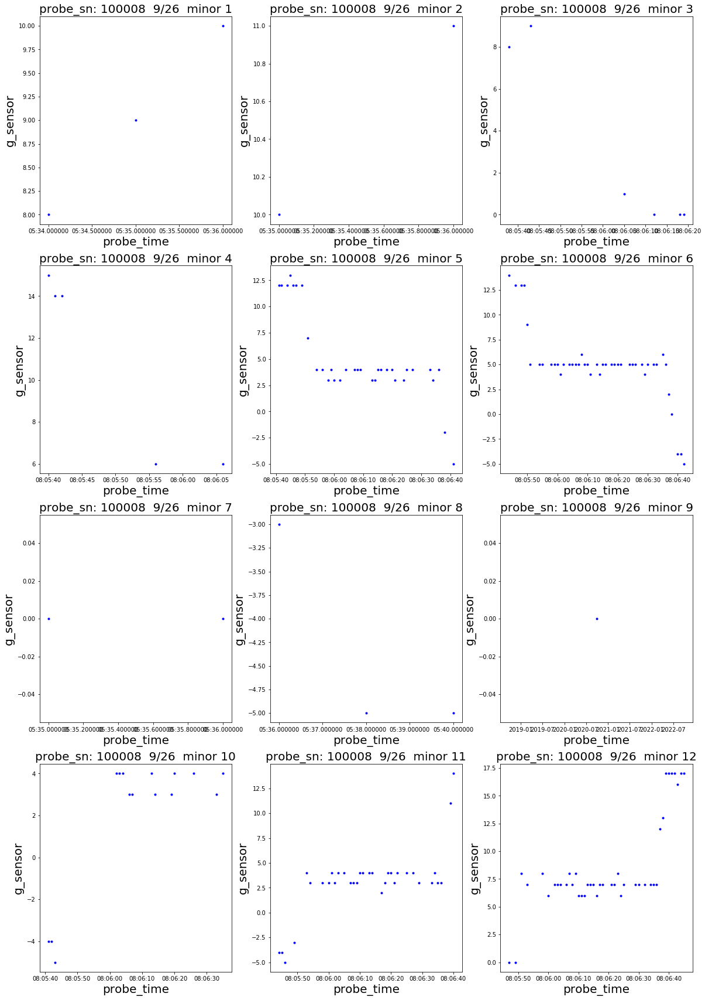

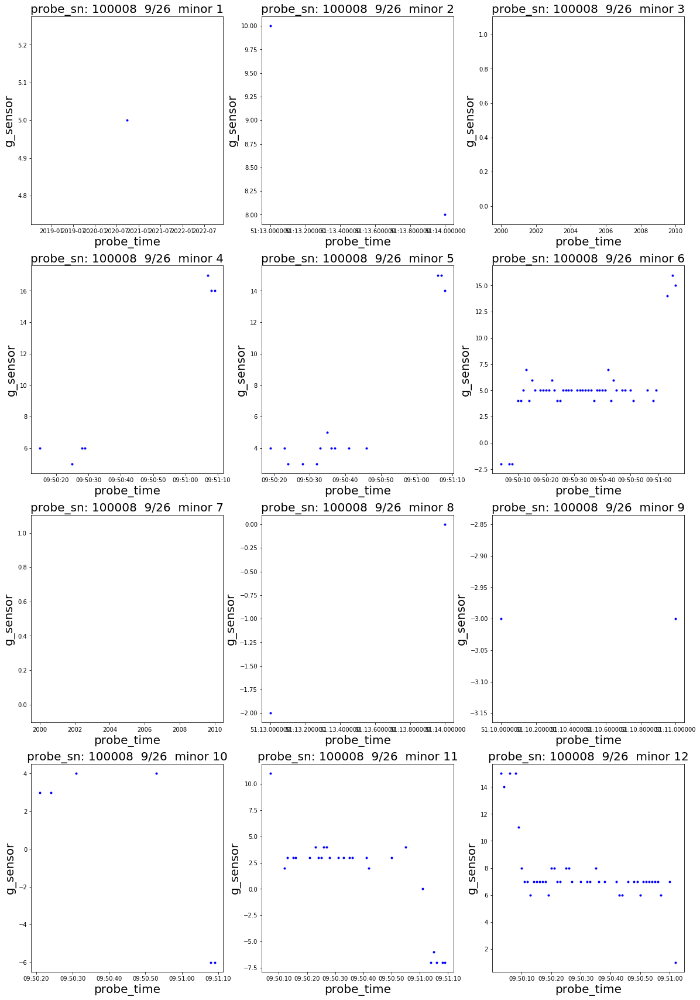

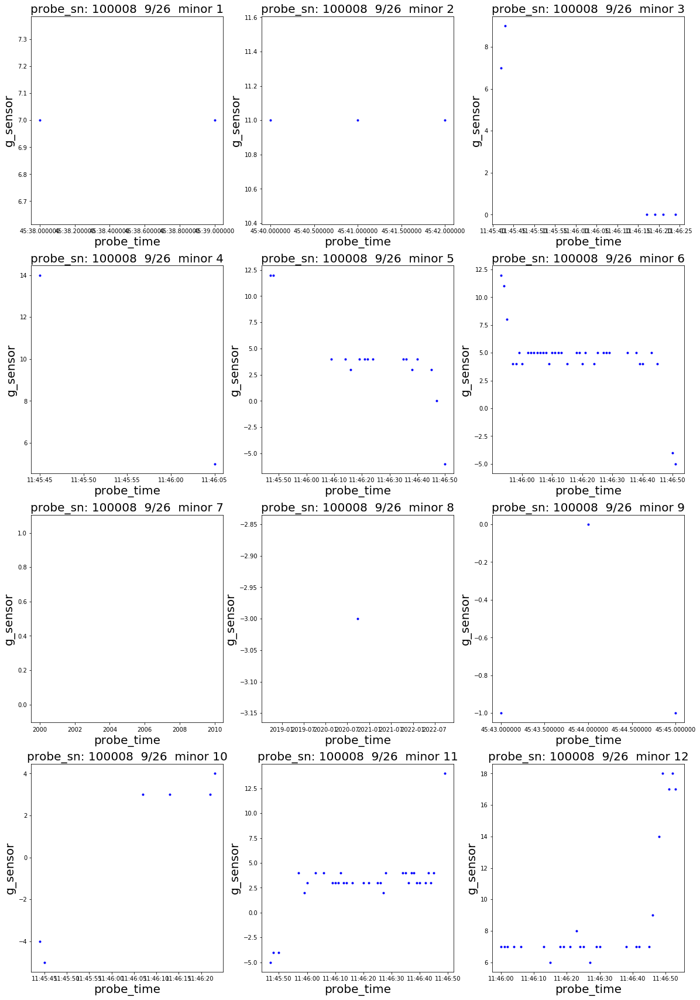

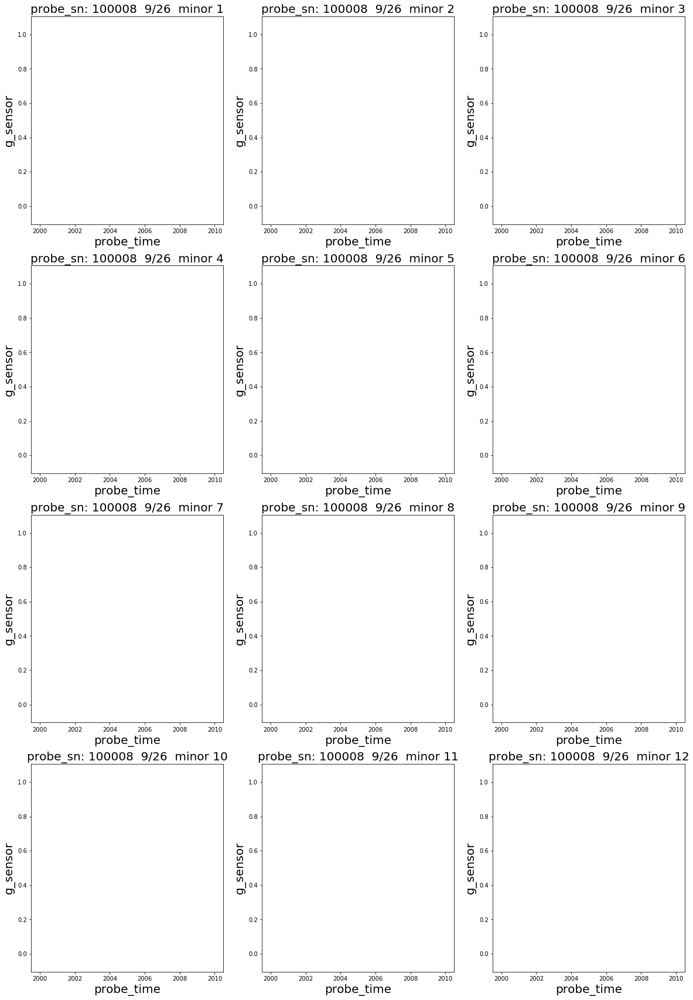

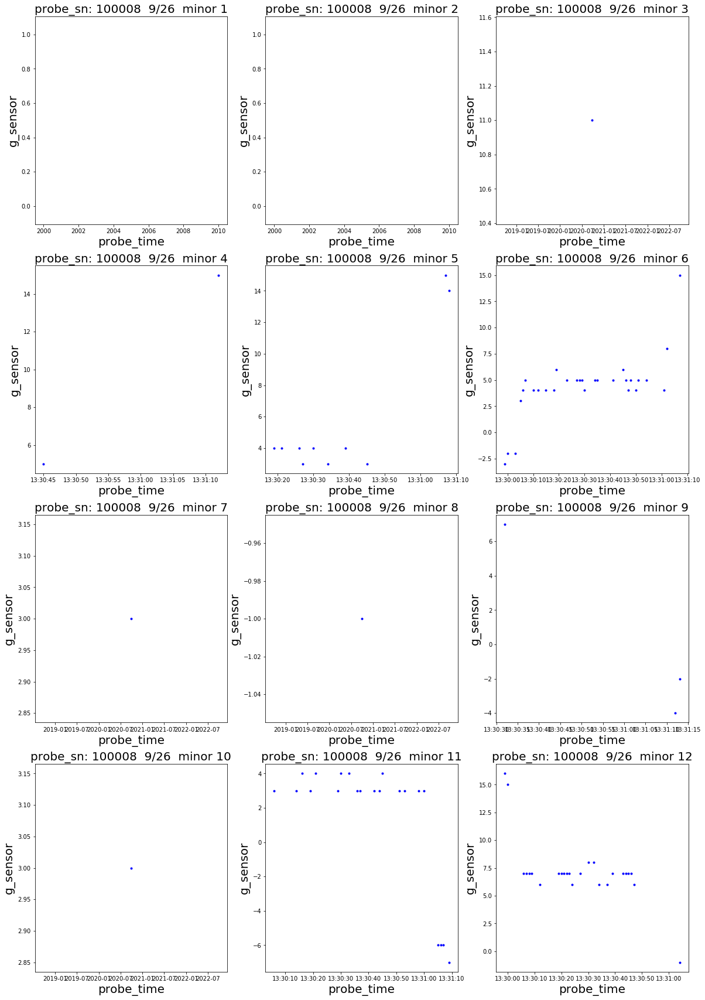

In [172]:
for probe_sn in data1['probe_sn'].unique():
    for probe_hour in data1['probe_time'].dt.hour.unique():
        showScatterAllMinor(probe_sn, probe_hour, 26)

## 映射到高维空间

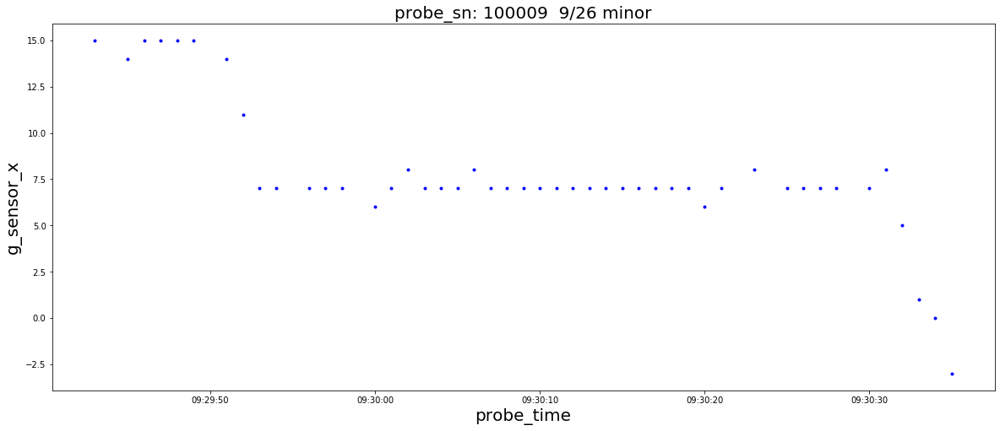

In [131]:
probe = showMinorScatter()

In [132]:
probe

,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time
31097,100009,2001,12,-85,15,94,0,2020-09-26 09:29:43,2020-09-26 09:29:45
31102,100009,2001,12,-74,14,95,0,2020-09-26 09:29:45,2020-09-26 09:29:47
31106,100009,2001,12,-77,15,95,0,2020-09-26 09:29:46,2020-09-26 09:29:48
31110,100009,2001,12,-80,15,96,0,2020-09-26 09:29:47,2020-09-26 09:29:49
31116,100009,2001,12,-86,15,95,0,2020-09-26 09:29:48,2020-09-26 09:29:50
31119,100009,2001,12,-74,15,95,0,2020-09-26 09:29:49,2020-09-26 09:29:51
31125,100009,2001,12,-72,14,95,0,2020-09-26 09:29:51,2020-09-26 09:29:53
31128,100009,2001,12,-82,11,94,0,2020-09-26 09:29:52,2020-09-26 09:29:54
31135,100009,2001,12,-83,7,95,0,2020-09-26 09:29:53,2020-09-26 09:29:55
31146,100009,2001,12,-71,7,96,0,2020-09-26 09:29:54,2020-09-26 09:29:56


In [381]:
g_sensor_x = probe['g_sensor_x']
MEAN = g_sensor_x.mean()
STD = g_sensor_x.std()

In [382]:
probe['g_sensor_x_scale'] = g_sensor_x.apply(lambda x: (x-MEAN)/STD)

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [385]:
probe['1'] = probe['g_sensor_x'].shift(1)
probe

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time,g_sensor_x_scale,1
31097,100009,2001,12,-85,15,94,0,2020-09-26 09:29:43,2020-09-26 09:29:45,1.978614,NaN
31102,100009,2001,12,-74,14,95,0,2020-09-26 09:29:45,2020-09-26 09:29:47,1.705292,15.0
31106,100009,2001,12,-77,15,95,0,2020-09-26 09:29:46,2020-09-26 09:29:48,1.978614,14.0
31110,100009,2001,12,-80,15,96,0,2020-09-26 09:29:47,2020-09-26 09:29:49,1.978614,15.0
31116,100009,2001,12,-86,15,95,0,2020-09-26 09:29:48,2020-09-26 09:29:50,1.978614,15.0
31119,100009,2001,12,-74,15,95,0,2020-09-26 09:29:49,2020-09-26 09:29:51,1.978614,15.0
31125,100009,2001,12,-72,14,95,0,2020-09-26 09:29:51,2020-09-26 09:29:53,1.705292,15.0
31128,100009,2001,12,-82,11,94,0,2020-09-26 09:29:52,2020-09-26 09:29:54,0.885326,14.0
31135,100009,2001,12,-83,7,95,0,2020-09-26 09:29:53,2020-09-26 09:29:55,-0.207962,11.0
31146,100009,2001,12,-71,7,96,0,2020-09-26 09:29:54,2020-09-26 09:29:56,-0.207962,7.0


In [98]:
def showPlotDelta(minor=12, probe_sn=100009, probe_hour=9, probe_day=26):
#     plt.figure(figsize=(20,8))
    probe = data1[(data1['probe_sn'] == probe_sn) & (data1['probe_time'].dt.hour == probe_hour) & 
                  (data1['probe_time'].dt.day == probe_day) & (data1['minor'] == minor)]
    g_sensor_x = probe['g_sensor_x']
    MEAN = g_sensor_x.mean()
    STD = g_sensor_x.std()
    probe['g_sensor_x_scale'] = g_sensor_x.apply(lambda x: (x-MEAN)/STD)
    probe['g_sensor_x_scale1'] = probe['g_sensor_x_scale'].shift(1)
    probe['delta_g_sensor_x'] = probe['g_sensor_x_scale'] - probe['g_sensor_x_scale1']
    plt.scatter(probe['g_sensor_x_scale'], probe['delta_g_sensor_x'])
#     plt.plot(probe['g_sensor_x_scale'], probe['delta_g_sensor_x'])
#     plt.plot_date(probe['probe_time'], probe['delta_g_sensor_x'], fmt='b.')
    plt.xlabel('g_sensor_x_scale', fontsize=20)
    plt.ylabel('delta_g_sensor_x', fontsize=20)
    plt.title('probe_sn: {}  9/{}  minor {}'.format(probe_sn, probe_day, minor), fontsize=20)
#     return probe

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the doc

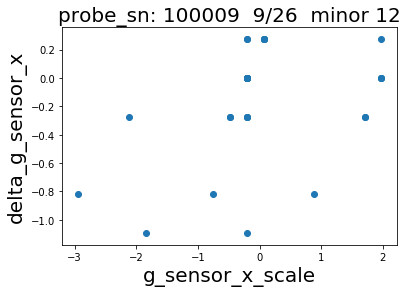

In [99]:
showPlotDelta()

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the doc

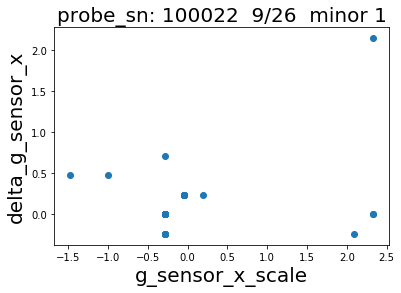

In [409]:
showPlotDelta(1, 100022)

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the doc

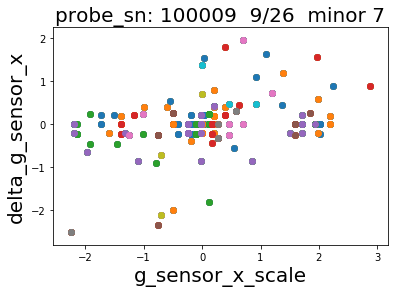

In [126]:
for probe_hour in data1['probe_time'].dt.hour.unique():
        for probe_minor in data1['minor'].unique():
            showPlotDelta(probe_minor, 100009, 8)

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the doc

ZeroDivisionError: float division by zero

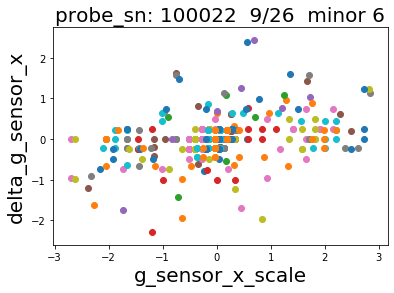

In [100]:
for probe_sn in data1['probe_sn'].unique():
    for probe_hour in data1['probe_time'].dt.hour.unique():
        for probe_minor in data1['minor'].unique():
            showPlotDelta(probe_minor, probe_sn, probe_hour)

In [397]:
def showTwoPlotDelta(minor1=12, minor2=6, probe_sn=100009, probe_hour=9, probe_day=26):
#     plt.figure(figsize=(20,8))
    probe1 = data1[(data1['probe_sn'] == probe_sn) & (data1['probe_time'].dt.hour == probe_hour) & 
                  (data1['probe_time'].dt.day == probe_day) & (data1['minor'] == minor1)]
    probe2 = data1[(data1['probe_sn'] == probe_sn) & (data1['probe_time'].dt.hour == probe_hour) & 
                  (data1['probe_time'].dt.day == probe_day) & (data1['minor'] == minor2)]
    g_sensor_x1 = probe1['g_sensor_x']
    MEAN1 = g_sensor_x1.mean()
    STD1 = g_sensor_x1.std()
    probe1['g_sensor_x_scale'] = g_sensor_x1.apply(lambda x: (x-MEAN1)/STD1)
    probe1['g_sensor_x_scale1'] = probe1['g_sensor_x_scale'].shift(1)
    probe1['delta_g_sensor_x'] = probe1['g_sensor_x_scale'] - probe1['g_sensor_x_scale1']
#     plt.scatter(probe['g_sensor_x_scale'], probe['delta_g_sensor_x'])
#     plt.plot(probe['g_sensor_x_scale'], probe['delta_g_sensor_x'])
    plt.plot_date(probe1['probe_time'], probe1['delta_g_sensor_x'], c='b')
    g_sensor_x2 = probe2['g_sensor_x']
    MEAN2 = g_sensor_x2.mean()
    STD2 = g_sensor_x2.std()
    probe2['g_sensor_x_scale'] = g_sensor_x2.apply(lambda x: (x-MEAN2)/STD2)
    probe2['g_sensor_x_scale1'] = probe2['g_sensor_x_scale'].shift(1)
    probe2['delta_g_sensor_x'] = probe2['g_sensor_x_scale'] - probe2['g_sensor_x_scale1']
#     plt.scatter(probe['g_sensor_x_scale'], probe['delta_g_sensor_x'])
#     plt.plot(probe['g_sensor_x_scale'], probe['delta_g_sensor_x'])
#     plt.plot_date(probe2['probe_time'], probe2['delta_g_sensor_x'], c='r')
#     plt.plot_date(probe2['probe_time'], probe2['delta_g_sensor_x'], c='r')
    plt.plot_date(probe2['probe_time'], probe2['delta_g_sensor_x'], c='r')
    plt.xlabel('probe_time', fontsize=20)
    plt.ylabel('delta_g_sensor_x', fontsize=20)
    plt.title('probe_sn: {}  9/{}  minor {} and {}'.format(probe_sn, probe_day, minor1, minor2), fontsize=20)
    plt.show()
#     return probe

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
T

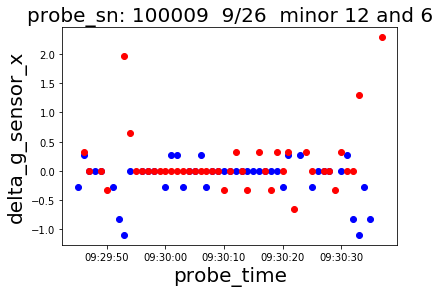

In [398]:
showTwoPlotDelta()

In [29]:
def showAbsTwoPlotDelta(minor1=12, minor2=6, probe_sn=100009, probe_hour=9, probe_day=26):
#     plt.figure(figsize=(20,8))
    probe1 = data1[(data1['probe_sn'] == probe_sn) & (data1['probe_time'].dt.hour == probe_hour) & 
                  (data1['probe_time'].dt.day == probe_day) & (data1['minor'] == minor1)]
    probe2 = data1[(data1['probe_sn'] == probe_sn) & (data1['probe_time'].dt.hour == probe_hour) & 
                  (data1['probe_time'].dt.day == probe_day) & (data1['minor'] == minor2)]
    g_sensor_x1 = probe1['g_sensor_x']
    MEAN1 = g_sensor_x1.mean()
    STD1 = g_sensor_x1.std()
    probe1['g_sensor_x_scale'] = g_sensor_x1.apply(lambda x: (x-MEAN1)/STD1)
    probe1['g_sensor_x_scale1'] = probe1['g_sensor_x_scale'].shift(1)
    probe1['delta_g_sensor_x'] = probe1['g_sensor_x_scale'] - probe1['g_sensor_x_scale1']
#     plt.scatter(probe['g_sensor_x_scale'], probe['delta_g_sensor_x'])
#     plt.plot(probe['g_sensor_x_scale'], probe['delta_g_sensor_x'])
    plt.plot_date(probe1['probe_time'], abs(probe1['delta_g_sensor_x']), c='b')
    g_sensor_x2 = probe2['g_sensor_x']
    MEAN2 = g_sensor_x2.mean()
    STD2 = g_sensor_x2.std()
    probe2['g_sensor_x_scale'] = g_sensor_x2.apply(lambda x: (x-MEAN2)/STD2)
    probe2['g_sensor_x_scale1'] = probe2['g_sensor_x_scale'].shift(1)
    probe2['delta_g_sensor_x'] = probe2['g_sensor_x_scale'] - probe2['g_sensor_x_scale1']
#     plt.scatter(probe['g_sensor_x_scale'], probe['delta_g_sensor_x'])
#     plt.plot(probe['g_sensor_x_scale'], probe['delta_g_sensor_x'])
#     plt.plot_date(probe2['probe_time'], probe2['delta_g_sensor_x'], c='r')
#     plt.plot_date(probe2['probe_time'], probe2['delta_g_sensor_x'], c='r')
    plt.plot_date(probe2['probe_time'], abs(probe2['delta_g_sensor_x']), c='r')
    plt.xlabel('g_sensor_x_scale', fontsize=20)
    plt.ylabel('delta_g_sensor_x', fontsize=20)
    plt.title('probe_sn: {}  /{}  minor {} and {}'.format(probe_sn, probe_day, minor1, minor2), fontsize=20)
    plt.show()
#     return probe

In [399]:
def showAbsTwoPlotDelta(minor1=12, minor2=6, probe_sn=100009, probe_hour=9, probe_day=26):
#     plt.figure(figsize=(20,8))
    probe1 = data1[(data1['probe_sn'] == probe_sn) & (data1['probe_time'].dt.hour == probe_hour) & 
                  (data1['probe_time'].dt.day == probe_day) & (data1['minor'] == minor1)]
    probe2 = data1[(data1['probe_sn'] == probe_sn) & (data1['probe_time'].dt.hour == probe_hour) & 
                  (data1['probe_time'].dt.day == probe_day) & (data1['minor'] == minor2)]
    g_sensor_x1 = probe1['g_sensor_x']
    MEAN1 = g_sensor_x1.mean()
    STD1 = g_sensor_x1.std()
    probe1['g_sensor_x_scale'] = g_sensor_x1.apply(lambda x: (x-MEAN1)/STD1)
    probe1['g_sensor_x_scale1'] = probe1['g_sensor_x_scale'].shift(1)
    probe1['delta_g_sensor_x'] = probe1['g_sensor_x_scale'] - probe1['g_sensor_x_scale1']
#     plt.scatter(probe['g_sensor_x_scale'], probe['delta_g_sensor_x'])
#     plt.plot(probe['g_sensor_x_scale'], probe['delta_g_sensor_x'])
    plt.plot_date(probe1['probe_time'], abs(probe1['delta_g_sensor_x']), c='b')
    g_sensor_x2 = probe2['g_sensor_x']
    MEAN2 = g_sensor_x2.mean()
    STD2 = g_sensor_x2.std()
    probe2['g_sensor_x_scale'] = g_sensor_x2.apply(lambda x: (x-MEAN2)/STD2)
    probe2['g_sensor_x_scale1'] = probe2['g_sensor_x_scale'].shift(1)
    probe2['delta_g_sensor_x'] = probe2['g_sensor_x_scale'] - probe2['g_sensor_x_scale1']
#     plt.scatter(probe['g_sensor_x_scale'], probe['delta_g_sensor_x'])
#     plt.plot(probe['g_sensor_x_scale'], probe['delta_g_sensor_x'])
#     plt.plot_date(probe2['probe_time'], probe2['delta_g_sensor_x'], c='r')
#     plt.plot_date(probe2['probe_time'], probe2['delta_g_sensor_x'], c='r')
    plt.plot_date(probe2['probe_time'], abs(probe2['delta_g_sensor_x']), c='r')
    plt.xlabel('probe_time', fontsize=20)
    plt.ylabel('delta_g_sensor_x', fontsize=20)
    plt.title('probe_sn: {}  9/{}  minor {} and {}'.format(probe_sn, probe_day, minor1, minor2), fontsize=20)
    plt.show()
#     return probe

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
T

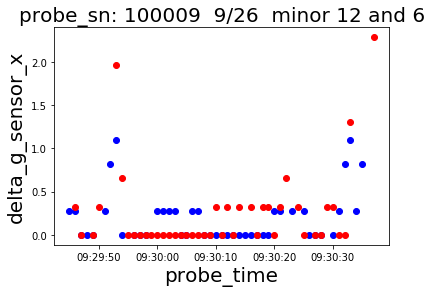

In [400]:
showAbsTwoPlotDelta()

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
T

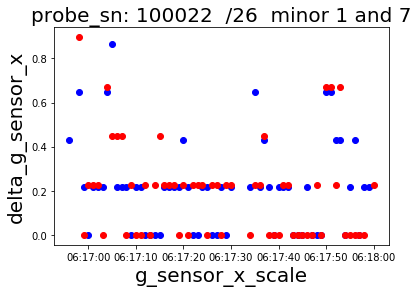

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
T

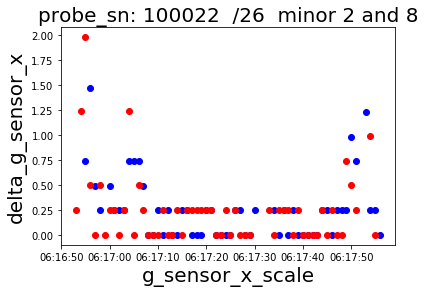

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
T

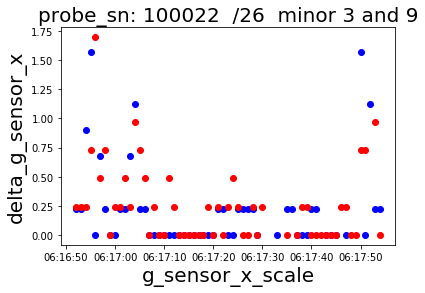

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
T

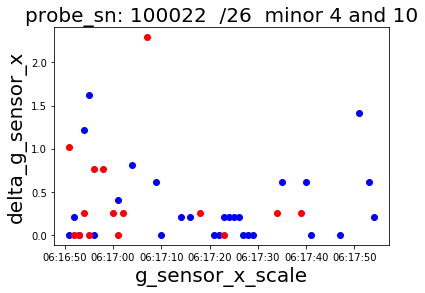

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
T

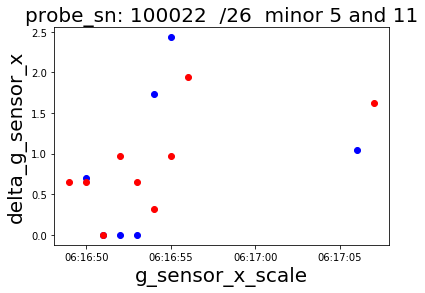

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
T

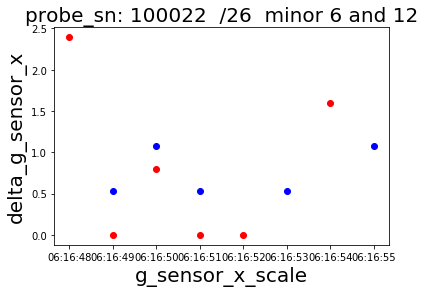

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
T

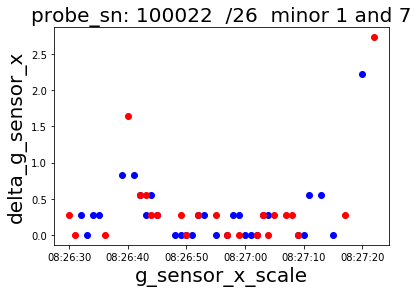

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
T

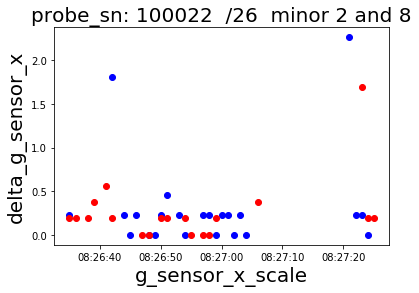

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
T

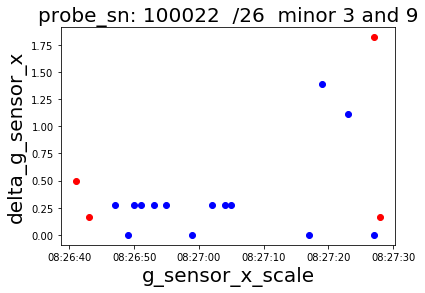

ZeroDivisionError: float division by zero

In [31]:
for probe_sn in data1['probe_sn'].unique():
    for probe_hour in data1['probe_time'].dt.hour.unique():
        for i in range(1, 7):
            showAbsTwoPlotDelta(i, i+6, probe_sn, probe_hour, 26)

In [64]:
array1 = data1['g_sensor_x'][(data1['probe_sn']==100009) & (data1['probe_time'].dt.hour==9) & 
                    (data1['probe_time'].dt.day==26) & ((data1['minor']==12))].values

In [89]:
array1

array([15, 14, 15, 15, 15, 15, 14, 11,  7,  7,  7,  7,  7,  6,  7,  8,  7,
        7,  7,  8,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  6,
        7,  8,  7,  7,  7,  7,  7,  8,  5,  1,  0, -3], dtype=int64)

In [75]:
len(array1)

46

## 处理实时传来的数据的函数

In [87]:
array2 = []
for i in range(len(array1)):
    array2.append(array1[i])
array2

[15,
 14,
 15,
 15,
 15,
 15,
 14,
 11,
 7,
 7,
 7,
 7,
 7,
 6,
 7,
 8,
 7,
 7,
 7,
 8,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 6,
 7,
 8,
 7,
 7,
 7,
 7,
 7,
 8,
 5,
 1,
 0,
 -3]

## 方法一：直接判断，根据大于小于0，大于小于10来判断

In [101]:
# 方法一
def judgeStartAndStopState(array, i, state):
    if i == 0:
        return
#     if state[i-1] == 1 and array[i-1] < 10 and array[i] >= 10:
#         state[i] = 0 
#     if state[i-1] == 0 and array[i] > 0 and abs(array[i] - array[i-1]) <= 3:
#         state[i] = 0
#     if state[i-1] == 0 and array[i] < 0:
#         state[i] = 1
#     if state[i-1] == 1 and array[i] < 0:
#         state[i] = 1
    if array[i] >= 0 and array[i] <= 10:
        state[i] = 0
    return state


In [95]:
array2 = []
state = np.ones(shape=array1.shape)
for i in range(len(array1)):
    state1 = judgeStartAndStopState(array1, i, state)
print(state1)

[1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1.]


In [94]:
array1

array([15, 14, 15, 15, 15, 15, 14, 11,  7,  7,  7,  7,  7,  6,  7,  8,  7,
        7,  7,  8,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  6,
        7,  8,  7,  7,  7,  7,  7,  8,  5,  1,  0, -3], dtype=int64)

In [96]:
def showState(minor=12, probe_sn=100009, probe_hour=9, probe_day=26):
    array1 = data1['g_sensor_x'][(data1['probe_sn']==probe_sn) & (data1['probe_time'].dt.hour==probe_hour) & 
                    (data1['probe_time'].dt.day==probe_day) & ((data1['minor']==minor))].values
    print(array1)
    array2 = []
    state = np.ones(shape=array1.shape)
    for i in range(len(array1)):
        state1 = judgeStartAndStopState(array1, i, state)
    print(state1)

In [102]:
for probe_sn in data1['probe_sn'].unique():
    for probe_hour in data1['probe_time'].dt.hour.unique():
        for i in range(1, 13):
            showState(i, probe_sn, probe_hour, 26)

[-3 -1 -4 -5 -5 -6 -5 -4 -1  3  4  3  4  4  3  4  4  4  4  4  3  4  3  4
  2  3  3  3  4  3  3  3  4  4  3  2  5  4  2  3  3  2  3  4  4  4  4  3
  3  3  3  6  9 11 13 13 12 14 14 13 14]
[1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1.]
[-2 -5  1 -1 -2 -4 -3 -4 -3  0  3  6  4  4  4  5  5  4  4  4  3  4  4  4
  4  5  4  4  4  4  4  3  4  4  4  5  4  4  3  3  4  4  4  4  4  4  5  4
  4  3  4  3  7 10 15 14 15 15]
[1. 1. 0. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 1. 1. 1. 1.]
[ -5  -6  -7 -11  -4  -4  -7  -8  -8  -8  -7  -8  -5   0   1   0   0   0
   0   0   0   0   0   0   0   0   0   0   0   0   1   0   0   0   1   0
   1   0   0   0   1   0   0   0   0   1   0   0   0   0   0   7   7  12
  11  10]
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

UnboundLocalError: local variable 'state1' referenced before assignment

## 方法二：一边根据传过来的实时数据的平均值判断，一边根据大于0还是小于0来判断

In [108]:
myArray2 = []
flag = 0
for i in range(len(array1)):
    if i == 0:
        avg = array1[i]
        myArray2.append(avg)
    else:
        avg = (myArray2[i-1]*i + array1[i]) / (i+1)
        myArray2.append(avg)
    if abs(myArray2[i] - myArray2[i-1]) > 0.5 and flag == 0:
        print(i)
        flag = 1
myArray2

8


[15,
 14.5,
 14.666666666666666,
 14.75,
 14.8,
 14.833333333333334,
 14.714285714285714,
 14.25,
 13.444444444444445,
 12.8,
 12.272727272727273,
 11.833333333333334,
 11.461538461538462,
 11.071428571428571,
 10.8,
 10.625,
 10.411764705882353,
 10.222222222222221,
 10.052631578947368,
 9.95,
 9.80952380952381,
 9.681818181818182,
 9.565217391304348,
 9.458333333333334,
 9.36,
 9.26923076923077,
 9.185185185185187,
 9.10714285714286,
 9.034482758620692,
 8.966666666666669,
 8.903225806451614,
 8.843750000000002,
 8.787878787878789,
 8.705882352941178,
 8.657142857142858,
 8.638888888888891,
 8.594594594594597,
 8.55263157894737,
 8.512820512820515,
 8.475000000000001,
 8.439024390243905,
 8.42857142857143,
 8.348837209302328,
 8.181818181818185,
 8.000000000000004,
 7.760869565217395]

In [118]:
def showState(minor=12, probe_sn=100009, probe_hour=9, probe_day=26):
    array1 = data1['g_sensor_x'][(data1['probe_sn']==probe_sn) & (data1['probe_time'].dt.hour==probe_hour) & 
                    (data1['probe_time'].dt.day==probe_day) & ((data1['minor']==minor))].values
    print(array1)
    myArray2 = []
    flag = 0
    for i in range(len(array1)):
        if i == 0:
            avg = array1[i]
            myArray2.append(avg)
        else:
            avg = (myArray2[i-1]*i + array1[i]) / (i+1)
            myArray2.append(avg)
        if abs(myArray2[i] - myArray2[i-1]) > 0.5 and flag == 0:
            print("这里是停止时间"+str(i))
            flag = 1
    print(myArray2)
    plt.plot([i for i in range(len(myArray2))], myArray2)
    plt.scatter([i for i in range(len(myArray2))], myArray2)

[15 14 15 15 15 15 14 11  7  7  7  7  7  6  7  8  7  7  7  8  7  7  7  7
  7  7  7  7  7  7  7  7  7  6  7  8  7  7  7  7  7  8  5  1  0 -3]
这里是停止时间8
[15, 14.5, 14.666666666666666, 14.75, 14.8, 14.833333333333334, 14.714285714285714, 14.25, 13.444444444444445, 12.8, 12.272727272727273, 11.833333333333334, 11.461538461538462, 11.071428571428571, 10.8, 10.625, 10.411764705882353, 10.222222222222221, 10.052631578947368, 9.95, 9.80952380952381, 9.681818181818182, 9.565217391304348, 9.458333333333334, 9.36, 9.26923076923077, 9.185185185185187, 9.10714285714286, 9.034482758620692, 8.966666666666669, 8.903225806451614, 8.843750000000002, 8.787878787878789, 8.705882352941178, 8.657142857142858, 8.638888888888891, 8.594594594594597, 8.55263157894737, 8.512820512820515, 8.475000000000001, 8.439024390243905, 8.42857142857143, 8.348837209302328, 8.181818181818185, 8.000000000000004, 7.760869565217395]


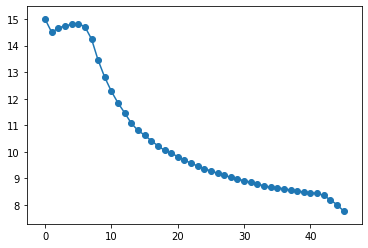

In [119]:
showState()

[-3 -1 -4 -5 -5 -6 -5 -4 -1  3  4  3  4  4  3  4  4  4  4  4  3  4  3  4
  2  3  3  3  4  3  3  3  4  4  3  2  5  4  2  3  3  2  3  4  4  4  4  3
  3  3  3  6  9 11 13 13 12 14 14 13 14]
这里是停止时间1
[-3, -2.0, -2.6666666666666665, -3.25, -3.6, -4.0, -4.142857142857143, -4.125, -3.7777777777777777, -3.1, -2.4545454545454546, -2.0, -1.5384615384615385, -1.1428571428571428, -0.8666666666666667, -0.5625, -0.29411764705882354, -0.05555555555555555, 0.15789473684210525, 0.35, 0.47619047619047616, 0.6363636363636364, 0.7391304347826086, 0.875, 0.92, 1.0, 1.0740740740740742, 1.1428571428571428, 1.2413793103448276, 1.3, 1.3548387096774193, 1.40625, 1.4848484848484849, 1.5588235294117647, 1.6, 1.6111111111111112, 1.7027027027027026, 1.763157894736842, 1.7692307692307692, 1.8, 1.829268292682927, 1.8333333333333333, 1.8604651162790697, 1.9090909090909092, 1.9555555555555555, 2.0, 2.0425531914893615, 2.0624999999999996, 2.0816326530612237, 2.099999999999999, 2.1176470588235285, 2.1923076923076916, 2.3

[ 5  6  6 -3]
这里是停止时间3
[5, 5.5, 5.666666666666667, 3.5]
[-6 -5 -4  0]
这里是停止时间3
[-6, -5.5, -5.0, -3.75]
[-4 -3  1  2]
这里是停止时间2
[-4, -3.5, -2.0, -1.0]
[-2 -2 -2 -2 -2 -3 -1  1  5  5  5  5  4  5  5  5  4  5  5  5  5  6  7  5
  6  6  5  6  5  5  4  5  5  5  5  5  5  4  5 14 15]
这里是停止时间8
[-2, -2.0, -2.0, -2.0, -2.0, -2.1666666666666665, -2.0, -1.625, -0.8888888888888888, -0.3, 0.18181818181818182, 0.5833333333333334, 0.8461538461538461, 1.1428571428571428, 1.4, 1.625, 1.7647058823529411, 1.9444444444444444, 2.1052631578947367, 2.25, 2.380952380952381, 2.5454545454545454, 2.739130434782609, 2.8333333333333335, 2.96, 3.076923076923077, 3.1481481481481484, 3.25, 3.310344827586207, 3.3666666666666667, 3.3870967741935485, 3.4375, 3.484848484848485, 3.5294117647058822, 3.5714285714285716, 3.611111111111111, 3.6486486486486487, 3.6578947368421053, 3.6923076923076925, 3.95, 4.219512195121951]
[-5 -4 -5 -3 -2  2  3  2  2  3  3  2  2  3  2  2  3  3  2  3  2  2  2  3
  3  1  4  3  3  2  3  3  3  2  2 

  3  3  4  4  4  4  4  4 10 12 15 14 15 15 14]
这里是停止时间2
[-3, -2.5, -1.3333333333333333, -0.25, 0.6, 1.1666666666666667, 1.5714285714285714, 1.75, 2.0, 2.1, 2.272727272727273, 2.416666666666667, 2.4615384615384617, 2.5714285714285716, 2.6666666666666665, 2.75, 2.823529411764706, 2.888888888888889, 2.9473684210526314, 3.0, 3.0476190476190474, 3.0454545454545454, 3.0869565217391304, 3.1666666666666665, 3.16, 3.1538461538461537, 3.185185185185185, 3.2142857142857144, 3.2413793103448274, 3.2666666666666666, 3.2903225806451615, 3.3125, 3.515151515151515, 3.764705882352941, 4.085714285714285, 4.361111111111111, 4.648648648648648, 4.921052631578947, 5.153846153846153]
[-3 -2 -2 -2 -3  3  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  5  4  4
  5  5  4  5  5  4  5  5  6  4  5  5  5  5  4  5  5  5  9 16]
这里是停止时间5
[-3, -2.5, -2.3333333333333335, -2.25, -2.4, -1.5, -0.5714285714285714, 0.125, 0.6666666666666666, 1.1, 1.4545454545454546, 1.75, 2.0, 2.2142857142857144, 2.4, 2.5625, 2.7058823529411766,

  3  2  2  1 -2 -4 -8 -7 -8 -7]
[10, 10.0, 10.0, 10.0, 10.2, 10.166666666666666, 10.142857142857142, 10.0, 10.0, 10.0, 9.818181818181818, 9.333333333333334, 9.0, 8.5, 8.133333333333333, 7.8125, 7.529411764705882, 7.222222222222222, 6.947368421052632, 6.7, 6.476190476190476, 6.2272727272727275, 6.043478260869565, 5.875, 5.72, 5.538461538461538, 5.407407407407407, 5.285714285714286, 5.172413793103448, 5.1, 5.0, 4.90625, 4.818181818181818, 4.735294117647059, 4.6571428571428575, 4.583333333333333, 4.5675675675675675, 4.526315789473684, 4.461538461538462, 4.375, 4.317073170731708, 4.261904761904762, 4.209302325581396, 4.1818181818181825, 4.133333333333334, 4.086956521739131, 4.042553191489362, 3.9791666666666665, 3.9591836734693877, 3.92, 3.8823529411764706, 3.826923076923077, 3.7169811320754715, 3.574074074074074, 3.3636363636363638, 3.1785714285714284, 2.982456140350877, 2.810344827586207]
[15 13 15 15 14 15 15 14 15 10  8  6  7  7  7  7  7  6  6  6  7  7  6  6
  6  7  6  6  7  7  7  7  5

[18 11  8  8]
这里是停止时间1
[18, 14.5, 12.333333333333334, 11.25]
[-3 -3  3  4  4  4  4  4  4  4  3  4  4  3  4  4  3  3  4  4  5  3  4  3
  2  3  4  3  3  3  3  4  4  3  2  4  3  3  7 10 13 13 13 14 14 13]
这里是停止时间2
[-3, -3.0, -1.0, 0.25, 1.0, 1.5, 1.8571428571428572, 2.125, 2.3333333333333335, 2.5, 2.5454545454545454, 2.6666666666666665, 2.769230769230769, 2.7857142857142856, 2.8666666666666667, 2.9375, 2.9411764705882355, 2.9444444444444446, 3.0, 3.05, 3.142857142857143, 3.1363636363636362, 3.1739130434782608, 3.1666666666666665, 3.12, 3.1153846153846154, 3.1481481481481484, 3.142857142857143, 3.1379310344827585, 3.1333333333333333, 3.129032258064516, 3.15625, 3.1818181818181817, 3.176470588235294, 3.142857142857143, 3.1666666666666665, 3.1621621621621623, 3.1578947368421053, 3.2564102564102564, 3.425, 3.658536585365854, 3.880952380952381, 4.093023255813954, 4.318181818181818, 4.533333333333333, 4.717391304347826]
[-2 -3 -3 -3 -3 -2  1  1  5  5  5  4  5  5  4  4  4  5  5  5  5  4  5  4
  

[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[ 7  8  9 10]
[7, 7.5, 8.0, 8.5]
[11 11 12 12 12 13]
[11, 11.0, 11.333333333333334, 11.5, 11.6, 11.833333333333334]
[8 8 7 8 9 9 1]
这里是停止时间6
[8, 8.0, 7.666666666666667, 7.75, 8.0, 8.166666666666666, 7.142857142857143]
[14 14 13 14  6  6  6  6  7  7  6  6  7  6  6  6  7]
这里是停止时间4
[14, 14.0, 13.666666666666666, 13.75, 12.2, 11.166666666666666, 10.428571428571429, 9.875, 9.555555555555555, 9.3, 9.0, 8.75, 8.615384615384615, 8.428571428571429, 8.266666666666667, 8.125, 8.058823529411764]
[12 12 12 12 12 11 12 12  9  5  5  4  4  4  4  4  4  4  4  5  4  4  3  4
  4  4  4  3  4  4  4  4  4  4  4  4  4  4  4  4  4  5  3  4  4  4  4  4
  5  1 -1 -2 -5 -5 -5]
这里是停止时间9
[12, 12.0, 12.0, 12.0, 12.0, 11.833333333333334, 11.857142857142858, 11.875, 11.555555555555555, 10.9, 10.363636363636363, 9.833333333333334, 9.384615384615385, 9.0, 8.666666666666666, 8.375, 8.117647058823529, 7.888888888888889, 7.684210526315789, 7.55, 7.3809523

[8, 4.5, 3.0, 2.25, 1.8, 1.6666666666666667, 1.5714285714285714, 1.375, 1.2222222222222223, 1.1, 1.0, 1.0, 0.9230769230769231, 0.8571428571428571, 0.8666666666666667, 0.8125, 0.23529411764705882, -0.2222222222222222, -0.6842105263157895]
[-6 -4 -3]
这里是停止时间1
[-6, -5.0, -4.333333333333333]
[-6]
[-6]
[0]
[0]
[-2 -3 -3 -2 -2 -2 -2  1  6  5  5  5  6  5  5  5  5  5  6  6  5  5  6  5
  6  5  6  5  6  5  5  6  5  7  5  5  5  4  5  5  4  5  5  6 10 15 15 16
 15]
这里是停止时间8
[-2, -2.5, -2.6666666666666665, -2.5, -2.4, -2.3333333333333335, -2.2857142857142856, -1.875, -1.0, -0.4, 0.09090909090909091, 0.5, 0.9230769230769231, 1.2142857142857142, 1.4666666666666666, 1.6875, 1.8823529411764706, 2.0555555555555554, 2.263157894736842, 2.45, 2.5714285714285716, 2.681818181818182, 2.8260869565217392, 2.9166666666666665, 3.04, 3.1153846153846154, 3.2222222222222223, 3.2857142857142856, 3.3793103448275863, 3.433333333333333, 3.4838709677419355, 3.5625, 3.606060606060606, 3.7058823529411766, 3.742857142857143

[-1 -1 -2]
[-1, -1.0, -1.3333333333333333]
[]
[]
[ 0 -1]
[0, -0.5]
[13 13  8  5  5  5  5  5  5  5  5  5  5  4  6  5  5  6  5  5  5  5  5  5
  5  5  5  5  5  5  5  5  5  5  4  5  5  6  5  5  4  3  0 -3 -5 -4 -5 -5]
这里是停止时间2
[13, 13.0, 11.333333333333334, 9.75, 8.8, 8.166666666666666, 7.714285714285714, 7.375, 7.111111111111111, 6.9, 6.7272727272727275, 6.583333333333333, 6.461538461538462, 6.285714285714286, 6.266666666666667, 6.1875, 6.117647058823529, 6.111111111111111, 6.052631578947368, 6.0, 5.9523809523809526, 5.909090909090909, 5.869565217391305, 5.833333333333333, 5.8, 5.769230769230769, 5.7407407407407405, 5.714285714285714, 5.689655172413793, 5.666666666666667, 5.645161290322581, 5.625, 5.606060606060606, 5.588235294117647, 5.542857142857143, 5.527777777777778, 5.513513513513513, 5.526315789473684, 5.512820512820513, 5.5, 5.463414634146342, 5.404761904761905, 5.27906976744186, 5.09090909090909, 4.866666666666665, 4.67391304347826, 4.468085106382977, 4.270833333333332]
[11 10 10

  4  5  4  4  2 -1 -3 -5 -4 -4 -4 -5]
这里是停止时间6
[13, 13.0, 13.0, 13.0, 13.0, 12.666666666666666, 12.0, 11.0, 10.333333333333334, 9.8, 9.363636363636363, 9.0, 8.692307692307692, 8.357142857142856, 8.2, 7.937499999999999, 7.764705882352941, 7.611111111111111, 7.473684210526316, 7.3, 7.142857142857143, 7.0, 6.913043478260869, 6.791666666666667, 6.68, 6.576923076923077, 6.518518518518518, 6.464285714285714, 6.413793103448276, 6.366666666666666, 6.32258064516129, 6.28125, 6.212121212121212, 6.147058823529412, 6.085714285714285, 6.027777777777778, 5.972972972972973, 5.921052631578948, 5.897435897435898, 5.9, 5.853658536585366, 5.833333333333333, 5.813953488372093, 5.7727272727272725, 5.7555555555555555, 5.717391304347826, 5.702127659574468, 5.666666666666667, 5.63265306122449, 5.62, 5.588235294117647, 5.5576923076923075, 5.490566037735849, 5.37037037037037, 5.218181818181818, 5.035714285714286, 4.87719298245614, 4.724137931034483, 4.576271186440678, 4.416666666666667]
[2 1 0]
[2, 1.5, 1.0]
[-

[0 2]
这里是停止时间1
[0, 1.0]
[]
[]
[-2 -1 -2 -2  0  6  6  5  5  6  6  6  4  6  5  4  5  6  6  5  5  5  5  5
  5  5  6  6  5  6  5  5  5  5]
这里是停止时间5
[-2, -1.5, -1.6666666666666667, -1.75, -1.4, -0.16666666666666666, 0.7142857142857143, 1.25, 1.6666666666666667, 2.1, 2.4545454545454546, 2.75, 2.8461538461538463, 3.0714285714285716, 3.2, 3.25, 3.3529411764705883, 3.5, 3.6315789473684212, 3.7, 3.761904761904762, 3.8181818181818183, 3.869565217391304, 3.9166666666666665, 3.96, 4.0, 4.074074074074074, 4.142857142857143, 4.172413793103448, 4.233333333333333, 4.258064516129032, 4.28125, 4.303030303030303, 4.323529411764706]
[ 3  2  2  2  2  2  3  3  3  3  3  3  2  2  1  3  3  2  4  3  3  3  2  2
  3  2  2 13 13 14 13 13]
[3, 2.5, 2.3333333333333335, 2.25, 2.2, 2.1666666666666665, 2.2857142857142856, 2.375, 2.4444444444444446, 2.5, 2.5454545454545454, 2.5833333333333335, 2.5384615384615383, 2.5, 2.4, 2.4375, 2.4705882352941178, 2.4444444444444446, 2.526315789473684, 2.55, 2.5714285714285716, 2.5909

[-1]
[-1]
[12 13 10  6  5  4  4  5  5  5  6  5  5  5  5  5  5  5  6  4  5  4  5  5
  6  6  5  5  5  5  6  5  5  6  5  5  5  5  5  4  0  0 -5 -5 -5]
这里是停止时间2
[12, 12.5, 11.666666666666666, 10.25, 9.2, 8.333333333333334, 7.714285714285714, 7.375, 7.111111111111111, 6.9, 6.818181818181818, 6.666666666666667, 6.538461538461538, 6.428571428571429, 6.333333333333333, 6.25, 6.176470588235294, 6.111111111111111, 6.105263157894737, 6.0, 5.9523809523809526, 5.863636363636363, 5.826086956521739, 5.791666666666667, 5.8, 5.8076923076923075, 5.777777777777778, 5.75, 5.724137931034483, 5.7, 5.709677419354839, 5.6875, 5.666666666666667, 5.676470588235294, 5.6571428571428575, 5.638888888888889, 5.621621621621622, 5.605263157894737, 5.589743589743589, 5.55, 5.414634146341464, 5.2857142857142865, 5.046511627906978, 4.818181818181819, 4.600000000000001]
[10  9 11 10 10  3  3  2  3  2  3  2  3  3  3  3  2  2  3  3  2  2  3  2
  2  3  2  2  2  2  3  3  3  3  2  1 -3 -7]
这里是停止时间5
[10, 9.5, 10.0, 10.0, 10.0, 

  4  5  5  5  5  5  5  4  4  5  4 -4 -5]
这里是停止时间2
[12, 11.5, 10.333333333333334, 8.75, 7.8, 7.333333333333333, 6.857142857142857, 6.625, 6.444444444444445, 6.3, 6.181818181818182, 6.083333333333333, 6.0, 5.928571428571429, 5.8, 5.75, 5.705882352941177, 5.666666666666667, 5.631578947368421, 5.55, 5.523809523809524, 5.5, 5.434782608695652, 5.416666666666667, 5.36, 5.346153846153846, 5.333333333333333, 5.321428571428571, 5.310344827586207, 5.3, 5.290322580645161, 5.25, 5.212121212121212, 5.205882352941177, 5.171428571428572, 4.916666666666667, 4.648648648648648]
[]
[]
[-3]
[-3]
[-1  0 -1]
[-1, -0.5, -0.6666666666666666]
[-4 -5  3  3  3  4]
这里是停止时间2
[-4, -4.5, -2.0, -0.75, 0.0, 0.6666666666666666]
[-5 -4 -4  4  2  3  4  4  3  3  3  4  3  3  3  3  3  3  3  2  4  4  4  3
  4  4  3  3  3  4  3  4 14]
这里是停止时间3
[-5, -4.5, -4.333333333333333, -2.25, -1.4, -0.6666666666666666, 0.0, 0.5, 0.7777777777777778, 1.0, 1.1818181818181819, 1.4166666666666667, 1.5384615384615385, 1.6428571428571428, 1.7333

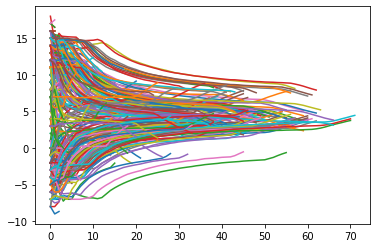

In [116]:
for probe_sn in data1['probe_sn'].unique():
    for probe_hour in data1['probe_time'].dt.hour.unique():
        for i in range(1, 13):
            showState(i, probe_sn, probe_hour, 26)

In [120]:
data1

,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time
26546,100022,2001,12,-73,10,96,0,2020-09-26 06:16:47,2020-09-26 06:16:51
26547,100022,2001,11,-79,12,89,0,2020-09-26 06:16:48,2020-09-26 06:16:51
26548,100022,2001,12,-55,16,96,0,2020-09-26 06:16:48,2020-09-26 06:16:52
26549,100022,2001,6,-74,-5,91,2,2020-09-26 06:16:48,2020-09-26 06:16:52
26550,100022,2001,11,-64,14,91,0,2020-09-26 06:16:49,2020-09-26 06:16:52
...,...,...,...,...,...,...,...,...,...
35658,100016,2001,1,-70,14,91,0,2020-09-26 13:31:06,2020-09-26 13:31:27
35659,100016,2001,1,-68,15,91,1,2020-09-26 13:31:07,2020-09-26 13:31:27
35660,100016,2001,7,-79,-5,91,-2,2020-09-26 13:31:08,2020-09-26 13:31:27
35661,100016,2001,1,-79,14,92,1,2020-09-26 13:31:08,2020-09-26 13:31:27


In [183]:
pd.options.display.max_columns = None
pd.options.display.max_rows = None
data1['g_sensor_x'].groupby([data1['probe_sn'], data1['minor'], data1['probe_time']]).mean()

probe_sn  minor  probe_time         
100008    1      2020-09-26 06:38:35    12
                 2020-09-26 06:38:36     9
                 2020-09-26 06:38:37     6
                 2020-09-26 06:38:38     4
                 2020-09-26 06:38:39     5
                 2020-09-26 06:38:40     4
                 2020-09-26 08:05:34     8
                 2020-09-26 08:05:35     9
                 2020-09-26 08:05:36    10
                 2020-09-26 09:51:15     5
                 2020-09-26 11:45:38     7
                 2020-09-26 11:45:39     7
          2      2020-09-26 06:38:35    14
                 2020-09-26 06:38:36    10
                 2020-09-26 06:38:37     9
                 2020-09-26 06:38:38     6
                 2020-09-26 08:05:35    10
                 2020-09-26 08:05:36    11
                 2020-09-26 09:51:13    10
                 2020-09-26 09:51:14     8
                 2020-09-26 11:45:40    11
                 2020-09-26 11:45:41    11
                 

In [122]:
data1

,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time
26546,100022,2001,12,-73,10,96,0,2020-09-26 06:16:47,2020-09-26 06:16:51
26547,100022,2001,11,-79,12,89,0,2020-09-26 06:16:48,2020-09-26 06:16:51
26548,100022,2001,12,-55,16,96,0,2020-09-26 06:16:48,2020-09-26 06:16:52
26549,100022,2001,6,-74,-5,91,2,2020-09-26 06:16:48,2020-09-26 06:16:52
26550,100022,2001,11,-64,14,91,0,2020-09-26 06:16:49,2020-09-26 06:16:52
...,...,...,...,...,...,...,...,...,...
35658,100016,2001,1,-70,14,91,0,2020-09-26 13:31:06,2020-09-26 13:31:27
35659,100016,2001,1,-68,15,91,1,2020-09-26 13:31:07,2020-09-26 13:31:27
35660,100016,2001,7,-79,-5,91,-2,2020-09-26 13:31:08,2020-09-26 13:31:27
35661,100016,2001,1,-79,14,92,1,2020-09-26 13:31:08,2020-09-26 13:31:27


In [ ]:
data2 = data1['g_sensor_x'][(data1['probe_sn']==probe_sn) & (data1['probe_time'].dt.hour==probe_hour) & 
                    (data1['probe_time'].dt.day==probe_day) & ((data1['minor']==minor))]

In [407]:
def showPlotDeltaAbs(minor=12, probe_sn=100009, probe_hour=9, probe_day=26):
#     plt.figure(figsize=(20,8))
    probe = data1[(data1['probe_sn'] == probe_sn) & (data1['probe_time'].dt.hour == probe_hour) & 
                  (data1['probe_time'].dt.day == probe_day) & (data1['minor'] == minor)]
    g_sensor_x = probe['g_sensor_x']
    MEAN = g_sensor_x.mean()
    probe['delta_g_sensor_x'] = probe['g_sensor_x'] - probe['g_sensor_x'].shift(1)
    probe['g_sensor_x1'] = probe['g_sensor_x'] - MEAN
#     plt.plot_date(probe['probe_time'], probe['g_sensor_x1'], fmt='b.')
#     plt.show()
#     plt.scatter(abs(probe['g_sensor_x1']), abs(probe['delta_g_sensor_x']))
    plt.scatter(probe['g_sensor_x1'], probe['delta_g_sensor_x'])

    
    # ================================minor2minor2minor2minor2minor2=============================================
#     probe2 = data1[(data1['probe_sn'] == probe_sn) & (data1['probe_time'].dt.hour == probe_hour) & 
#                   (data1['probe_time'].dt.day == probe_day) & (data1['minor'] == minor2)]
#     g_sensor_x2 = probe2['g_sensor_x']
#     MEAN2 = g_sensor_x2.mean()
#     print(MEAN2)
# #     STD = g_sensor_x.std()
# #     probe['g_sensor_x_scale'] = g_sensor_x.apply(lambda x: (x-MEAN)/STD)
# #     probe['g_sensor_x_scale1'] = probe['g_sensor_x_scale'].shift(1)
# #     probe['delta_g_sensor_x'] = probe['g_sensor_x_scale'] - probe['g_sensor_x_scale1']
# #     plt.scatter(abs(probe['g_sensor_x_scale']), abs(probe['delta_g_sensor_x']))

# #     probe['g_sensor_x1'] = probe['g_sensor_x'].shift(1)
#     probe2['delta_g_sensor_x'] = probe2['g_sensor_x'] - probe2['g_sensor_x'].shift(1)
#     probe2['g_sensor_x1'] = probe2['g_sensor_x'] - MEAN2
#     plt.scatter(abs(probe2['g_sensor_x1']), abs(probe2['delta_g_sensor_x']))
    
#     plt.plot_date(probe['probe_time'], probe['g_sensor_x1'], fmt='b.')
#     plt.plot_date(probe['probe_time'], probe['delta_g_sensor_x'], fmt='b.')
    plt.xlabel('g_sensor_x_scale', fontsize=20)
    plt.ylabel('delta_g_sensor_x', fontsize=20)
    plt.title('probe_sn: {}  9/{}  minor {}'.format(probe_sn, probe_day, minor), fontsize=20)
#     return probe

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time,delta_g_sensor_x,g_sensor_x1
31101,100009,2001,6,-76,-3,93,0,2020-09-26 09:29:45,2020-09-26 09:29:46,NaN,-7.340909
31105,100009,2001,6,-73,-2,93,1,2020-09-26 09:29:46,2020-09-26 09:29:48,1.0,-6.340909
31109,100009,2001,6,-74,-2,93,2,2020-09-26 09:29:47,2020-09-26 09:29:48,0.0,-6.340909
31118,100009,2001,6,-87,-2,93,1,2020-09-26 09:29:49,2020-09-26 09:29:50,0.0,-6.340909
31122,100009,2001,6,-89,-3,93,1,2020-09-26 09:29:50,2020-09-26 09:29:52,-1.0,-7.340909
31134,100009,2001,6,-76,3,93,1,2020-09-26 09:29:53,2020-09-26 09:29:55,6.0,-1.340909
31145,100009,2001,6,-85,5,93,3,2020-09-26 09:29:54,2020-09-26 09:29:56,2.0,0.659091
31151,100009,2001,6,-75,5,93,1,2020-09-26 09:29:55,2020-09-26 09:29:56,0.0,0.659091
31158,100009,2001,6,-74,5,92,1,2020-09-26 09:29:56,2020-09-26 09:29:57,0.0,0.659091
31162,100009,2001,6,-74,5,92,1,2020-09-26 09:29:57,2020-09-26 09:29:58,0.0,0.659091


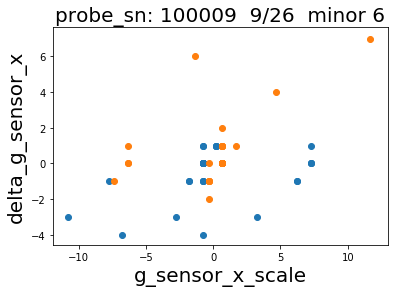

In [408]:
showPlotDeltaAbs(12)
showPlotDeltaAbs(6)

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


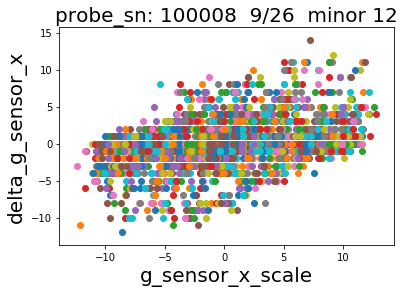

In [403]:
for probe_sn in data1['probe_sn'].unique():
    for probe_hour in data1['probe_time'].dt.hour.unique():
        for i in range(1, 13):
            showPlotDeltaAbs(i, probe_sn, probe_hour, 26)

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


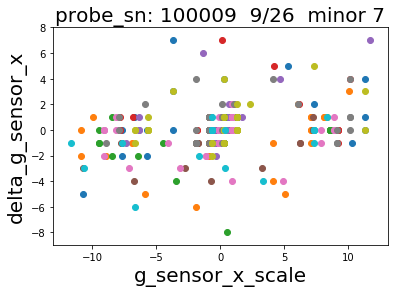

In [404]:
showPlotDeltaAbs(6, 100009, 6, 26)
showPlotDeltaAbs(12, 100009, 6, 26)
showPlotDeltaAbs(6, 100009, 8, 26)
showPlotDeltaAbs(12, 100009, 8, 26)
showPlotDeltaAbs(6, 100009, 9, 26)
showPlotDeltaAbs(12, 100009, 9, 26)
showPlotDeltaAbs(6, 100009, 12, 26)
showPlotDeltaAbs(12, 100009, 12, 26)
showPlotDeltaAbs(6, 100009, 13, 26)
showPlotDeltaAbs(12, 100009, 13, 26)
showPlotDeltaAbs(1, 100009, 20, 26)
showPlotDeltaAbs(7, 100009, 20, 26)
# showPlotDeltaAbs(5, 100009, 6, 26)
# showPlotDeltaAbs(11, 100009, 6, 26)
# showPlotDeltaAbs(5, 100009, 8, 26)
# showPlotDeltaAbs(11, 100009, 8, 26)
# showPlotDeltaAbs(5, 100009, 9, 26)
# showPlotDeltaAbs(11, 100009, 9, 26)
# showPlotDeltaAbs(5, 100009, 12, 26)
# showPlotDeltaAbs(11, 100009, 12, 26)
# showPlotDeltaAbs(5, 100009, 13, 26)
# showPlotDeltaAbs(11, 100009, 13, 26)
# showPlotDeltaAbs(2, 100009, 20, 26)
# showPlotDeltaAbs(8, 100009, 20, 26)

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


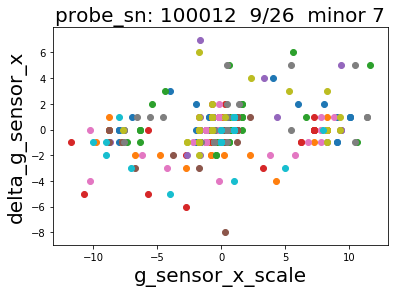

In [405]:
probe_sn = 100012
showPlotDeltaAbs(1, probe_sn, 6, 26)
showPlotDeltaAbs(7, probe_sn, 6, 26)
showPlotDeltaAbs(7, probe_sn, 8, 26)
showPlotDeltaAbs(1, probe_sn, 8, 26)
showPlotDeltaAbs(1, probe_sn, 9, 26)
showPlotDeltaAbs(7, probe_sn, 9, 26)
showPlotDeltaAbs(1, probe_sn, 12, 26)
showPlotDeltaAbs(7, probe_sn, 12, 26)
showPlotDeltaAbs(1, probe_sn, 13, 26)
showPlotDeltaAbs(7, probe_sn, 13, 26)

D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
D:\software\anaconda\install\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


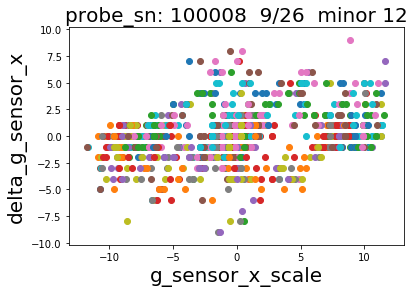

In [406]:
showPlotDeltaAbs(6, 100009, 6, 26)
showPlotDeltaAbs(12, 100009, 6, 26)
showPlotDeltaAbs(6, 100009, 8, 26)
showPlotDeltaAbs(12, 100009, 8, 26)
showPlotDeltaAbs(6, 100009, 9, 26)
showPlotDeltaAbs(12, 100009, 9, 26)
showPlotDeltaAbs(6, 100009, 12, 26)
showPlotDeltaAbs(12, 100009, 12, 26)
showPlotDeltaAbs(6, 100009, 13, 26)
showPlotDeltaAbs(12, 100009, 13, 26)
showPlotDeltaAbs(1, 100009, 20, 26)
showPlotDeltaAbs(7, 100009, 20, 26)

probe_sn = 100012
showPlotDeltaAbs(1, probe_sn, 6, 26)
showPlotDeltaAbs(7, probe_sn, 6, 26)
showPlotDeltaAbs(7, probe_sn, 8, 26)
showPlotDeltaAbs(1, probe_sn, 8, 26)
showPlotDeltaAbs(1, probe_sn, 9, 26)
showPlotDeltaAbs(7, probe_sn, 9, 26)
showPlotDeltaAbs(1, probe_sn, 12, 26)
showPlotDeltaAbs(7, probe_sn, 12, 26)
showPlotDeltaAbs(1, probe_sn, 13, 26)
showPlotDeltaAbs(7, probe_sn, 13, 26)

probe_sn = 100011
showPlotDeltaAbs(6, probe_sn, 6, 26)
showPlotDeltaAbs(12, probe_sn, 6, 26)
showPlotDeltaAbs(6, probe_sn, 8, 26)
showPlotDeltaAbs(12, probe_sn, 8, 26)
showPlotDeltaAbs(6, probe_sn, 9, 26)
showPlotDeltaAbs(12, probe_sn, 9, 26)
showPlotDeltaAbs(6, probe_sn, 12, 26)
showPlotDeltaAbs(12, probe_sn, 12, 26)
showPlotDeltaAbs(6, probe_sn, 13, 26)
showPlotDeltaAbs(12, probe_sn, 13, 26)

probe_sn = 100014
showPlotDeltaAbs(1, probe_sn, 6, 26)
showPlotDeltaAbs(7, probe_sn, 6, 26)
showPlotDeltaAbs(1, probe_sn, 8, 26)
showPlotDeltaAbs(7, probe_sn, 8, 26)
showPlotDeltaAbs(1, probe_sn, 9, 26)
showPlotDeltaAbs(7, probe_sn, 9, 26)
showPlotDeltaAbs(1, probe_sn, 11, 26)
showPlotDeltaAbs(7, probe_sn, 11, 26)
showPlotDeltaAbs(1, probe_sn, 13, 26)
showPlotDeltaAbs(7, probe_sn, 13, 26)

probe_sn = 100019
showPlotDeltaAbs(6, probe_sn, 6, 26)
showPlotDeltaAbs(12, probe_sn, 6, 26)
showPlotDeltaAbs(6, probe_sn, 8, 26)
showPlotDeltaAbs(12, probe_sn, 8, 26)
showPlotDeltaAbs(6, probe_sn, 9, 26)
showPlotDeltaAbs(12, probe_sn, 9, 26)
showPlotDeltaAbs(6, probe_sn, 11, 26)
showPlotDeltaAbs(12, probe_sn, 11, 26)
showPlotDeltaAbs(6, probe_sn, 13, 26)
showPlotDeltaAbs(12, probe_sn, 13, 26)

probe_sn = 100016
showPlotDeltaAbs(1, probe_sn, 6, 26)
showPlotDeltaAbs(7, probe_sn, 6, 26)
showPlotDeltaAbs(1, probe_sn, 8, 26)
showPlotDeltaAbs(7, probe_sn, 8, 26)
showPlotDeltaAbs(1, probe_sn, 9, 26)
showPlotDeltaAbs(7, probe_sn, 9, 26)
showPlotDeltaAbs(1, probe_sn, 11, 26)
showPlotDeltaAbs(7, probe_sn, 11, 26)
showPlotDeltaAbs(1, probe_sn, 13, 26)
showPlotDeltaAbs(7, probe_sn, 13, 26)

probe_sn = 100008
showPlotDeltaAbs(6, probe_sn, 6, 26)
showPlotDeltaAbs(12, probe_sn, 6, 26)
showPlotDeltaAbs(6, probe_sn, 8, 26)
showPlotDeltaAbs(12, probe_sn, 8, 26)
showPlotDeltaAbs(6, probe_sn, 9, 26)
showPlotDeltaAbs(12, probe_sn, 9, 26)
showPlotDeltaAbs(6, probe_sn, 11, 26)
showPlotDeltaAbs(12, probe_sn, 11, 26)
showPlotDeltaAbs(6, probe_sn, 20, 26)
showPlotDeltaAbs(12, probe_sn, 20, 26)

In [186]:
minorLarge = data1[(data1['probe_sn'] == 100009) & (data1['probe_time'].dt.hour == 6) & 
                  (data1['probe_time'].dt.day == 26) & (data1['minor'] >= 7)]
minorLarge

,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time
26571,100009,2001,12,-90,14,97,1,2020-09-26 06:16:52,2020-09-26 06:16:53
26580,100009,2001,12,-88,15,94,0,2020-09-26 06:16:53,2020-09-26 06:16:54
26593,100009,2001,12,-83,18,96,0,2020-09-26 06:16:54,2020-09-26 06:16:55
26605,100009,2001,12,-81,13,95,0,2020-09-26 06:16:55,2020-09-26 06:16:56
26619,100009,2001,12,-68,12,95,0,2020-09-26 06:16:56,2020-09-26 06:16:57
26626,100009,2001,11,-79,9,90,3,2020-09-26 06:16:57,2020-09-26 06:16:57
26629,100009,2001,12,-82,14,95,0,2020-09-26 06:16:57,2020-09-26 06:16:58
26631,100009,2001,11,-76,12,90,3,2020-09-26 06:16:58,2020-09-26 06:16:58
26639,100009,2001,12,-67,15,95,0,2020-09-26 06:16:58,2020-09-26 06:16:59
26642,100009,2001,11,-80,12,89,1,2020-09-26 06:16:59,2020-09-26 06:16:59


In [319]:
minorSmall = data1[(data1['probe_sn'] == 100009) & (data1['probe_time'].dt.hour == 6) & 
                  (data1['probe_time'].dt.day == 26) & (data1['minor'] < 7)]
minorSmall

,probe_sn,major,minor,rssi,g_sensor_x,g_sensor_y,g_sensor_z,probe_time,receive_time
26581,100009,2001,5,-91,-2,90,1,2020-09-26 06:16:53,2020-09-26 06:16:54
26582,100009,2001,6,-87,-2,94,3,2020-09-26 06:16:53,2020-09-26 06:16:54
26594,100009,2001,5,-88,-7,91,2,2020-09-26 06:16:54,2020-09-26 06:16:55
26595,100009,2001,6,-86,-7,93,1,2020-09-26 06:16:54,2020-09-26 06:16:55
26606,100009,2001,5,-86,0,90,2,2020-09-26 06:16:55,2020-09-26 06:16:56
26607,100009,2001,6,-80,0,92,1,2020-09-26 06:16:55,2020-09-26 06:16:56
26620,100009,2001,5,-81,0,90,2,2020-09-26 06:16:56,2020-09-26 06:16:57
26621,100009,2001,6,-80,0,93,1,2020-09-26 06:16:56,2020-09-26 06:16:57
26622,100009,2001,4,-90,1,91,1,2020-09-26 06:16:56,2020-09-26 06:16:57
26630,100009,2001,6,-65,-2,91,1,2020-09-26 06:16:57,2020-09-26 06:16:58


In [317]:
distinctMinor1 = minorLarge['g_sensor_x'].groupby([minorLarge['probe_sn'], minorLarge['probe_time']]).mean().reset_index()
distinctMinor1

,probe_sn,probe_time,g_sensor_x
0,100009,2020-09-26 06:16:52,14.000000
1,100009,2020-09-26 06:16:53,15.000000
2,100009,2020-09-26 06:16:54,18.000000
3,100009,2020-09-26 06:16:55,13.000000
4,100009,2020-09-26 06:16:56,12.000000
5,100009,2020-09-26 06:16:57,11.500000
6,100009,2020-09-26 06:16:58,13.500000
7,100009,2020-09-26 06:16:59,13.500000
8,100009,2020-09-26 06:17:00,14.000000
9,100009,2020-09-26 06:17:01,13.666667


In [321]:
distinctMinor2 = minorSmall['g_sensor_x'].groupby([minorSmall['probe_sn'], minorSmall['probe_time']]).mean().reset_index()
distinctMinor2

,probe_sn,probe_time,g_sensor_x
0,100009,2020-09-26 06:16:53,-2.000000
1,100009,2020-09-26 06:16:54,-7.000000
2,100009,2020-09-26 06:16:55,0.000000
3,100009,2020-09-26 06:16:56,0.333333
4,100009,2020-09-26 06:16:57,-2.000000
5,100009,2020-09-26 06:16:58,-3.000000
6,100009,2020-09-26 06:16:59,-3.500000
7,100009,2020-09-26 06:17:00,-3.500000
8,100009,2020-09-26 06:17:01,-3.000000
9,100009,2020-09-26 06:17:02,-2.666667


In [322]:
deltaMinor = distinctMinor1 - distinctMinor2
deltaMinor

,probe_sn,probe_time,g_sensor_x
0,0.0,-1 days +23:59:59,16.000000
1,0.0,-1 days +23:59:59,22.000000
2,0.0,-1 days +23:59:59,18.000000
3,0.0,-1 days +23:59:59,12.666667
4,0.0,-1 days +23:59:59,14.000000
5,0.0,-1 days +23:59:59,14.500000
6,0.0,-1 days +23:59:59,17.000000
7,0.0,-1 days +23:59:59,17.000000
8,0.0,-1 days +23:59:59,17.000000
9,0.0,-1 days +23:59:59,16.333333


In [198]:
deltaMinor[1]

17.0

In [204]:
deltaMinor1 = deltaMinor.shift(1)

In [197]:
len(deltaMinor)

74

需要按时间推送的消息，这个时间是发送时间还是接受时间？按车来计算

In [412]:
def test1(hour=6, probe_sn=100009):
    np.set_printoptions(suppress=True)
    minorLarge = data1[(data1['probe_sn'] == probe_sn) & (data1['probe_time'].dt.hour == hour) &
                  (data1['probe_time'].dt.day == 26) & (data1['minor'] >= 7)]
    print(minorLarge)
    minorSmall = data1[(data1['probe_sn'] == probe_sn) & (data1['probe_time'].dt.hour == hour) &
                  (data1['probe_time'].dt.day == 26) & (data1['minor'] < 7)]
    distinctMinor1 = minorLarge['g_sensor_x'].groupby([minorLarge['probe_sn'], minorLarge['probe_time']]).mean().reset_index()
#     print(distinctMinor1)
    distinctMinor2 = minorSmall['g_sensor_x'].groupby([minorSmall['probe_sn'], minorSmall['probe_time']]).mean().reset_index()
#     print(distinctMinor2)
    deltaMinor = distinctMinor1['g_sensor_x'] - distinctMinor2['g_sensor_x']
    plt.plot_date(distinctMinor1['probe_time'], deltaMinor)
    plt.xlabel('probe_time', fontsize=20)
    plt.ylabel('delta_g_sensor_x', fontsize=20)
    print("============deltaMinor=============")
    print(deltaMinor)
    
#     deltaMinor1 = deltaMinor.shift(1)
#     deltaResult = deltaMinor - deltaMinor1
#     print(deltaResult)
    flag = 0
    if deltaMinor[0] >= 0:
        print('方向为正方向')
        for i in range(1, len(deltaMinor)):
            if flag == 0:
                if deltaMinor[i] >= 10:
                    print(str(i)+'是进站状态')
                if deltaMinor[i] < 10.0 and deltaMinor[i] > -5:
                    print(str(i)+'是停止状态')
                if deltaMinor[i] <= -5:
                    print(str(i)+'是出站状态')
                    flag = 1
    else:
        print('方向为反方向')
        for i in range(1, len(deltaMinor)):
            if flag == 0:
                if deltaMinor[i] <= -5:
                    print(str(i)+'是进站状态')
                if deltaMinor[i] < 10.0 and deltaMinor[i] > -5:
                    print(str(i)+'是停止状态')
                if deltaMinor[i] >= 10:
                    print(str(i)+'是出站状态')
                    flag = 1
            

       probe_sn  major  minor  rssi  g_sensor_x  g_sensor_y  g_sensor_z  \
26571    100009   2001     12   -90          14          97           1   
26580    100009   2001     12   -88          15          94           0   
26593    100009   2001     12   -83          18          96           0   
26605    100009   2001     12   -81          13          95           0   
26619    100009   2001     12   -68          12          95           0   
26626    100009   2001     11   -79           9          90           3   
26629    100009   2001     12   -82          14          95           0   
26631    100009   2001     11   -76          12          90           3   
26639    100009   2001     12   -67          15          95           0   
26642    100009   2001     11   -80          12          89           1   
26648    100009   2001     12   -62          15          96           0   
26651    100009   2001     11   -82          12          89           5   
26652    100009   2001   

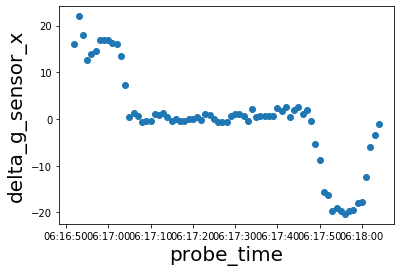

In [413]:
import numpy as np
np.set_printoptions(suppress=True)
test1()

       probe_sn  major  minor  rssi  g_sensor_x  g_sensor_y  g_sensor_z  \
30678    100009   2001      7   -82           1          89          -1   
30682    100009   2001      8   -81          -2          96          -2   
30683    100009   2001      7   -55          -1          89          -2   
30686    100009   2001      7   -75          -1          90          -1   
30688    100009   2001      9   -74          -1          90          -2   
30689    100009   2001      8   -59          -5          94           0   
30692    100009   2001      9   -70           0          89          -3   
30693    100009   2001      8   -75          -4          96           0   
30695    100009   2001      9   -59          -1          89          -3   
30696    100009   2001      8   -88          -5          94           0   
30697    100009   2001     10   -76          -4          87           2   
30698    100009   2001      7   -89          -1          90          -1   
30700    100009   2001   

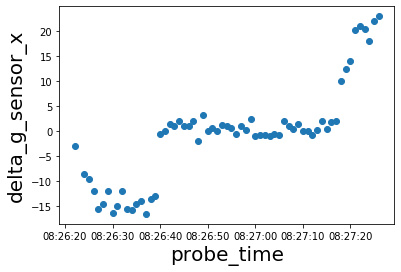

In [414]:
test1(8)

In [364]:
test1(12)

============deltaMinor=============
0     -8.000000
1     -9.000000
2    -11.666667
3    -14.500000
4    -13.166667
5    -14.000000
6    -16.833333
7    -17.500000
8    -16.000000
9    -16.333333
10   -14.666667
11   -15.333333
12   -17.666667
13   -15.000000
14   -15.500000
15   -14.500000
16    -9.000000
17    -1.000000
18     1.500000
19    -0.666667
20     0.000000
21     1.000000
22     1.000000
23     1.500000
24     0.666667
25     4.333333
26     0.833333
27     1.500000
28     1.500000
29     3.500000
30    -0.166667
31     0.000000
32     2.333333
33    -0.333333
34     0.333333
35    -0.666667
36     0.333333
37    -0.333333
38     0.333333
39     1.000000
40    -0.500000
41     0.166667
42     0.833333
43     1.000000
44    -0.333333
45    -0.500000
46    -0.333333
47     0.000000
48     1.000000
49     1.166667
50    -0.666667
51     0.000000
52     0.333333
53     0.333333
54    -0.666667
55     0.500000
56     1.000000
57     2.500000
58     2.333333
59     4.833333
60  

In [365]:
test1(9)

============deltaMinor=============
0     18.000000
1     16.000000
2     15.000000
3     17.000000
4     16.500000
5     16.000000
6     13.000000
7     10.500000
8      4.500000
9      1.500000
10     0.500000
11    -2.500000
12     0.500000
13     0.500000
14     0.000000
15    -1.000000
16    -0.500000
17     0.000000
18     0.833333
19     0.333333
20     0.500000
21     1.000000
22     1.500000
23     1.000000
24     2.000000
25     1.000000
26     0.000000
27     2.500000
28     1.500000
29     0.500000
30     0.500000
31     0.500000
32     1.000000
33    -0.500000
34     1.000000
35     0.000000
36     1.500000
37     2.000000
38     0.000000
39     2.000000
40     1.500000
41     0.500000
42     0.000000
43     1.000000
44    -1.500000
45     0.500000
46     0.500000
47    -4.000000
48    -9.000000
49   -13.000000
50   -19.500000
51   -22.000000
52   -22.000000
53   -22.500000
54   -22.000000
55   -20.000000
56   -18.000000
57   -13.000000
58   -13.000000
59   -12.000000
60  

In [367]:
test1(13)

============deltaMinor=============
0     18.000000
1     18.000000
2     18.000000
3     17.000000
4     16.000000
5     15.000000
6     15.500000
7     14.000000
8     12.666667
9      6.833333
10     1.833333
11     0.000000
12     1.500000
13     1.500000
14     1.000000
15     2.333333
16    -0.666667
17     0.000000
18     0.333333
19    -0.333333
20     0.833333
21     0.333333
22     1.500000
23     0.333333
24     0.000000
25     3.000000
26    -1.666667
27     0.666667
28     1.000000
29     1.500000
30     2.000000
31     0.500000
32     0.000000
33    -0.500000
34     0.000000
35     1.000000
36    -0.666667
37     0.000000
38     1.000000
39    -2.000000
40     0.000000
41     1.000000
42     2.000000
43     3.000000
44    -2.000000
45    -3.000000
46    -6.333333
47   -16.000000
48   -15.000000
49   -19.000000
50   -22.000000
51   -20.500000
52   -20.000000
53   -19.000000
54   -17.500000
55   -20.500000
56   -16.500000
57   -10.000000
58    -7.666667
59    -2.333333
60  

In [368]:
# 有问题有问题有问题有问题有问题有问题有问题有问题有问题
test1(6, 100022)

============deltaMinor=============
0     15.000000
1     18.000000
2     16.000000
3     15.000000
4     15.250000
5     14.200000
6     17.000000
7     15.600000
8     13.250000
9     13.000000
10    15.166667
11    19.000000
12    18.666667
13    17.250000
14    19.416667
15    17.250000
16    12.833333
17     7.000000
18     4.416667
19     3.333333
20     1.733333
21     0.833333
22     1.166667
23     1.666667
24     3.000000
25     2.333333
26     1.750000
27     2.666667
28     1.083333
29     2.333333
30     2.666667
31     1.833333
32     2.000000
33     1.500000
34     1.750000
35     1.666667
36     0.750000
37     1.416667
38     2.000000
39     1.500000
40     1.166667
41     0.833333
42     0.666667
43     6.000000
44     0.000000
45     0.750000
46     2.666667
47     2.333333
48     2.333333
49     2.000000
50     1.250000
51     1.750000
52     1.333333
53     2.333333
54     2.000000
55     2.000000
56     1.166667
57     1.666667
58     1.500000
59     2.333333
60  

In [369]:
test1(8, 100022)

============deltaMinor=============
0    -13.000000
1    -13.000000
2    -14.000000
3    -17.000000
4    -15.500000
5    -11.500000
6     -9.000000
7     -5.500000
8      0.000000
9      0.500000
10     0.000000
11     3.000000
12     4.000000
13     2.500000
14    -0.666667
15    -0.666667
16     2.666667
17     0.000000
18    -0.333333
19     2.000000
20     1.000000
21     1.000000
22     0.000000
23     0.333333
24     0.500000
25     1.500000
26     3.000000
27     1.500000
28     2.000000
29     4.000000
30     3.000000
31     2.000000
32     4.000000
33     3.000000
34    13.000000
35    13.000000
36    17.000000
37    18.500000
38    20.500000
39    19.000000
40    21.000000
41    19.000000
42          NaN
43          NaN
44          NaN
45          NaN
46          NaN
47          NaN
Name: g_sensor_x, dtype: float64
方向为反方向
1是进站状态
2是进站状态
3是进站状态
4是进站状态
5是进站状态
6是进站状态
7是进站状态
8是停止状态
9是停止状态
10是停止状态
11是停止状态
12是停止状态
13是停止状态
14是停止状态
15是停止状态
16是停止状态
17是停止状态
18是停止状态
19是停止状态
20是停止状态
21是停止

In [370]:
test1(9, 100022)

============deltaMinor=============
0     11.000000
1     12.000000
2     14.000000
3     14.000000
4     13.000000
5     21.000000
6     16.000000
7     18.000000
8     18.000000
9     15.000000
10    13.000000
11    14.000000
12    16.000000
13    13.500000
14     4.000000
15     0.000000
16     1.500000
17    -0.500000
18     0.000000
19    -1.500000
20     0.500000
21    -2.000000
22    -0.333333
23     1.333333
24     0.000000
25     1.666667
26     1.000000
27    -0.500000
28     1.000000
29     0.000000
30     0.666667
31     2.000000
32     0.000000
33     1.666667
34     2.000000
35    -2.000000
36     2.333333
37     3.000000
38     0.500000
39     2.000000
40     0.000000
41     1.000000
42     0.000000
43     0.000000
44    -2.000000
45    -5.000000
46    -8.000000
47   -10.500000
48   -13.000000
49   -20.500000
50   -17.000000
51          NaN
Name: g_sensor_x, dtype: float64
方向为正方向
1是进站状态
2是进站状态
3是进站状态
4是进站状态
5是进站状态
6是进站状态
7是进站状态
8是进站状态
9是进站状态
10是进站状态
11是进站状态
12是进站状态
13是进站

In [371]:
test1(12, 100022)

============deltaMinor=============
0    -13.000000
1    -13.000000
2    -14.000000
3    -14.000000
4    -15.500000
5    -13.500000
6    -15.500000
7     -9.000000
8     -4.500000
9      1.000000
10     2.000000
11     2.500000
12     3.166667
13     3.000000
14     0.333333
15     1.500000
16     2.833333
17     3.500000
18    -0.333333
19     1.166667
20    -1.000000
21    -1.000000
22     1.833333
23     3.500000
24     1.666667
25     1.500000
26     0.500000
27     1.666667
28     0.500000
29     1.500000
30     0.000000
31    -0.166667
32     1.000000
33    -1.000000
34     1.500000
35    -2.500000
36     1.500000
37    -1.000000
38    -0.500000
39    -1.000000
40     4.500000
41     3.500000
42    10.000000
43    12.000000
44    10.500000
45     7.000000
46    10.000000
47    11.500000
48    13.000000
49     9.000000
50    12.500000
51    12.000000
52    15.500000
53    14.000000
54    14.000000
55          NaN
56          NaN
57          NaN
58          NaN
59          NaN
60  

In [372]:
# ==================有问题====================================
test1(13, 100022)

============deltaMinor=============
0     10.000000
1      8.000000
2     14.500000
3     14.000000
4     13.000000
5     16.000000
6     16.000000
7     14.000000
8     17.000000
9     19.000000
10    12.500000
11    14.000000
12    15.000000
13    18.000000
14    14.166667
15     9.500000
16     6.000000
17     4.000000
18     1.000000
19     0.666667
20     1.000000
21     1.500000
22     0.833333
23     3.500000
24     2.500000
25    -0.500000
26     2.000000
27     2.500000
28     2.666667
29     2.666667
30     1.000000
31     1.666667
32     1.333333
33     2.500000
34     1.500000
35     2.000000
36     0.333333
37    -2.500000
38    -1.000000
39     1.000000
40     2.000000
41     0.000000
42    -1.000000
43    -1.500000
44     1.000000
45     0.500000
46     1.000000
47     0.000000
48    -1.000000
49    -4.500000
50    -5.000000
51    -8.000000
52   -12.000000
53   -15.000000
54   -14.000000
55   -20.000000
56   -19.000000
57          NaN
58          NaN
59          NaN
Name

In [374]:
test1(6, 100008)

============deltaMinor=============
0     18.000000
1     17.000000
2     15.000000
3     14.000000
4     17.000000
5     16.500000
6     15.500000
7     14.333333
8     15.166667
9     14.166667
10    10.833333
11     4.333333
12     1.000000
13     1.000000
14     2.250000
15    -0.666667
16     0.833333
17    -1.000000
18     2.666667
19    -1.333333
20     1.750000
21     1.000000
22     2.166667
23     2.666667
24     1.333333
25     0.333333
26    -1.000000
27     1.000000
28     2.500000
29    -0.333333
30     0.500000
31     1.000000
32     0.500000
33     1.000000
34     1.833333
35     0.000000
36     0.916667
37    -1.500000
38     2.500000
39    -1.000000
40     1.000000
41     1.333333
42     2.333333
43     2.833333
44     2.000000
45     2.666667
46     1.500000
47     1.000000
48    -0.333333
49    -0.500000
50     1.500000
51     0.666667
52     1.000000
53    -0.666667
54     0.500000
55     1.500000
56     1.000000
57    -1.000000
58     1.000000
59     1.000000
60  

In [375]:
test1(8, 100008)

============deltaMinor=============
0     -8.000000
1    -11.000000
2    -15.500000
3     -8.000000
4    -20.000000
5    -17.000000
6    -17.000000
7    -14.000000
8    -17.000000
9    -17.000000
10   -17.500000
11   -12.000000
12   -14.500000
13    -4.500000
14    -3.500000
15    -3.000000
16     1.000000
17    -0.500000
18    -1.000000
19     0.666667
20     0.500000
21     1.500000
22     0.000000
23     1.000000
24     0.166667
25     2.000000
26     0.000000
27     0.500000
28     0.000000
29     1.500000
30     0.000000
31     0.666667
32     7.000000
33     2.000000
34     1.000000
35     0.500000
36    -1.000000
37     1.000000
38     2.500000
39     1.000000
40     4.000000
41     2.000000
42     1.000000
43    -1.000000
44     0.000000
45     0.000000
46     3.000000
47     2.000000
48    -2.000000
49     1.000000
50     1.666667
51    -1.000000
52     7.500000
53    11.000000
54    15.000000
55    19.500000
56    21.500000
57    22.000000
58          NaN
59          NaN
60  

In [376]:
#====================================================
test1(9, 100008)

============deltaMinor=============
0     17.000000
1     16.000000
2     17.000000
3      7.000000
4     11.000000
5      6.000000
6      1.000000
7      3.000000
8     -1.500000
9     -0.500000
10     2.000000
11     0.500000
12     0.000000
13     2.000000
14     1.000000
15     1.500000
16     4.500000
17     0.166667
18     2.000000
19     0.500000
20    -1.666667
21     0.000000
22     1.000000
23     1.500000
24    -1.500000
25     2.000000
26    -1.500000
27     2.500000
28     1.000000
29     0.500000
30     0.000000
31     2.000000
32    -1.500000
33    -2.500000
34     2.000000
35     0.000000
36     2.000000
37     3.000000
38     2.000000
39    -0.500000
40     2.000000
41     3.000000
42     0.500000
43     3.000000
44     0.500000
45    -7.000000
46   -10.000000
47    -8.000000
48   -16.000000
49   -14.000000
50   -23.000000
51   -16.000000
52   -15.000000
53   -11.500000
54          NaN
55          NaN
56          NaN
57          NaN
58          NaN
Name: g_sensor_x, dt

In [377]:
test1(13, 100008)

============deltaMinor=============
0     19.000000
1     17.000000
2      7.000000
3      4.000000
4      3.000000
5      2.000000
6      2.000000
7     -1.000000
8      0.000000
9      1.000000
10     2.000000
11     1.500000
12     2.000000
13     3.000000
14     0.500000
15     2.000000
16    -2.000000
17     2.000000
18     3.500000
19    -1.000000
20     2.000000
21    -2.000000
22    -0.166667
23     2.000000
24    -1.000000
25     2.000000
26     1.000000
27     0.500000
28     2.000000
29     2.000000
30    -5.000000
31   -12.000000
32   -11.000000
33    -8.000000
34   -16.000000
35          NaN
36          NaN
37          NaN
38          NaN
39          NaN
40          NaN
41          NaN
42          NaN
Name: g_sensor_x, dtype: float64
方向为正方向
1是进站状态
2是停止状态
3是停止状态
4是停止状态
5是停止状态
6是停止状态
7是停止状态
8是停止状态
9是停止状态
10是停止状态
11是停止状态
12是停止状态
13是停止状态
14是停止状态
15是停止状态
16是停止状态
17是停止状态
18是停止状态
19是停止状态
20是停止状态
21是停止状态
22是停止状态
23是停止状态
24是停止状态
25是停止状态
26是停止状态
27是停止状态
28是停止状态
29是停止状态
30是出站状态


In [379]:
test1(6, 100014)

============deltaMinor=============
0     11.000000
1     13.000000
2     12.333333
3     14.333333
4     13.500000
5     16.000000
6     18.666667
7     15.750000
8     16.333333
9     15.333333
10    15.000000
11    14.500000
12    18.500000
13    14.500000
14    13.500000
15    15.000000
16     8.500000
17     5.000000
18     2.500000
19     1.000000
20     0.000000
21    -0.333333
22    -1.500000
23     0.000000
24     1.666667
25     1.666667
26     2.000000
27     1.000000
28     1.666667
29     1.666667
30     1.666667
31     2.000000
32     1.666667
33     2.166667
34     0.833333
35     2.166667
36     1.500000
37     1.166667
38     1.833333
39     0.250000
40     2.666667
41     1.666667
42     0.833333
43     1.666667
44     3.000000
45     1.166667
46     0.000000
47     1.000000
48     1.000000
49     2.500000
50     0.500000
51     0.000000
52     0.500000
53     1.000000
54     2.500000
55     2.000000
56    -0.166667
57     0.000000
58     0.000000
59     1.666667
60  

In [381]:
test1(8, 100014)

============deltaMinor=============
0    -14.000000
1    -15.000000
2    -14.000000
3    -10.000000
4    -12.000000
5     -6.000000
6     -4.500000
7     -2.500000
8      2.500000
9     -0.500000
10     3.500000
11     1.000000
12     1.000000
13     3.333333
14     2.333333
15     2.333333
16     2.333333
17     1.500000
18     1.000000
19     3.666667
20     1.166667
21     2.666667
22     1.500000
23     4.500000
24     2.000000
25     2.000000
26     3.333333
27     4.500000
28     1.666667
29     2.333333
30     2.500000
31     0.500000
32     2.000000
33     1.000000
34     1.500000
35     1.500000
36     2.000000
37     2.000000
38     3.000000
39     1.500000
40     1.000000
41    -1.000000
42    -1.000000
43     6.500000
44     7.500000
45    10.500000
46    14.000000
47    15.000000
48    20.000000
49    20.500000
50    23.333333
51    21.500000
52    19.000000
53    20.000000
54    20.000000
55    11.000000
56          NaN
57          NaN
Name: g_sensor_x, dtype: float64
方向为

In [382]:
test1(9, 100014)

============deltaMinor=============
0     11.000000
1     12.000000
2     13.000000
3     14.500000
4     15.000000
5     13.000000
6     16.500000
7     22.000000
8     17.000000
9     17.000000
10    14.000000
11    14.000000
12    12.000000
13    15.500000
14    13.000000
15     9.000000
16    11.000000
17     6.000000
18     0.500000
19    -0.500000
20     0.000000
21     0.500000
22     1.500000
23    -2.000000
24     2.000000
25     1.500000
26     1.000000
27     2.500000
28     1.500000
29     2.666667
30     1.000000
31     2.500000
32     1.000000
33     1.000000
34     2.000000
35     1.000000
36     1.000000
37     0.000000
38     0.000000
39     1.000000
40     0.000000
41     2.000000
42     1.000000
43     1.500000
44    -2.000000
45     0.500000
46     1.500000
47     0.000000
48     2.666667
49     1.000000
50     1.500000
51    -2.500000
52    -4.000000
53    -9.000000
54   -13.000000
55   -14.000000
56   -16.000000
57          NaN
58          NaN
59          NaN
Name

In [383]:
test1(13, 100014)

============deltaMinor=============
0     11.0
1     14.0
2     12.0
3     12.0
4     13.0
5     18.0
6     16.0
7     17.0
8     17.0
9     14.0
10    13.0
11    14.0
12    14.0
13    10.5
14     5.0
15     0.0
16     1.0
17     1.0
18     1.0
19     1.0
20     1.0
21     2.0
22     1.0
23     1.5
24    -0.5
25    -1.5
26     0.5
27     3.5
28     2.0
29     2.0
30     2.0
31     0.5
32     0.5
33     2.0
34    -1.5
35     2.0
36     2.0
37     2.0
38     2.0
39     2.0
40     2.0
41     0.0
42     2.0
43     0.0
44     3.0
45     1.5
46     0.0
47    -3.0
48     0.0
49     0.5
50     1.5
51    -0.5
52     2.5
53     2.0
54     1.5
55     0.5
56     1.0
57    -7.5
58   -12.5
59   -16.0
60   -17.5
61   -19.0
62   -19.0
63     NaN
64     NaN
Name: g_sensor_x, dtype: float64
方向为正方向
1是进站状态
2是进站状态
3是进站状态
4是进站状态
5是进站状态
6是进站状态
7是进站状态
8是进站状态
9是进站状态
10是进站状态
11是进站状态
12是进站状态
13是进站状态
14是停止状态
15是停止状态
16是停止状态
17是停止状态
18是停止状态
19是停止状态
20是停止状态
21是停止状态
22是停止状态
23是停止状态
24是停止状态
25是停止状态
26是停止状态
27是停止状态
28

In [384]:
test1(6, 100011)

============deltaMinor=============
0     18.000000
1     18.000000
2     16.500000
3     16.000000
4     18.000000
5     15.500000
6     12.166667
7     10.500000
8      9.000000
9      8.000000
10     3.166667
11     1.166667
12     1.666667
13     0.500000
14    -0.166667
15     0.500000
16     0.000000
17    -0.166667
18    -0.500000
19     0.166667
20     0.666667
21    -0.166667
22    -1.000000
23     0.500000
24    -0.666667
25     0.166667
26     0.666667
27    -0.833333
28     0.000000
29    -0.500000
30    -0.500000
31    -0.500000
32    -1.000000
33     0.000000
34    -1.000000
35    -0.333333
36    -1.333333
37     0.500000
38    -0.166667
39    -1.666667
40     0.500000
41    -1.166667
42     1.000000
43     2.000000
44     0.500000
45     1.000000
46    -0.333333
47     0.166667
48     0.000000
49     0.500000
50     0.250000
51    -1.333333
52    -6.333333
53    -7.333333
54   -10.500000
55   -11.333333
56   -14.666667
57   -16.000000
58   -19.333333
59   -19.000000
60  

In [386]:
test1(8, 100011)

============deltaMinor=============
0     -8.000000
1    -13.000000
2    -15.500000
3    -12.000000
4    -10.500000
5    -12.000000
6    -20.000000
7    -16.000000
8    -19.000000
9    -15.000000
10   -16.000000
11   -17.000000
12   -14.666667
13   -15.500000
14   -12.000000
15   -11.500000
16    -5.666667
17     0.000000
18    -2.000000
19    -0.500000
20    -1.000000
21    -0.666667
22     0.500000
23     0.000000
24     0.500000
25    -1.000000
26     0.000000
27    -2.500000
28    -0.833333
29    -3.000000
30     1.500000
31     0.500000
32     0.000000
33    -0.500000
34    -1.000000
35    -1.500000
36    -0.500000
37     1.000000
38    -0.500000
39     0.000000
40     0.333333
41    -0.500000
42    -1.333333
43     1.000000
44     0.000000
45     0.000000
46     1.000000
47     0.500000
48     1.000000
49     0.500000
50    -1.500000
51    -2.000000
52     0.000000
53     0.000000
54     6.000000
55     8.000000
56    16.000000
57    15.500000
58    19.000000
59    21.500000
60  

In [275]:
test1(9, 100011)

============deltaMinor=============
probe_sn  probe_time         
100011    2020-09-26 09:32:33     NaN
          2020-09-26 09:32:34    17.5
          2020-09-26 09:32:35     NaN
          2020-09-26 09:32:36    16.0
          2020-09-26 09:32:37     NaN
          2020-09-26 09:32:38    16.0
          2020-09-26 09:32:39     NaN
          2020-09-26 09:32:40    -1.0
          2020-09-26 09:32:41     0.5
          2020-09-26 09:32:42     0.5
          2020-09-26 09:32:43     NaN
          2020-09-26 09:32:44     3.0
          2020-09-26 09:32:45     1.0
          2020-09-26 09:32:46     NaN
          2020-09-26 09:32:47    -1.0
          2020-09-26 09:32:48     0.0
          2020-09-26 09:32:49     0.5
          2020-09-26 09:32:50     0.0
          2020-09-26 09:32:51     0.0
          2020-09-26 09:32:52     2.0
          2020-09-26 09:32:53     0.0
          2020-09-26 09:32:54     4.0
          2020-09-26 09:32:55     NaN
          2020-09-26 09:32:56     0.0
          2020-09-26 0

In [276]:
test1(12, 100011)

============deltaMinor=============
probe_sn  probe_time         
100011    2020-09-26 12:03:43          NaN
          2020-09-26 12:03:44          NaN
          2020-09-26 12:03:45   -10.000000
          2020-09-26 12:03:46   -12.666667
          2020-09-26 12:03:47   -14.000000
          2020-09-26 12:03:48    -9.500000
          2020-09-26 12:03:49   -13.833333
          2020-09-26 12:03:50   -15.000000
          2020-09-26 12:03:51   -11.500000
          2020-09-26 12:03:52   -17.500000
          2020-09-26 12:03:53   -17.000000
          2020-09-26 12:03:54   -15.000000
          2020-09-26 12:03:55   -16.000000
          2020-09-26 12:03:56   -14.500000
          2020-09-26 12:03:57   -15.000000
          2020-09-26 12:03:58   -15.000000
          2020-09-26 12:03:59   -15.000000
          2020-09-26 12:04:00   -10.000000
          2020-09-26 12:04:01    -3.000000
          2020-09-26 12:04:02     0.000000
          2020-09-26 12:04:03    -1.000000
          2020-09-26 12:04:04  

In [277]:
test1(13, 100011)

============deltaMinor=============
probe_sn  probe_time         
100011    2020-09-26 13:12:26          NaN
          2020-09-26 13:12:28    17.000000
          2020-09-26 13:12:29    17.000000
          2020-09-26 13:12:30    15.000000
          2020-09-26 13:12:31          NaN
          2020-09-26 13:12:32    15.500000
          2020-09-26 13:12:33    16.000000
          2020-09-26 13:12:34     5.000000
          2020-09-26 13:12:35          NaN
          2020-09-26 13:12:36     1.000000
          2020-09-26 13:12:37     1.500000
          2020-09-26 13:12:38    -4.000000
          2020-09-26 13:12:39    -0.666667
          2020-09-26 13:12:40     0.333333
          2020-09-26 13:12:41    -0.166667
          2020-09-26 13:12:42     0.333333
          2020-09-26 13:12:43     1.000000
          2020-09-26 13:12:44    -0.666667
          2020-09-26 13:12:45    -1.500000
          2020-09-26 13:12:46     0.750000
          2020-09-26 13:12:47     0.000000
          2020-09-26 13:12:48  

In [279]:
test1(6, 100012)

============deltaMinor=============
probe_sn  probe_time         
100012    2020-09-26 06:19:30     9.000000
          2020-09-26 06:19:31     7.833333
          2020-09-26 06:19:32    12.500000
          2020-09-26 06:19:33    12.333333
          2020-09-26 06:19:34    13.666667
          2020-09-26 06:19:35    14.000000
          2020-09-26 06:19:36    16.150000
          2020-09-26 06:19:37    13.833333
          2020-09-26 06:19:38    15.500000
          2020-09-26 06:19:39    17.500000
          2020-09-26 06:19:40    16.250000
          2020-09-26 06:19:41    16.000000
          2020-09-26 06:19:42    17.333333
          2020-09-26 06:19:43    14.750000
          2020-09-26 06:19:44    17.333333
          2020-09-26 06:19:45    15.833333
          2020-09-26 06:19:46    16.000000
          2020-09-26 06:19:47     7.916667
          2020-09-26 06:19:48     3.750000
          2020-09-26 06:19:49     1.250000
          2020-09-26 06:19:50     1.833333
          2020-09-26 06:19:51  

In [280]:
test1(8, 100012)

============deltaMinor=============
probe_sn  probe_time         
100012    2020-09-26 08:23:51   -15.000000
          2020-09-26 08:23:53   -13.000000
          2020-09-26 08:23:54   -14.000000
          2020-09-26 08:23:55   -14.000000
          2020-09-26 08:23:56   -14.000000
          2020-09-26 08:23:57   -14.000000
          2020-09-26 08:23:58   -14.000000
          2020-09-26 08:23:59   -17.500000
          2020-09-26 08:24:00   -15.500000
          2020-09-26 08:24:01   -17.000000
          2020-09-26 08:24:02    -8.333333
          2020-09-26 08:24:03    -2.333333
          2020-09-26 08:24:04     0.000000
          2020-09-26 08:24:05     1.000000
          2020-09-26 08:24:06     1.500000
          2020-09-26 08:24:07     1.000000
          2020-09-26 08:24:08    -2.000000
          2020-09-26 08:24:09    -0.500000
          2020-09-26 08:24:10    -0.500000
          2020-09-26 08:24:11     0.500000
          2020-09-26 08:24:12     2.166667
          2020-09-26 08:24:13  

In [281]:
test1(9, 100012)

============deltaMinor=============
probe_sn  probe_time         
100012    2020-09-26 09:32:23     NaN
          2020-09-26 09:32:24     9.5
          2020-09-26 09:32:25    13.5
          2020-09-26 09:32:26    12.5
          2020-09-26 09:32:27    11.0
          2020-09-26 09:32:28    16.5
          2020-09-26 09:32:29    12.5
          2020-09-26 09:32:30    19.5
          2020-09-26 09:32:31     NaN
          2020-09-26 09:32:32     NaN
          2020-09-26 09:32:33     NaN
          2020-09-26 09:32:34    15.5
          2020-09-26 09:32:35     NaN
          2020-09-26 09:32:36    13.0
          2020-09-26 09:32:37     NaN
          2020-09-26 09:32:38     NaN
          2020-09-26 09:32:39    13.0
          2020-09-26 09:32:40     NaN
          2020-09-26 09:32:41    -3.0
          2020-09-26 09:32:42     NaN
          2020-09-26 09:32:43     1.0
          2020-09-26 09:32:44     NaN
          2020-09-26 09:32:45    -1.5
          2020-09-26 09:32:46    -2.0
          2020-09-26 0

In [390]:
test1(12, 100012)

============deltaMinor=============
0    -14.000000
1    -16.500000
2    -16.000000
3    -14.500000
4    -18.500000
5    -15.500000
6    -17.000000
7    -13.500000
8    -10.500000
9     -4.500000
10     0.000000
11     0.500000
12     3.333333
13     0.500000
14     2.000000
15     2.000000
16     0.666667
17     2.666667
18     1.000000
19    -1.000000
20     0.333333
21     0.000000
22     0.000000
23     0.666667
24     1.333333
25     0.333333
26     1.000000
27     0.333333
28    -0.500000
29     0.000000
30     0.666667
31     1.333333
32    -0.166667
33    -2.000000
34     1.000000
35    -3.000000
36    -3.000000
37     1.000000
38    -2.000000
39     1.500000
40     0.000000
41     1.500000
42    -1.000000
43    -1.500000
44     1.333333
45    -2.000000
46    -1.000000
47     1.500000
48     2.500000
49     0.166667
50     0.000000
51     2.000000
52     5.833333
53     4.500000
54    11.000000
55    16.333333
56    15.000000
57    20.500000
58    20.250000
59    20.833333
60  

In [389]:
test1(13, 100012)

============deltaMinor=============
0     10.000000
1     13.000000
2     13.000000
3     14.500000
4     12.000000
5     16.000000
6     19.000000
7     17.000000
8     16.333333
9     13.000000
10    14.500000
11    13.000000
12    13.500000
13    10.500000
14     6.000000
15     0.000000
16     0.500000
17     0.000000
18    -1.000000
19    -1.000000
20    -0.500000
21     0.500000
22     1.000000
23    -2.000000
24     0.000000
25    -0.500000
26     0.500000
27     0.666667
28     0.000000
29    -0.500000
30    -1.500000
31     0.166667
32    -1.666667
33     1.000000
34    -0.166667
35    -0.666667
36    -2.500000
37    -0.333333
38    -2.000000
39    -2.000000
40     2.000000
41     0.500000
42    -3.000000
43     1.500000
44    -1.500000
45    -0.500000
46     1.000000
47     0.000000
48     0.000000
49     0.500000
50    -0.500000
51     2.000000
52     0.000000
53     1.000000
54    -1.500000
55     0.500000
56    -0.500000
57    -2.000000
58    -1.500000
59     0.500000
60  

In [388]:
test1(6, 100016)

============deltaMinor=============
0     12.000000
1     13.500000
2     12.166667
3     11.666667
4     14.500000
5     16.333333
6     17.500000
7     17.666667
8     17.166667
9     17.000000
10    18.666667
11    16.666667
12    16.666667
13    18.000000
14    16.000000
15    14.000000
16    10.500000
17     6.000000
18     3.000000
19     1.333333
20    -1.000000
21     1.000000
22     1.833333
23     0.500000
24     0.500000
25     1.500000
26     2.000000
27    -0.500000
28    -1.500000
29     1.333333
30     1.333333
31     2.500000
32     1.333333
33     2.000000
34     1.000000
35     0.000000
36     0.000000
37     1.500000
38     1.000000
39     0.666667
40    -0.500000
41     1.500000
42    -0.500000
43     2.666667
44     0.500000
45     1.166667
46    -0.500000
47    -1.500000
48     0.333333
49     1.000000
50    -0.500000
51     0.000000
52     1.000000
53     1.000000
54     3.000000
55     1.500000
56     1.500000
57     1.666667
58     0.666667
59     0.000000
60  

In [387]:
test1(8, 100016)

============deltaMinor=============
0    -13.0
1    -13.0
2    -13.0
3    -14.0
4    -12.5
5     -6.0
6     -3.5
7     -1.5
8      1.0
9      3.0
10     3.0
11    -1.5
12     2.0
13    -1.0
14     0.0
15     0.5
16     0.5
17     2.0
18     1.5
19     1.5
20     0.0
21     0.5
22     2.0
23    -0.5
24    -0.5
25     0.0
26    -0.5
27    -0.5
28     1.0
29     2.0
30    -2.0
31     1.5
32     0.5
33     0.0
34     1.0
35     1.0
36    -3.0
37    -2.5
38     0.5
39     2.0
40     0.0
41    -3.0
42    10.0
43     9.0
44    10.0
45    11.0
46    11.0
47    14.5
48    16.0
49    12.0
50    11.5
51    12.0
52    12.0
53     NaN
54     NaN
55     NaN
56     NaN
Name: g_sensor_x, dtype: float64
方向为反方向
1是进站状态
2是进站状态
3是进站状态
4是进站状态
5是进站状态
6是停止状态
7是停止状态
8是停止状态
9是停止状态
10是停止状态
11是停止状态
12是停止状态
13是停止状态
14是停止状态
15是停止状态
16是停止状态
17是停止状态
18是停止状态
19是停止状态
20是停止状态
21是停止状态
22是停止状态
23是停止状态
24是停止状态
25是停止状态
26是停止状态
27是停止状态
28是停止状态
29是停止状态
30是停止状态
31是停止状态
32是停止状态
33是停止状态
34是停止状态
35是停止状态
36是停止状态
37是停止状态
38是停止状态
39

In [288]:
test1(9, 100016)

============deltaMinor=============
probe_sn  probe_time         
100016    2020-09-26 09:49:52     NaN
          2020-09-26 09:49:53    12.0
          2020-09-26 09:49:54     NaN
          2020-09-26 09:49:55    14.0
          2020-09-26 09:49:56     NaN
          2020-09-26 09:49:57     NaN
          2020-09-26 09:49:58    17.0
          2020-09-26 09:49:59     NaN
          2020-09-26 09:50:00    18.0
          2020-09-26 09:50:01     NaN
          2020-09-26 09:50:02     NaN
          2020-09-26 09:50:03    16.5
          2020-09-26 09:50:04    15.0
          2020-09-26 09:50:05    15.5
          2020-09-26 09:50:06    13.5
          2020-09-26 09:50:07    15.5
          2020-09-26 09:50:08    14.5
          2020-09-26 09:50:09     9.0
          2020-09-26 09:50:10     2.0
          2020-09-26 09:50:11    -1.0
          2020-09-26 09:50:12     0.0
          2020-09-26 09:50:13     1.0
          2020-09-26 09:50:14    -0.5
          2020-09-26 09:50:15    -0.5
          2020-09-26 0

In [290]:
test1(13, 100016)

============deltaMinor=============
probe_sn  probe_time         
100016    2020-09-26 13:29:48          NaN
          2020-09-26 13:29:49          NaN
          2020-09-26 13:29:50          NaN
          2020-09-26 13:29:52          NaN
          2020-09-26 13:29:53          NaN
          2020-09-26 13:29:54    15.000000
          2020-09-26 13:29:55    21.000000
          2020-09-26 13:29:56          NaN
          2020-09-26 13:29:57    18.000000
          2020-09-26 13:29:58          NaN
          2020-09-26 13:29:59    11.000000
          2020-09-26 13:30:00    13.500000
          2020-09-26 13:30:01    14.500000
          2020-09-26 13:30:02    13.000000
          2020-09-26 13:30:03          NaN
          2020-09-26 13:30:04    10.500000
          2020-09-26 13:30:05     0.000000
          2020-09-26 13:30:06     1.000000
          2020-09-26 13:30:07          NaN
          2020-09-26 13:30:08     1.000000
          2020-09-26 13:30:10     2.000000
          2020-09-26 13:30:11  

In [ ]:
def test2(hour=6, probe_sn=100009):
    np.set_printoptions(suppress=True)
    minorLarge = data1[(data1['probe_sn'] == probe_sn) & (data1['']) & (data1['minor'] >= 7)]
    minorSmall = data1[(data1['probe_sn'] == probe_sn) & (data1['probe_time'].dt.hour == hour) &
                  (data1['probe_time'].dt.day == 26) & (data1['minor'] < 7)]
    distinctMinor1 = minorLarge['g_sensor_x'].groupby([minorLarge['probe_sn'], minorLarge['probe_time']]).mean().reset_index()
#     print(distinctMinor1)
    distinctMinor2 = minorSmall['g_sensor_x'].groupby([minorSmall['probe_sn'], minorSmall['probe_time']]).mean().reset_index()
#     print(distinctMinor2)
    deltaMinor = distinctMinor1['g_sensor_x'] - distinctMinor2['g_sensor_x']
    print("============deltaMinor=============")
    print(deltaMinor)
    
#     deltaMinor1 = deltaMinor.shift(1)
#     deltaResult = deltaMinor - deltaMinor1
#     print(deltaResult)
    flag = 0
    if deltaMinor[0] >= 0:
        print('方向为正方向')
        for i in range(1, len(deltaMinor)):
            if flag == 0:
                if deltaMinor[i] >= 10:
                    print(str(i)+'是进站状态')
                if deltaMinor[i] < 10.0 and deltaMinor[i] > -5:
                    print(str(i)+'是停止状态')
                if deltaMinor[i] <= -5:
                    print(str(i)+'是出站状态')
                    flag = 1
    else:
        print('方向为反方向')
        for i in range(1, len(deltaMinor)):
            if flag == 0:
                if deltaMinor[i] <= -5:
                    print(str(i)+'是进站状态')
                if deltaMinor[i] < 10.0 and deltaMinor[i] > -5:
                    print(str(i)+'是停止状态')
                if deltaMinor[i] >= 10:
                    print(str(i)+'是出站状态')
                    flag = 1